In [1]:
import fitsio
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline

In [2]:
# set some plotting defaults
mpl.rc(('lines', 'axes') , linewidth=2)
mpl.rc(('xtick', 'ytick'), labelsize=15)
mpl.rc(('xtick.major', 'ytick.major'), width=2)
mpl.rcParams['axes.labelsize'] = 18
mpl.rcParams['font.family'] = 'serif'
# mpl.rcParams['font.serif'] = ['Times New Roman'] + mpl.rcParams['font.serif']
# mpl.rcParams["font.family"] = "Times New Roman" 
mpl.rcParams['mathtext.fontset'] = 'stix'
# mpl.rcParams['font.family'] = 'serif'
mpl.rcParams['legend.fontsize'] = 15
mpl.rcParams['font.size'] = 18
mpl.rcParams["figure.facecolor"] = 'white'
mpl.rcParams["axes.facecolor"] = 'white'
mpl.rcParams["savefig.facecolor"] = 'white'

## Y6A2 PIFF V3 FULL WIDE FIELD SURVEY

In [3]:
fcat = fitsio.FITS('/global/cscratch1/sd/schutt20/y6a2_piff_testing/catalogs/y6a2_piff_v3_allres_v3_collated.fits')
fcat[1].upper = True
# # cat = cat[1][:]
# cat = cat[1]['EXPNUM', 'CCDNUM', 'RA', 'DEC', 'PSF_FWHM', 'BAND', 'NSTAR', 'SNR', 'FLUX',
#              'T_DATA', 'T_MODEL', 'G1_DATA', 'G1_MODEL', 'G2_DATA', 'G2_MODEL',
#              'GI_COLOR', 'IZ_COLOR', 'G_MAG', 'R_MAG', 'I_MAG', 'Z_MAG', 'K_MAG', 'GAIA_STAR','VHS_OBJ'][:]

In [4]:
fcat[1]


  file: /global/cscratch1/sd/schutt20/y6a2_piff_testing/catalogs/y6a2_piff_v3_allres_v3_collated.fits
  extension: 1
  type: BINARY_TBL
  rows: 138045977
  column info:
    EXPNUM              i8  
    CCDNUM              i2  
    BAND                S4  
    MJD_OBS             f8  
    TELRA              S60  
    TELDEC             S60  
    NSTAR               i4  
    NREMOVED            i4  
    EXP_STAR_T_MEAN     f8  
    EXP_STAR_T_STD      f8  
    STAR_T_MEAN         f8  
    STAR_T_STD          f8  
    FWHM_CEN            f8  
    PSF_FWHM            f8  
    FLAG                i4  
    COADD_OBJECT_ID     i8  
    RA                  f8  
    DEC                 f8  
    U                   f8  
    V                   f8  
    X                   f8  
    Y                   f8  
    SNR                 f8  
    FLUX                f8  
    BDF_T               f8  
    T_DATA              f8  
    T_MODEL             f8  
    G1_DATA             f8  
    G1_MODEL      

In [5]:
rng = np.random.default_rng(1234)
nentries = 138045977
nstar = int(5e6)
idx_sample = rng.integers(low=0, high=nentries, size=nstar) #high is exclusive

In [6]:
cat = fcat[1]['EXPNUM', 'CCDNUM', 'RA', 'DEC', 'PSF_FWHM', 'STAR_T_MEAN', 'BAND', 'NSTAR', 'SNR', 'FLUX',
             'T_DATA', 'T_MODEL', 'G1_DATA', 'G1_MODEL', 'G2_DATA', 'G2_MODEL',
             'GI_COLOR', 'IZ_COLOR', 'R_MAG', 'Z_MAG', 'K_MAG', 'GAIA_STAR','VHS_OBJ'][idx_sample]

In [7]:
print(len(cat))
cat[0:5]

4910411


array([(807019, 53, 'g', 189, 0.86097524, 1.35699999, 61.83342286, -66.05336801,  23.02760315,  5942.06445312, 0.82409769, 0.86624385,  0.00345548, -0.04075758, -0.01810212,  0.02726981, 0.4071686 , -0.01011113, 21.77046585, 21.70171928, -99.90000153, 0, 0),
       (804795, 44, 'z', 172, 0.31962594, 0.84200001, 22.65717988, -65.72592019, 100.        , 86922.        , 0.31489969, 0.31104962, -0.01985208, -0.02164908, -0.03000162, -0.02748596, 2.26641679,  0.38700619, 20.36921692, 19.07152176,  18.99333572, 1, 1),
       (603708,  6, 'i', 111, 0.36349524, 0.90200001, 49.60766415, -11.40708756, 100.        , 78704.4296875 , 0.36575304, 0.36573393, -0.00966877, -0.00705172, -0.01956746, -0.03002023, 2.22316217,  0.34560901, 20.15047455, 19.05475426,  18.8063755 , 1, 1),
       (603708,  6, 'i', 111, 0.36349524, 0.90200001, 49.6231038 , -11.42092182,  63.97786331, 23675.55859375, 0.35110164, 0.36624588, -0.00242175, -0.00857551, -0.01588237, -0.03067428, 2.33136272,  0.36357895, 21.55719185

In [9]:
bands = 'griz'

### Plotting and other useful functions

In [27]:
def make_profile(bin_data, shape_data, xmin=0., xmax=3.5, nbins=30):
    x_bins = np.linspace(xmin, xmax, nbins)
    # print('col_bins = ',x_bins)

    index = np.digitize(bin_data, x_bins)
    bin_shape = np.asarray([shape_data[index == i].mean() for i in range(1, len(x_bins))])
    # print('bin_shape = ',bin_shape)
    bin_shape_err = np.asarray([ np.sqrt(shape_data[index == i].var() / len(shape_data[index == i]))
                    for i in range(1, len(x_bins)) ])
    # print('bin_shape_err = ',bin_shape_err)

    # Fix up nans
    for i in range(1,len(x_bins)):
        if i not in index:
            bin_shape[i-1] = 0.
            bin_shape_err[i-1] = 0.
    
    return x_bins, bin_shape, bin_shape_err

In [11]:
def plot_profile(x_bins, bin_shape, bin_shape_err, ax, ymin=0., ymax=1., plt_zero_line=False,
                 min_xused=None, xlabel=None, ylabel=None, proflabel=None, profcolor=None):
    ax.set_ylim(ymin, ymax)
    if plt_zero_line:
        ax.axhline(0, color='black')
    if min_xused != None:
        ax.plot([min_xused,min_xused],[-1,1], color='Grey')
        ax.fill( [ymin,ymin,min_xused,min_xused], [-1,1,1,-1], fill=True, color='Grey',alpha=0.3)
    if profcolor is not None:
        profile = ax.errorbar(x_bins[:-1], bin_shape, yerr=bin_shape_err, fmt='o',
                              label=proflabel, color=profcolor)
    else:
        profile = ax.errorbar(x_bins[:-1], bin_shape, yerr=bin_shape_err, fmt='o',
                              label=proflabel)
        
    #ax.axhline(y=0.003, linewidth=4, color='grey')
    #ax.legend([t_line], [r'$\delta T$'])
    if proflabel is not None:
        ax.legend()
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    plt.tight_layout()

In [13]:
def compute_res(d):
    
    de1 =  d['G1_DATA']-d['G1_MODEL']
    de2 =  d['G2_DATA']-d['G2_MODEL']
    dt =  d['T_DATA']-d['T_MODEL']
    dtfrac = dt/d['T_MODEL']
    print('mean de = ',np.mean(de1),np.mean(de2))
    print('mean dt = ',np.mean(dt))

    return dtfrac, dt, de1, de2

### General catalog statistics

In [8]:
bands = 'grizY'
for band in bands:
    print('{}-band star count: {}'.format(band, len(cat[cat['BAND'] == band])))

g-band star count: 921419
r-band star count: 1130428
i-band star count: 1188171
z-band star count: 1062461
Y-band star count: 607932


In [9]:
goodcat = cat[cat['PSF_FWHM'] < 1.5]

In [10]:
for band in bands:
    print('{}-band star count: {}'.format(band, len(goodcat[goodcat['BAND'] == band])))

g-band star count: 838618
r-band star count: 1104990
i-band star count: 1183500
z-band star count: 1053725
Y-band star count: 577462


In [8]:
bands = 'griz'

In [12]:
print('Number of exposures: {}'.format(len(np.unique(cat['EXPNUM']))))

Number of exposures: 84227


In [13]:
for band in bands:
    data = cat[cat['BAND'] == band]
    print('Number of exposures in {} band: {}'.format(band, len(np.unique(data['EXPNUM']))))

Number of exposures in g band: 17936
Number of exposures in r band: 17956
Number of exposures in i band: 17646
Number of exposures in z band: 17365


In [14]:
u_exp_ccd, nstars = np.unique(np.stack((cat['EXPNUM'], cat['CCDNUM']), axis=1), axis=0, return_counts=True)

In [15]:
print('Number of unique exposure, CCD pairs: {}'.format(len(u_exp_ccd)))

Number of unique exposure, CCD pairs: 2837237


In [16]:
print(u_exp_ccd); print(nstars)

[[226650      1]
 [226650      2]
 [226650      3]
 ...
 [810354     58]
 [810354     60]
 [810354     62]]
[4 6 3 ... 2 1 2]


In [22]:
print(min(nstars), max(nstars))
print(min(cat['NSTAR']), max(cat['NSTAR']))

1 23
30 2320


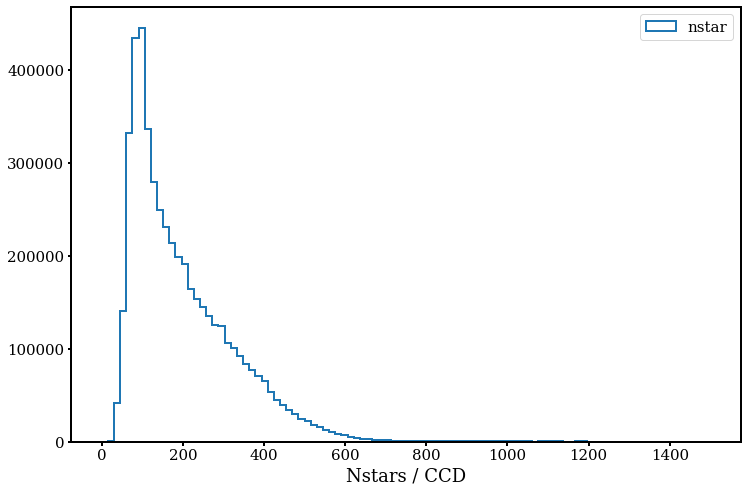

In [28]:
fig = plt.figure(figsize=(12, 8))
plt.hist(cat['NSTAR'], bins=np.linspace(0,1500,100), histtype='step', label='nstar', lw=2)
plt.xlabel('Nstars / CCD')
plt.legend()

Text(0.5, 0, 'SNR')

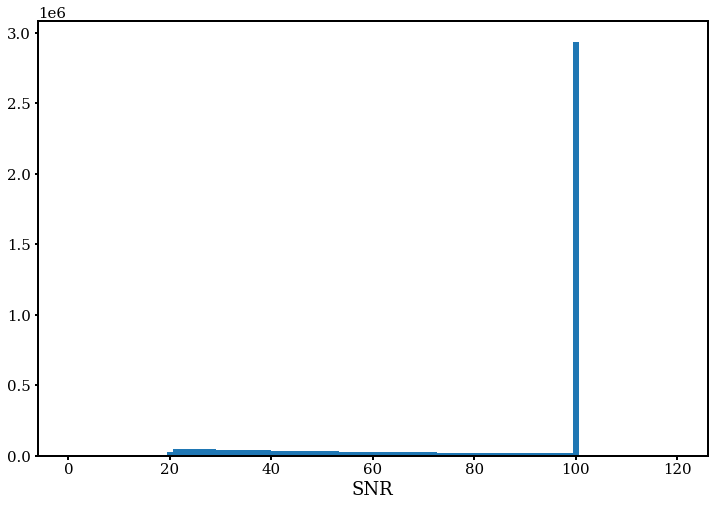

In [29]:
# histogram of SNR
fig = plt.figure(figsize=(12, 8))
plt.hist(cat['SNR'], bins=np.linspace(0,120,100))
plt.xlabel('SNR')

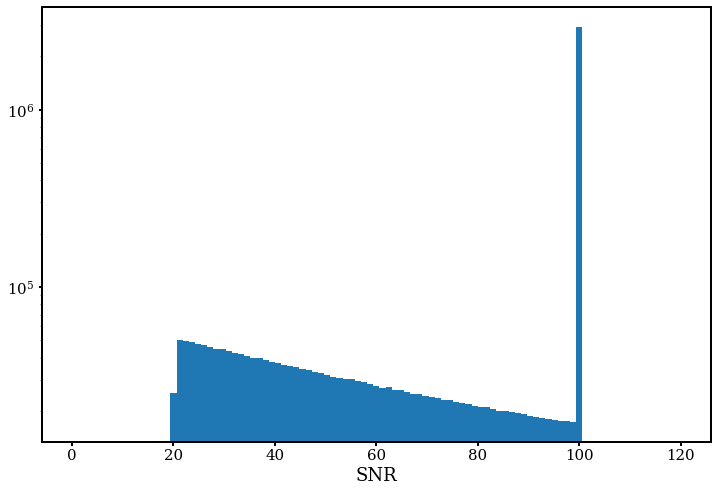

In [35]:
# histogram of SNR
fig = plt.figure(figsize=(12, 8))
plt.hist(cat['SNR'], bins=np.linspace(0,120,100))
plt.xlabel('SNR')
plt.yscale('log')

In [34]:
maxsnr = np.count_nonzero(cat['SNR'] == 100)
tot = len(cat)
print(maxsnr, tot, maxsnr/tot)

2930553 4910411 0.5968040149796014


/tmp/ipykernel_3576/2945130806.py:11: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
/tmp/ipykernel_3576/2945130806.py:24: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
/tmp/ipykernel_3576/2945130806.py:38: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)


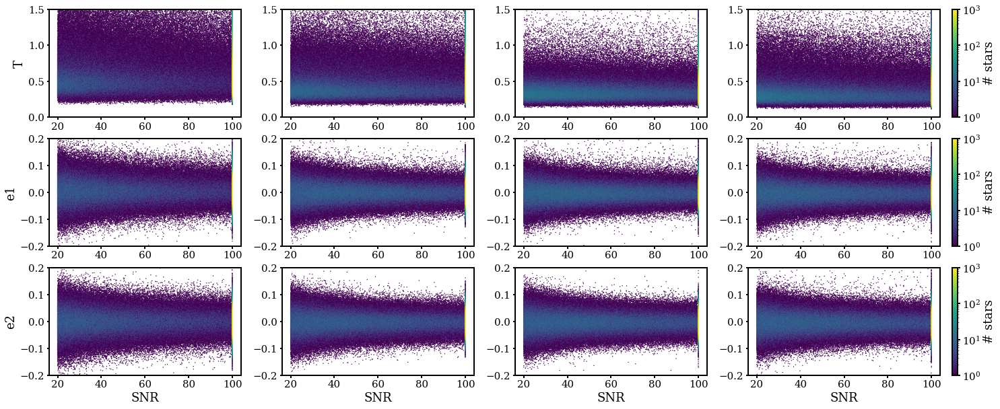

In [30]:
fig, axs = plt.subplots(3,4, figsize=(25,10), gridspec_kw={'width_ratios': [1,1,1,1.25]})
# shape residuals vs. SNR
for i, band in enumerate(bands):
    ccat = cat[cat['BAND'] == band]
    
    ax = axs[0,i]
    tmax = 1.5
    mask = ccat['T_DATA'] < tmax
    snr = ccat['SNR'][mask]
    dat = ccat['T_DATA'][mask]
    im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
    ax.set_ylim(0,tmax)
    if band == 'g':
        ax.set_ylabel('T')
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label('# stars')

    ax = axs[1,i]
    emax = 0.2
    mask = (np.abs(ccat['G1_DATA']) < emax)
    snr = ccat['SNR'][mask]
    dat = ccat['G1_DATA'][mask]
    im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
    # ax.set_xlabel('SNR')
    ax.set_ylim(-emax, emax)
    if band == 'g':
        ax.set_ylabel('e1')
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label('# stars')

    ax = axs[2,i]
    emax = 0.2
    mask = (np.abs(ccat['G2_DATA']) < emax)
    snr = ccat['SNR'][mask]
    dat = ccat['G2_DATA'][mask]
    im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
    ax.set_xlabel('SNR')
    ax.set_ylim(-emax, emax)
    if band == 'g':
        ax.set_ylabel('e2')
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label('# stars')

/tmp/ipykernel_3576/2013700512.py:11: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
/tmp/ipykernel_3576/2013700512.py:24: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
/tmp/ipykernel_3576/2013700512.py:38: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)


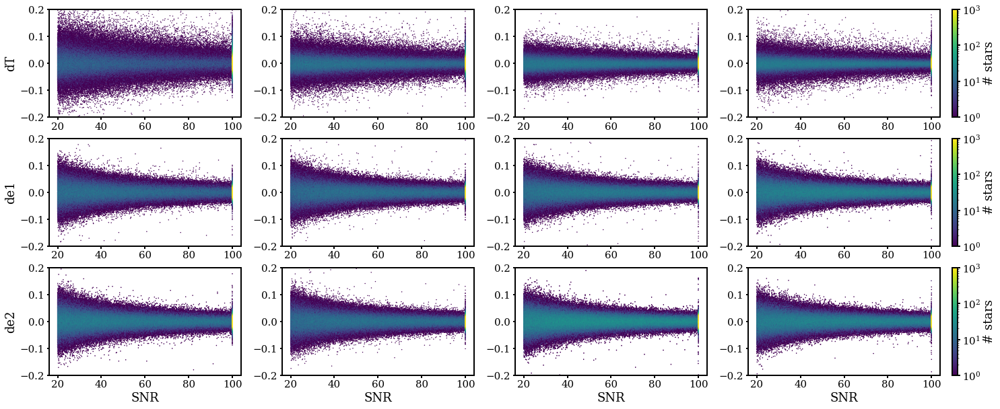

In [31]:
fig, axs = plt.subplots(3,4, figsize=(25,10), gridspec_kw={'width_ratios': [1,1,1,1.25]})
# shape residuals vs. SNR
for i, band in enumerate(bands):
    ccat = cat[cat['BAND'] == band]
    
    ax = axs[0,i]
    tmax = 0.2
    mask = np.abs(ccat['T_DATA']-ccat['T_MODEL']) < tmax
    snr = ccat['SNR'][mask]
    dat = (ccat['T_DATA']-ccat['T_MODEL'])[mask]
    im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
    ax.set_ylim(-tmax,tmax)
    if band == 'g':
        ax.set_ylabel('dT')
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label('# stars')

    ax = axs[1,i]
    emax = 0.2
    mask = (np.abs(ccat['G1_DATA']-ccat['G1_MODEL'] < emax))
    snr = ccat['SNR'][mask]
    dat = (ccat['G1_DATA']-ccat['G1_MODEL'])[mask]
    im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
    # ax.set_xlabel('SNR')
    ax.set_ylim(-emax, emax)
    if band == 'g':
        ax.set_ylabel('de1')
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label('# stars')

    ax = axs[2,i]
    emax = 0.2
    mask = (np.abs(ccat['G2_DATA']-ccat['G2_MODEL'] < emax))
    snr = ccat['SNR'][mask]
    dat = (ccat['G2_DATA']-ccat['G2_MODEL'])[mask]
    im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
    ax.set_xlabel('SNR')
    ax.set_ylim(-emax, emax)
    if band == 'g':
        ax.set_ylabel('de2')
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label('# stars')


RA:  -2.189960940485035 362.1336141434348 DEC:  -68.31770650302578 5.934554708512705


/tmp/ipykernel_3576/1306146032.py:9: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(catra, cat['DEC'], bins='log', mincnt=1, gridsize=500, vmax=300)


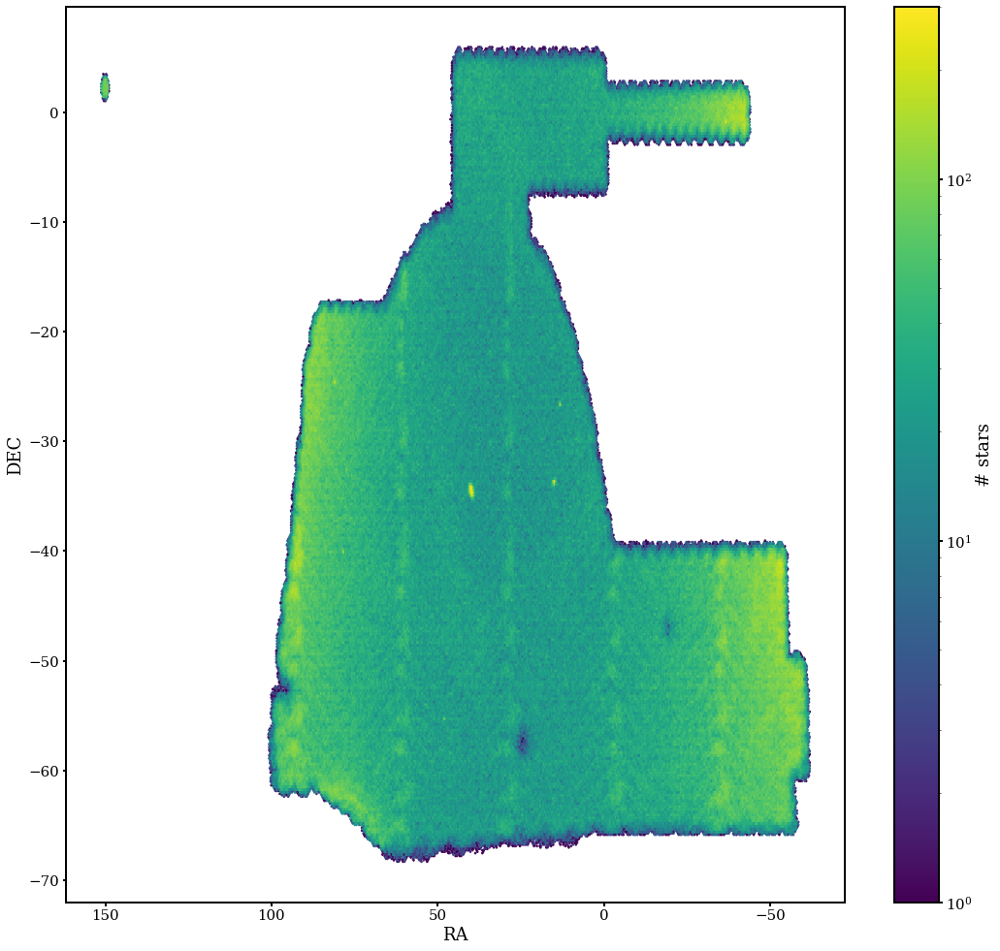

In [32]:
#plot footprint
print('RA: ', min(cat['RA']), max(cat['RA']), 
      'DEC: ', min(cat['DEC']), max(cat['DEC']))

fig, ax = plt.subplots(1,1, figsize=(18,17))
#plot g-r_color vs g_mag 2d histogram with log density
catra = cat['RA']
catra[catra > 180.] -= 360.
im = ax.hexbin(catra, cat['DEC'], bins='log', mincnt=1, gridsize=500, vmax=300)
ax.set_xlabel('RA')
ax.set_ylabel('DEC')
cbar = plt.colorbar(im, ax=ax)
cbar.set_label('# stars')
ax.invert_xaxis()
#ax.set_ylim(cat['dec'].min(), cat['dec'].max())
plt.show()

In [33]:
bright_stars = fitsio.read('/global/cscratch1/sd/schutt20/asu.fit')
bright_stars

array([(1.29125   ,  45.22916667,    1, '',      3,  36042, ' ', '   46', '', 1.29125   ,  45.22916667, 6.7 ,  0.07,  0.08,  nan, '  A1Vn', ' ',    1),
       (1.26583333,  -0.50305556,    2, '',      6, 128569, ' ', '', '', 1.26583333,  -0.50305556, 6.29,  1.1 ,  1.02,  nan, ' gG9', ' ',    2),
       (1.33375   ,  -5.7075    ,    3, ' 33    Psc',     28, 128572, 'I', '', 'Var?', 1.33375   ,  -5.7075    , 4.61,  1.04,  0.89, 0.54, '  K0IIIbCN-0.5', '*',    3),
       ...,
       (1.17208333, -71.43694444, 9108, '', 225253, 255631, ' ', '', '', 1.17208333, -71.43694444, 5.59, -0.12, -0.42,  nan, '  B8IV-V', ' ', 9108),
       (1.23333333,  26.64888889, 9109, '', 225276,  73731, 'I', '   42', '', 1.23333333,  26.64888889, 6.25,  1.4 ,  1.59,  nan, '  K4IIIb', ' ', 9109),
       (1.27583333,  61.31416667, 9110, '', 225289,  10962, ' ', '', 'V567 Cas', 1.27583333,  61.31416667, 5.8 , -0.09, -0.32,  nan, '  B8IVpHgMn', '*', 9110)],
      dtype=[('_RAJ2000', '>f8'), ('_DEJ2000', '>f8'), ('H

In [34]:
brightra = bright_stars['_RAJ2000']
brightra[brightra > 180.] -= 360.

In [35]:
footprint = ((brightra > catra.min())
            & (brightra < catra.max())
            & (bright_stars['_DEJ2000'] > cat['DEC'].min())
            & (bright_stars['_DEJ2000'] < cat['DEC'].max()))
    

pts = ax.scatter(brightra[footprint],
                 bright_stars['_DEJ2000'][footprint],
                 color='r')

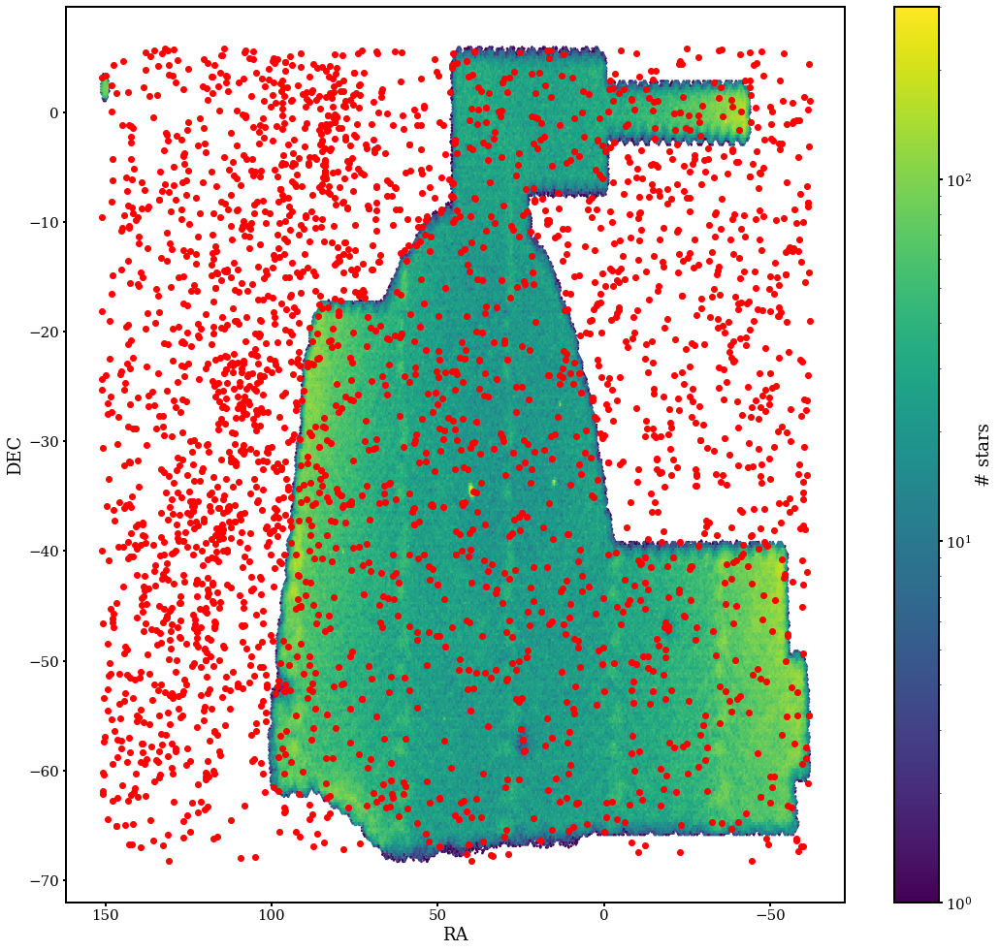

In [36]:
fig

g 13.274087220581436 29.71773115116262
r 13.456324879489593 29.7150090513441
i 13.669338584007281 30.01617652495448


/tmp/ipykernel_3576/2342909619.py:6: RuntimeWarning: invalid value encountered in log10
  mag = zeropt - 2.5*np.log10(flux)


z 13.449528644824362 29.71948643968338


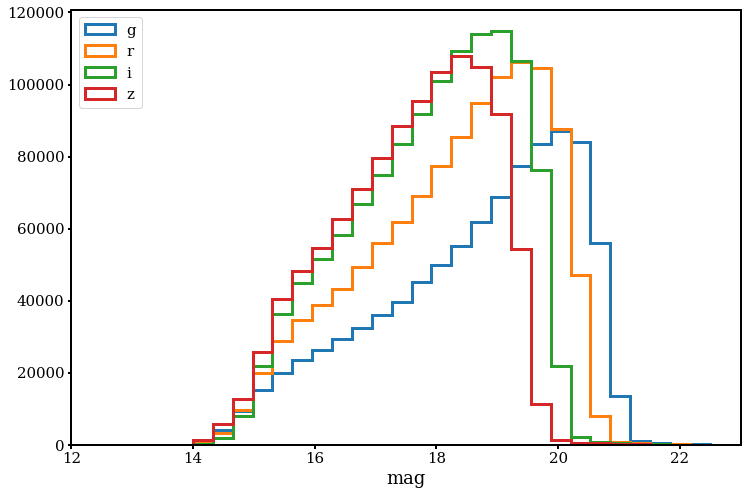

In [37]:
fig, ax = plt.subplots(1,1, figsize=(12,8))
bins = np.linspace(14, 30, 50)
for i, band in enumerate(bands):
    flux = cat['FLUX'][cat['BAND'] == band]
    zeropt = 30.
    mag = zeropt - 2.5*np.log10(flux)
    print(band, min(mag), max(mag))
    ax.hist(mag, bins=bins, histtype='step', label=band, lw=3)
    ax.legend()
    ax.set_xlim(12, 23)
    ax.set_xlabel('mag')

In [38]:
for band in bands:
    if band == 'z':
        color = 'IZ_COLOR'
    else:
        color = 'GI_COLOR'
    chist = cat[color][cat['BAND'] == band]
    print(min(chist), max(chist))

4.148396692471579e-05 3.49983286857605
5.4901818657526746e-05 3.4999582767486572
6.072265387047082e-05 3.4999969005584717
2.3634869705801975e-07 0.6999980807304382


In [27]:
# 110606507 - len(cat)

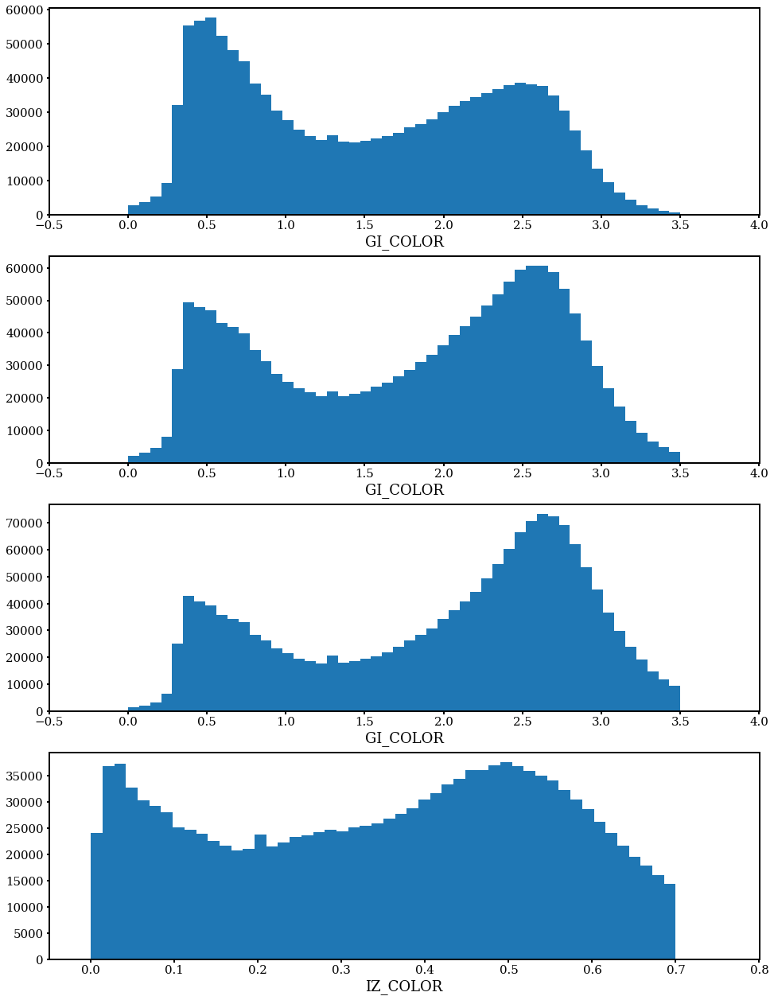

In [28]:
# plot color distribution per band
# fig, axs = plt.subplots(4, 1, figsize=(16,22))
# for i, band in enumerate(bands):
#     ax = axs[i]
#     if band == 'z':
#         color = 'IZ_COLOR'
#         ax.set_xlim(-0.05, 0.8)
#     else:
#         color = 'GI_COLOR'
#         ax.set_xlim(-0.5, 4.)
#     chist = cat[color][cat['BAND'] == band]
#     ax.hist(chist, bins=50)
#     ax.set_xlabel(color)

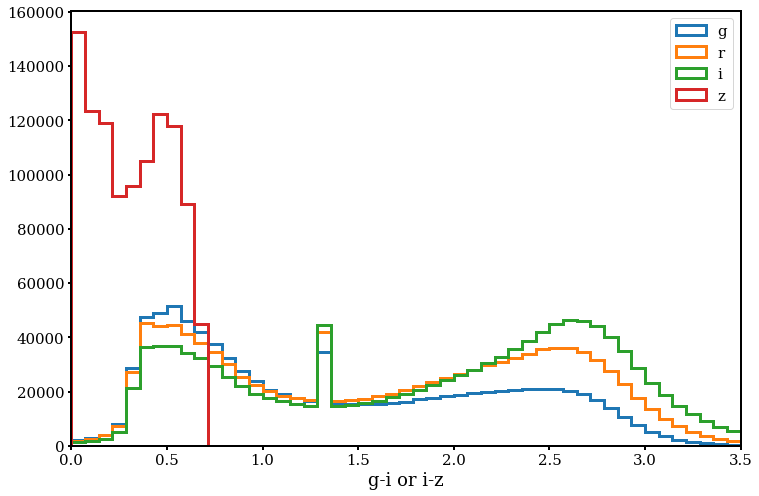

In [39]:
fig, ax = plt.subplots(1,1, figsize=(12,8))
bins = np.linspace(0, 3.5, 50)
for i, band in enumerate(bands):
    if band == 'z':
        color = 'IZ_COLOR'
    else:
        color = 'GI_COLOR'
    chist = cat[color][cat['BAND'] == band]
    ax.hist(chist, bins=bins, histtype='step', label=band, lw=3)
    ax.legend()
    ax.set_xlim(0, 3.5)
    ax.set_xlabel('g-i or i-z')

g GI_COLOR 1.3
921419
18656
r GI_COLOR 1.3
1130428
25333
i GI_COLOR 1.3
1188171
29958
z IZ_COLOR 0.2
1062461
28326


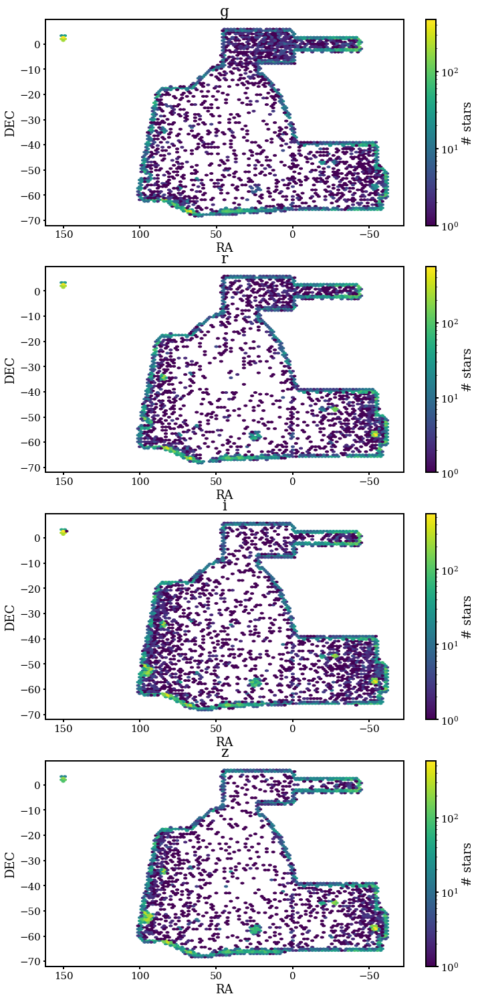

In [40]:
fig, axs = plt.subplots(4,1, figsize=(12,26))
bins = np.linspace(0, 3.5, 50)
for i, band in enumerate(bands):
    if band == 'z':
        color = 'IZ_COLOR'
        c_default = 0.2
    else:
        color = 'GI_COLOR'
        c_default = 1.3
    print(band, color, c_default)
    data = cat[cat['BAND']==band]
    print(len(data))
    mask = np.abs(data[color] - c_default) < 1e-6
    data = data[mask]
    print(len(data))
    catra = data['RA']
    catra[catra > 180.] -= 360.
    ax=axs[i]
    im = ax.hexbin(catra, data['DEC'], bins='log', mincnt=1)
    ax.set_xlabel('RA')
    ax.set_ylabel('DEC')
    ax.set_title(band)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('# stars')
    ax.invert_xaxis()

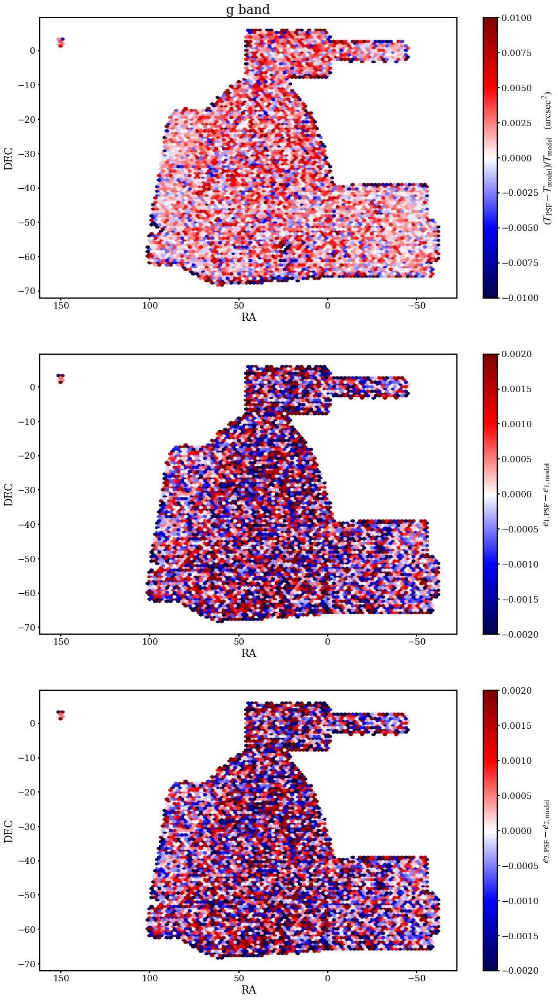

In [8]:
fig, axs = plt.subplots(3,1, figsize=(16,30))
band = 'g'
data = cat[cat['BAND'] == band]
catra = data['RA']
catra[catra > 180.] -= 360.
dTfrac = (data['T_DATA']-data['T_MODEL'])/data['T_MODEL']
de1 = data['G1_DATA']-data['G1_MODEL']
de2 = data['G2_DATA']-data['G2_MODEL']
cmap = plt.get_cmap('seismic')

ax = axs[0]
ax.set_title('{} band'.format(band))
# ax.set_ylim(Tlims)
vmin=-0.01
im = ax.hexbin(catra, data['DEC'], dTfrac, mincnt=1, cmap=cmap, vmin=vmin, vmax=-vmin)
cbar = plt.colorbar(im, ax=ax)
cbar.set_label(r'$(T_{\rm PSF} - T_{\rm model})/ T_{\rm model} \quad({\rm arcsec}^2)$')
ax.set_xlabel('RA')
ax.set_ylabel('DEC')
# ax.set_title(band)
ax.invert_xaxis()

ax = axs[1]
vmin=-0.002
im = ax.hexbin(catra, data['DEC'], de1, mincnt=1, cmap=cmap, vmin=vmin, vmax=-vmin)
cbar = plt.colorbar(im, ax=ax)
cbar.set_label(r'$e_{1, \rm PSF} - e_{1, \rm model}$')
ax.set_xlabel('RA')
ax.set_ylabel('DEC')
# ax.set_title(band)
ax.invert_xaxis()

ax = axs[2]
vmin=-0.002
im = ax.hexbin(catra, data['DEC'], de1, mincnt=1, cmap=cmap, vmin=vmin, vmax=-vmin)
cbar = plt.colorbar(im, ax=ax)
cbar.set_label(r'$e_{2, \rm PSF} - e_{2, \rm model}$')
ax.set_xlabel('RA')
ax.set_ylabel('DEC')
# ax.set_title(band)
ax.invert_xaxis()

In [9]:
def plot_radec_shape(ra, dec, T, e1, e2, Tlims=(0.2, 1.0), elims=(-0.1,0.1), band=None, axes=None):
    
    cmap = plt.get_cmap('seismic')
    ax = axes[0]
    im = ax.hexbin(ra, dec, T, mincnt=1, cmap=cmap, vmin=Tlims[0], vmax=Tlims[1])
    imvals = im.get_array()
    print('T: mean, median, std: ', '%.3f, %.3f, %.3f'%(np.mean(imvals), np.median(imvals), np.std(imvals)))
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label(r'$\left<T\right>$')
    ax.set_xlabel('RA')
    ax.set_ylabel('DEC')
    ax.set_title(band)
    ax.invert_xaxis()

    ax = axes[1]
    im = ax.hexbin(ra, dec, e1, mincnt=1, cmap=cmap, vmin=elims[0], vmax=elims[1])
    imvals = im.get_array()
    print('e1: mean, median, std: ', '%.4f, %.4f, %.4f'%(np.mean(imvals), np.median(imvals), np.std(imvals)))
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label(r'$\left<e1\right>$')
    ax.set_xlabel('RA')
    ax.set_ylabel('DEC')
    ax.invert_xaxis()
    
    ax = axes[2]

    im = ax.hexbin(ra, dec, e2, mincnt=1, cmap=cmap, vmin=elims[0], vmax=elims[1])
    imvals = im.get_array()
    print('e2: mean, median, std: ', '%.4f, %.4f, %.4f'%(np.mean(imvals), np.median(imvals), np.std(imvals)))
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label(r'$\left<e2\right>$')
    ax.set_xlabel('RA')
    ax.set_ylabel('DEC')
    ax.invert_xaxis()
    plt.tight_layout()

T: mean, median, std:  0.605, 0.594, 0.095
e1: mean, median, std:  0.0052, 0.0073, 0.0158
e2: mean, median, std:  -0.0017, -0.0003, 0.0134
T: mean, median, std:  0.460, 0.454, 0.065
e1: mean, median, std:  -0.0004, 0.0007, 0.0091
e2: mean, median, std:  -0.0044, -0.0042, 0.0079
T: mean, median, std:  0.373, 0.366, 0.045
e1: mean, median, std:  -0.0025, -0.0020, 0.0085
e2: mean, median, std:  -0.0052, -0.0052, 0.0078
T: mean, median, std:  0.365, 0.358, 0.053
e1: mean, median, std:  -0.0036, -0.0032, 0.0094
e2: mean, median, std:  -0.0065, -0.0064, 0.0080


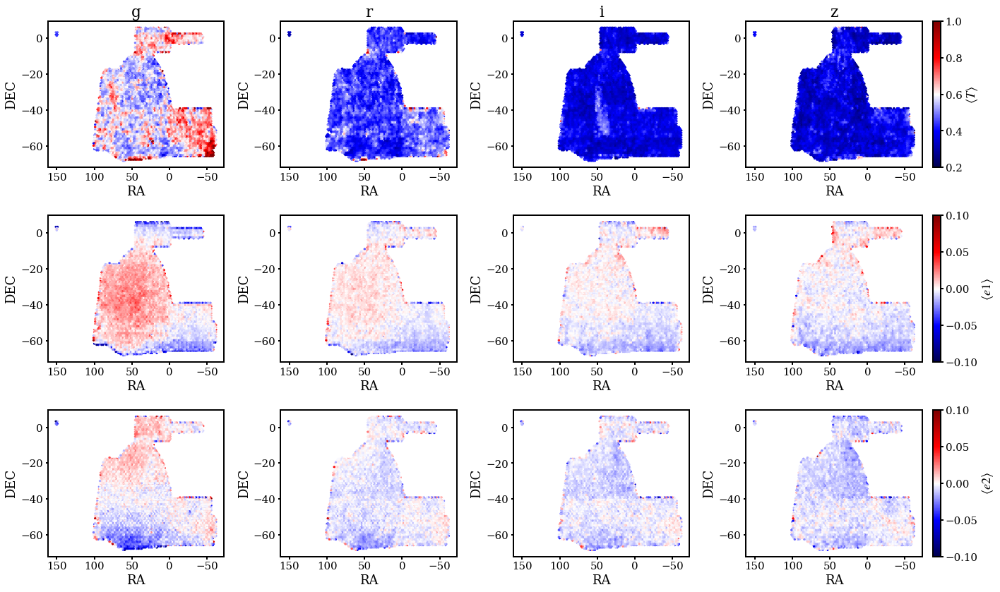

In [43]:
fig, axs = plt.subplots(3,4, figsize=(20,12), gridspec_kw={'width_ratios': [1,1,1,1.25]})
for i, band in enumerate(bands):
    if band == 'z':
        color = 'IZ_COLOR'
        c_default = 0.25
    else:
        color = 'GI_COLOR'
        c_default = 1.6
    data = cat[cat['BAND'] == band]
    catra = data['RA']
    catra[catra > 180.] -= 360.
    plot_radec_shape(catra, data['DEC'], data['T_DATA'], data['G1_DATA'], data['G2_DATA'],
                     band=band, axes=axs[:,i])

In [10]:
def plot_radec_res(ra, dec, dT, dTfrac, de1, de2, min_edge=0., max_edge=3.5, 
                Tlims=(-0.0075, 0.0075), Tfraclims=(-0.02, 0.02),
                elims=(-6.e-4,6.e-4), band=None, axes=None):
    
    cmap = plt.get_cmap('seismic')
    ax = axes[0]
    vmin=Tfraclims[0]
    im = ax.hexbin(ra, dec, dTfrac, mincnt=1, cmap=cmap, vmin=vmin, vmax=-vmin)
    imvals = im.get_array()
    print('dT/T: mean, median, std: ', '%.6f, %.6f, %.6f'%(np.mean(imvals), np.median(imvals), np.std(imvals)))
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label(r'$(T_{\rm PSF} - T_{\rm model})/ T_{\rm model}$')
    ax.set_xlabel('RA')
    ax.set_ylabel('DEC')
    ax.set_title(band)
    ax.invert_xaxis()

    ax = axes[1]
    # ax.set_xlim(min_edge,max_edge)
    # ax.set_ylim(elims)
    vmin=elims[0]
    im = ax.hexbin(ra, dec, de1, mincnt=1, cmap=cmap, vmin=vmin, vmax=-vmin)
    imvals = im.get_array()
    print('de1: mean, median, std: ', '%.6f, %.6f, %.6f'%(np.mean(imvals), np.median(imvals), np.std(imvals)))
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label(r'$e_{1, \rm PSF} - e_{1, \rm model}$')
    ax.set_xlabel('RA')
    ax.set_ylabel('DEC')
    ax.set_title(band)
    ax.invert_xaxis()
    
    ax = axes[2]
    # ax.set_xlim(min_edge,max_edge)
    # ax.set_ylim(elims)
    im = ax.hexbin(ra, dec, de2, mincnt=1, cmap=cmap, vmin=vmin, vmax=-vmin)
    imvals = im.get_array()
    print('de2: mean, median, std: ', '%.6f, %.6f, %.6f'%(np.mean(imvals), np.median(imvals), np.std(imvals)))
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label(r'$e_{2, \rm PSF} - e_{2, \rm model}$')
    ax.set_xlabel('RA')
    ax.set_ylabel('DEC')
    ax.set_title(band)
    ax.invert_xaxis()
    plt.tight_layout()

dT/T: mean, median, std:  0.001463, 0.001401, 0.005000
de1: mean, median, std:  0.000006, 0.000013, 0.002024
de2: mean, median, std:  0.000008, -0.000000, 0.002083
dT/T: mean, median, std:  -0.000110, -0.000173, 0.004222
de1: mean, median, std:  -0.000022, -0.000030, 0.002014
de2: mean, median, std:  -0.000033, -0.000029, 0.001968
dT/T: mean, median, std:  -0.000562, -0.000539, 0.003745
de1: mean, median, std:  0.000020, 0.000013, 0.001679
de2: mean, median, std:  -0.000084, -0.000065, 0.001795
dT/T: mean, median, std:  -0.000538, -0.000634, 0.004155
de1: mean, median, std:  -0.000003, -0.000008, 0.001724
de2: mean, median, std:  -0.000015, -0.000008, 0.001746


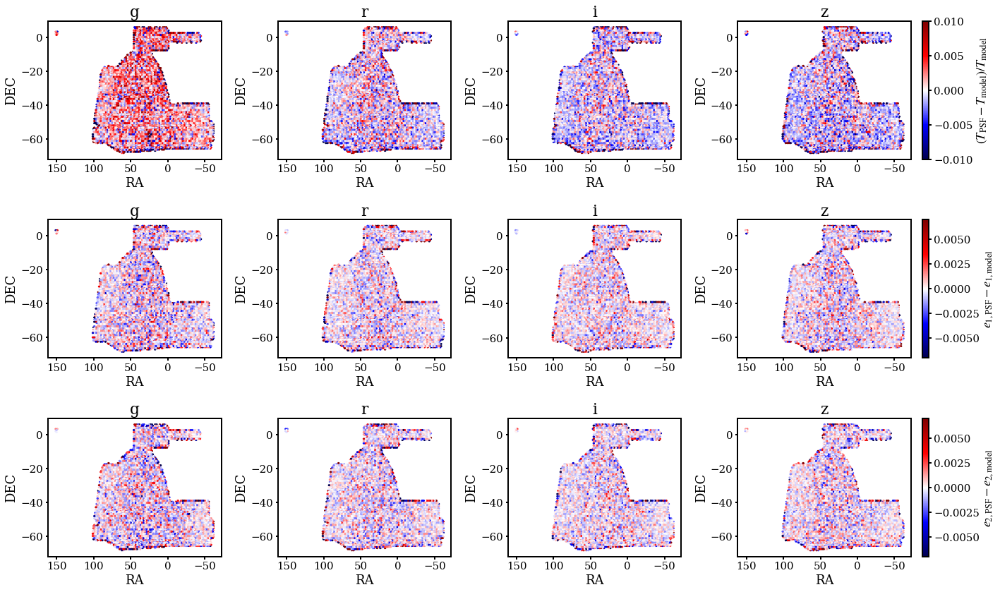

In [13]:
fig, axs = plt.subplots(3,4, figsize=(20,12), gridspec_kw={'width_ratios': [1,1,1,1.25]})
for i, band in enumerate(bands):
    data = cat[cat['BAND'] == band]
    catra = data['RA']
    catra[catra > 180.] -= 360.
    plot_radec_res(catra, data['DEC'], data['T_DATA']-data['T_MODEL'], 
                   (data['T_DATA']-data['T_MODEL'])/data['T_MODEL'],
                   data['G1_DATA']-data['G1_MODEL'], data['G2_DATA']-data['G2_MODEL'], 
                   Tlims=(-0.01, 0.01), Tfraclims=(-0.01, 0.01), elims=(-7e-3, 7e-3),
                   band=band, axes=axs[:,i])

#### Non-matches with default colors

g GI_COLOR 1.3 921419
18656
dT/T: mean, median, std:  0.017502, 0.006202, 0.035949
de1: mean, median, std:  0.002557, 0.000883, 0.014322
de2: mean, median, std:  -0.001755, -0.000581, 0.012362
r GI_COLOR 1.3 1130428
25333
dT/T: mean, median, std:  0.006945, 0.002024, 0.025657
de1: mean, median, std:  0.000820, 0.000075, 0.011721
de2: mean, median, std:  -0.000694, -0.000245, 0.011085
i GI_COLOR 1.3 1188171
29958
dT/T: mean, median, std:  0.006563, 0.001849, 0.024255
de1: mean, median, std:  0.000178, 0.000084, 0.011135
de2: mean, median, std:  -0.000331, -0.000235, 0.010744
z IZ_COLOR 0.2 1062461
28326
dT/T: mean, median, std:  0.005459, 0.001115, 0.023761
de1: mean, median, std:  0.000487, 0.000011, 0.013134
de2: mean, median, std:  0.000421, -0.000017, 0.012175


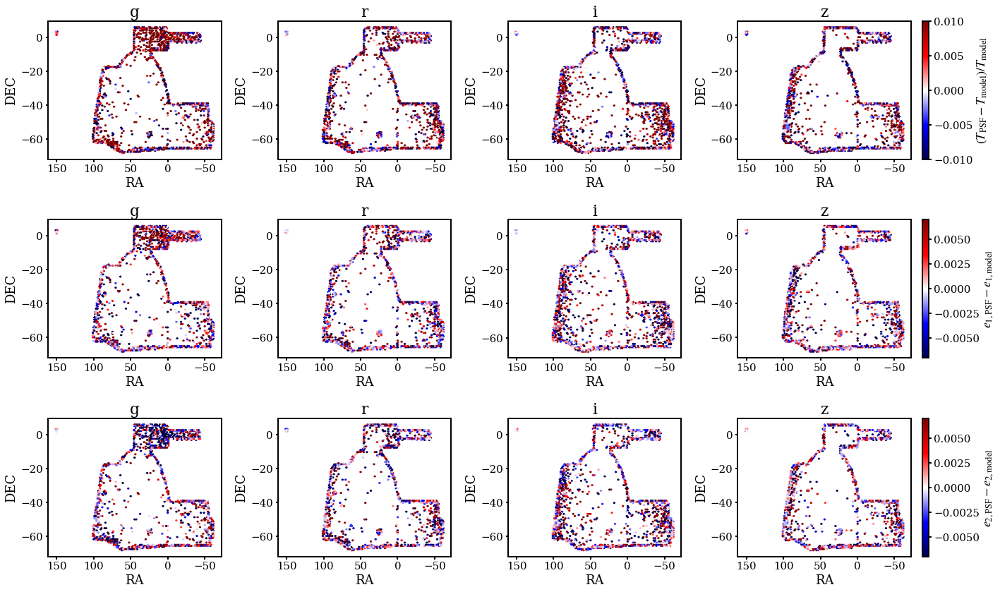

In [14]:
fig, axs = plt.subplots(3,4, figsize=(20,12), gridspec_kw={'width_ratios': [1,1,1,1.25]})
for i, band in enumerate(bands):
    if band == 'z':
        color = 'IZ_COLOR'
        c_default = 0.2
    else:
        color = 'GI_COLOR'
        c_default = 1.3
    data = cat[cat['BAND'] == band]
    print(band, color, c_default, len(data))
    mask = np.abs(data[color] - c_default) < 1e-6
    data = data[mask]
    print(len(data))
    catra = data['RA']
    catra[catra > 180.] -= 360.
    plot_radec_res(catra, data['DEC'], data['T_DATA']-data['T_MODEL'], 
                   (data['T_DATA']-data['T_MODEL'])/data['T_MODEL'],
                   data['G1_DATA']-data['G1_MODEL'], data['G2_DATA']-data['G2_MODEL'], 
                   Tlims=(-0.01, 0.01), Tfraclims=(-0.01, 0.01), elims=(-7e-3, 7e-3),
                   band=band, axes=axs[:,i])

#### Only matches, non-matches removed

g GI_COLOR 1.3 921419
902763
dT/T: mean, median, std:  0.001304, 0.001233, 0.004778
de1: mean, median, std:  0.000045, 0.000014, 0.002137
de2: mean, median, std:  0.000006, 0.000005, 0.002186
r GI_COLOR 1.3 1130428
1105095
dT/T: mean, median, std:  -0.000183, -0.000226, 0.003699
de1: mean, median, std:  -0.000043, -0.000043, 0.001805
de2: mean, median, std:  0.000001, -0.000008, 0.001810
i GI_COLOR 1.3 1188171
1158213
dT/T: mean, median, std:  -0.000574, -0.000533, 0.003259
de1: mean, median, std:  0.000005, -0.000004, 0.001721
de2: mean, median, std:  -0.000051, -0.000040, 0.001705
z IZ_COLOR 0.2 1062461
1034135
dT/T: mean, median, std:  -0.000585, -0.000616, 0.003520
de1: mean, median, std:  0.000021, 0.000025, 0.001699
de2: mean, median, std:  -0.000025, -0.000018, 0.001751


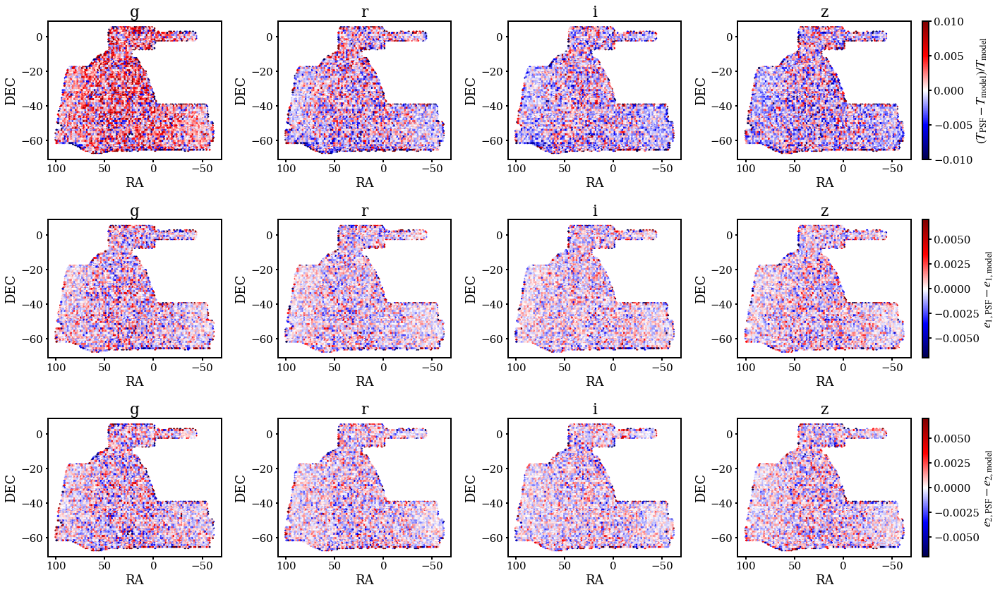

In [15]:
fig, axs = plt.subplots(3,4, figsize=(20,12), gridspec_kw={'width_ratios': [1,1,1,1.25]})
for i, band in enumerate(bands):
    if band == 'z':
        color = 'IZ_COLOR'
        c_default = 0.2
    else:
        color = 'GI_COLOR'
        c_default = 1.3
    data = cat[cat['BAND'] == band]
    print(band, color, c_default, len(data))
    mask = np.abs(data[color] - c_default) < 1e-6
    data = data[np.logical_not(mask)]
    print(len(data))
    catra = data['RA']
    catra[catra > 180.] -= 360.
    plot_radec_res(catra, data['DEC'], data['T_DATA']-data['T_MODEL'], 
                   (data['T_DATA']-data['T_MODEL'])/data['T_MODEL'],
                   data['G1_DATA']-data['G1_MODEL'], data['G2_DATA']-data['G2_MODEL'], 
                   Tlims=(-0.01, 0.01), Tfraclims=(-0.01, 0.01), elims=(-7e-3, 7e-3),
                   band=band, axes=axs[:,i])

g GI_COLOR 1.3 921419
902763


TypeError: cannot perform reduce with flexible type

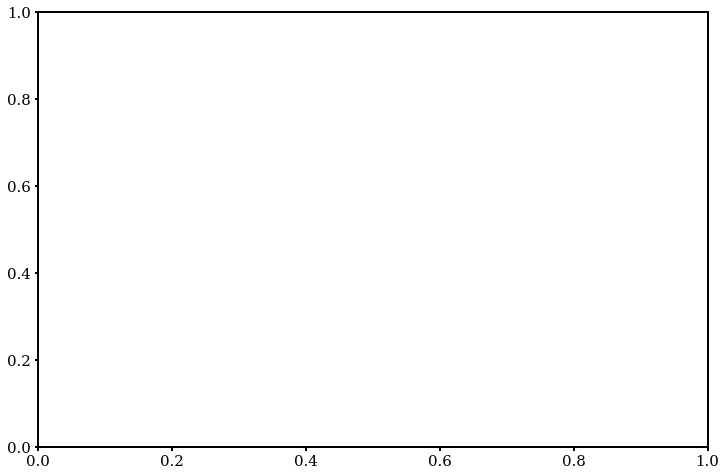

In [52]:
fig, ax = plt.subplots(1,1, figsize=(12,8))
bins = np.linspace(0, 3.5, 50)
for i, band in enumerate(bands):
    if band == 'z':
        color = 'IZ_COLOR'
        c_default = 0.2
    else:
        color = 'GI_COLOR'
        c_default = 1.3
    data = cat[cat['BAND'] == band]
    print(band, color, c_default, len(data))
    mask = np.abs(data[color] - c_default) < 1e-6
    data = data[np.logical_not(mask)]
    print(len(data))
    ax.hist(data, bins=bins, histtype='step', label=band, lw=3)
    ax.legend()
    ax.set_xlim(0, 3.5)
    ax.set_xlabel('g-i or i-z')

/tmp/ipykernel_3576/3427468552.py:14: RuntimeWarning: invalid value encountered in log10
  mag = zeropt - 2.5*np.log10(flux)


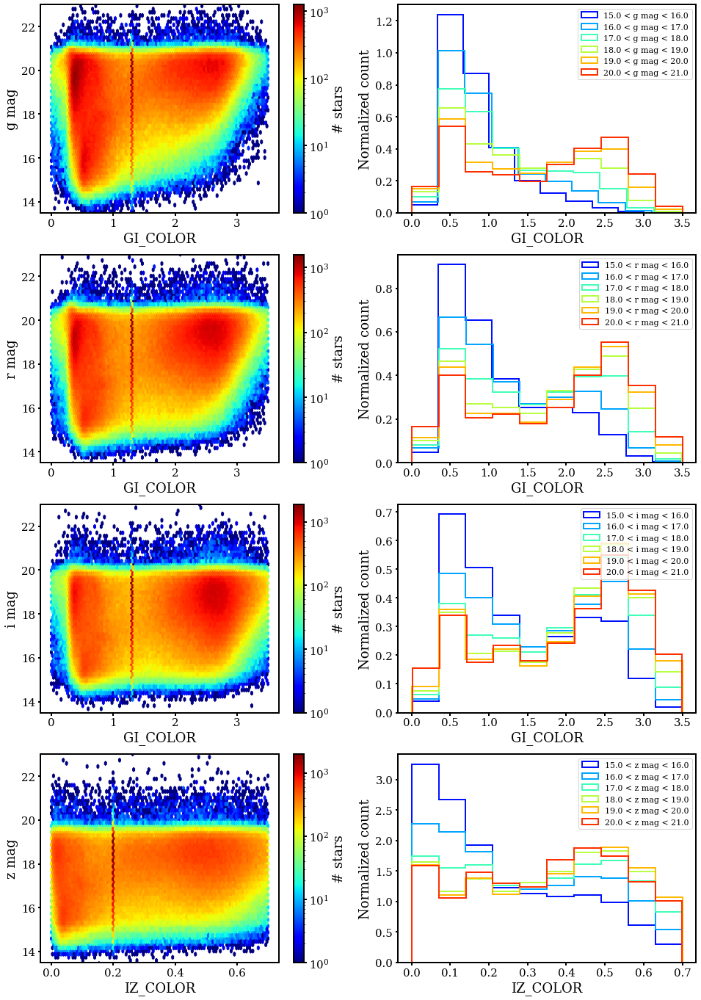

In [53]:
#plot color vs mag per band
fig, axs = plt.subplots(4,2, figsize=(16,24))
cmap = plt.get_cmap('jet')
for i, band in enumerate(bands):
    ax = axs[i][0]
    #plot g-r_color vs g_mag 2d histogram with log density
    if band == 'z':
        color = 'IZ_COLOR'
    else:
        color = 'GI_COLOR'
    chist = cat[color][cat['BAND'] == band]
    flux = cat['FLUX'][cat['BAND'] == band]
    zeropt = 30.
    mag = zeropt - 2.5*np.log10(flux)
    im = ax.hexbin(chist, mag, bins='log', mincnt=1, cmap=cmap)
    ax.set_ylim(13.5, 23)
    ax.set_ylabel('{} mag'.format(band))
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('# stars')
    
    #plot color histogram in mag slices
    ax = axs[i][1]
    nbins = 7
    cbins = np.linspace(15., 21., nbins)
    for i in range(len(cbins)-1):
        k = i+1
        mask = np.logical_and(np.greater_equal(mag, cbins[i]),
                              np.less(mag, cbins[k]))
        color_slice = chist[mask]
        loedge = '{0:3.1f}'.format(cbins[i])
        hiedge = '{0:3.1f}'.format(cbins[k])
        ax.hist(color_slice, density=True, 
                    label='{} < {} mag < {}'.format(loedge, band, hiedge),
                    histtype='step', lw=2, color=cmap(k/nbins))
        ax.legend(ncol=1, fontsize=11)
        ax.set_xlabel(color)
        ax.set_ylabel('Normalized count')

e1 0.005004936293904815 0.0036993673477592436 0.03707189657330999
e2 -0.001319428639409835 -0.0009474361437289008 0.03600777151700984
e1 -0.000535216567042362 -0.00157296096363697 0.028301397451943502
e2 -0.003687611335889818 -0.00357943582417695 0.02906757023594961
e1 -0.002621238178088039 -0.0036241011753288667 0.027823410778460955
e2 -0.004453549894267746 -0.004608824973042397 0.028895555819096544
e1 -0.004051684220001857 -0.004692188919590126 0.028975473514535034
e2 -0.00538897090068843 -0.0056639832457939555 0.030179602972524516


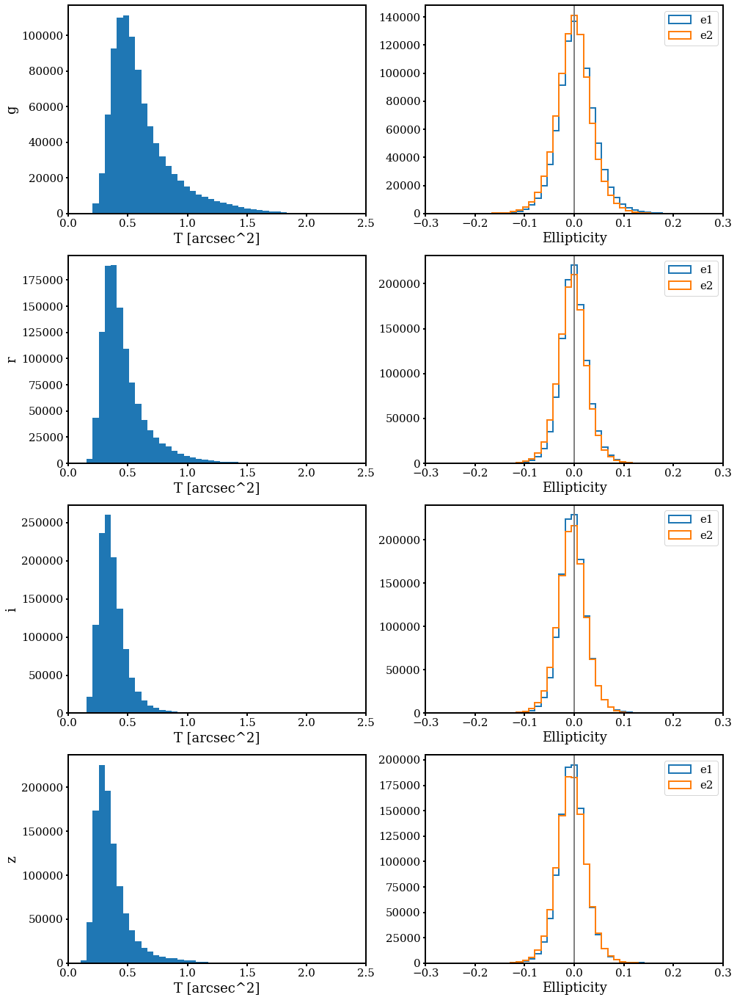

In [54]:
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    ax = axs[i][0]
    # plot size histogram
    size = cat['T_DATA'][cat['BAND'] == band]
    ax.hist(size, bins=np.linspace(0, 2.5, 50))
    ax.set_xlim(0, 2.5)
    ax.set_xlabel('T [arcsec^2]')
    ax.set_ylabel(band)
    
    #plot e1 and e2 histograms
    ax = axs[i][1]
    e1 = cat['G1_DATA'][cat['BAND'] == band]
    e2 = cat['G2_DATA'][cat['BAND'] == band]
    print('e1', np.mean(e1), np.median(e1), np.std(e1))
    print('e2', np.mean(e2), np.median(e2), np.std(e2))
    ax.hist(e1, bins=np.linspace(-0.3, 0.3, 50), histtype='step', label='e1', lw=2)
    ax.hist(e2, bins=np.linspace(-0.3, 0.3, 50), histtype='step', label='e2', lw=2)
    ax.axvline(0, color='Grey')
    ax.set_xlim(-0.3, 0.3)
    ax.legend()
    ax.set_xlabel('Ellipticity')

g mean, median, std: (0.6146013908877682, 0.5414255463722301, 0.2654777020935369)
r mean, median, std: (0.46519926225258973, 0.41238584055373584, 0.195348101033709)
i mean, median, std: (0.3731701898619095, 0.34866245038591975, 0.12607730450965118)
z mean, median, std: (0.36702993446290494, 0.32565330911002754, 0.16118698728878525)


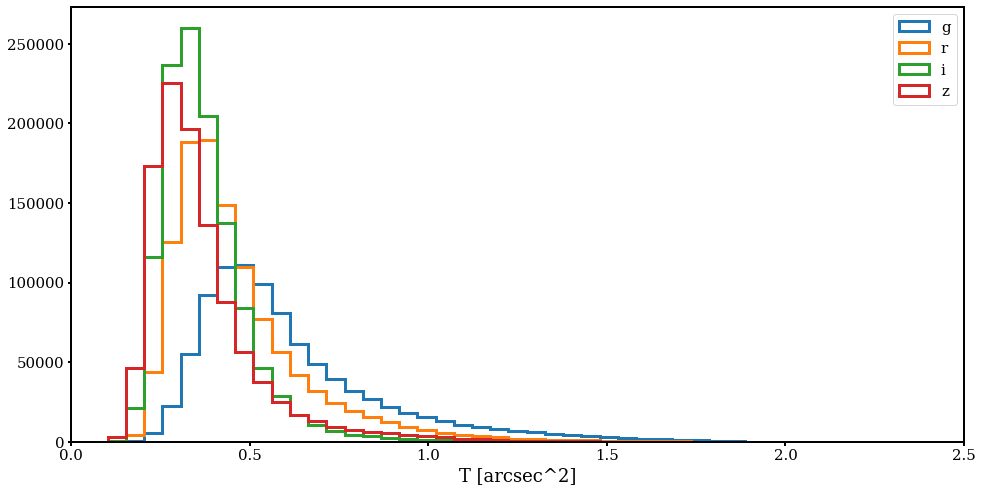

In [55]:
#plot color vs mag per band on one ax
fig, axs = plt.subplots(1,1, figsize=(16,8))
for i, band in enumerate(bands):
    ax = axs
    # plot size histogram
    size = cat['T_DATA'][cat['BAND'] == band]
    print('{} mean, median, std: {}'.format(band, (np.mean(size),
                                                   np.median(size),
                                                   np.std(size))))
    ax.hist(size, np.linspace(0, 2.5, 50), label=band, histtype='step', lw=3)
    ax.set_xlim(0, 2.5)
    ax.legend()
    ax.set_xlabel('T [arcsec^2]')

g mean, median, std: (0.6146013908877682, 0.5414255463722301, 0.2654777020935369)
r mean, median, std: (0.46519926225258973, 0.41238584055373584, 0.195348101033709)
i mean, median, std: (0.3731701898619095, 0.34866245038591975, 0.12607730450965118)
z mean, median, std: (0.36702993446290494, 0.32565330911002754, 0.16118698728878525)


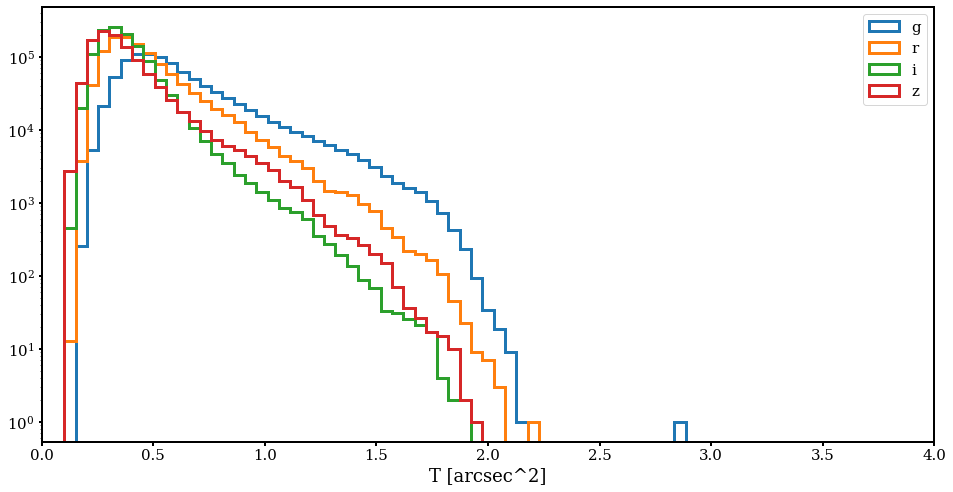

In [56]:
#plot color vs mag per band on one ax
fig, axs = plt.subplots(1,1, figsize=(16,8))
for i, band in enumerate(bands):
    ax = axs
    # plot size histogram
    size = cat['T_DATA'][cat['BAND'] == band]
    print('{} mean, median, std: {}'.format(band, (np.mean(size),
                                                   np.median(size),
                                                   np.std(size))))
    ax.hist(size, np.linspace(0, 4.0, 80), label=band, histtype='step', lw=3)
    ax.set_xlim(0, 4.0)
    ax.set_yscale('log')
    ax.legend()
    ax.set_xlabel('T [arcsec^2]')

In [57]:
for i, band in enumerate(bands):
    size = cat['PSF_FWHM'][cat['BAND'] == band]
    print('{} mean, median, std: {}'.format(band, (np.mean(size),
                                                   np.median(size),
                                                   np.std(size))))

g mean, median, std: (1.153283151030104, 1.1009999513626099, 0.2256509329750837)
r mean, median, std: (1.0021820331084172, 0.9580000042915344, 0.18527535450110286)
i mean, median, std: (0.9032928138887478, 0.8820000290870667, 0.13481026460837087)
z mean, median, std: (0.883798912011239, 0.8479999899864197, 0.16859488880643558)


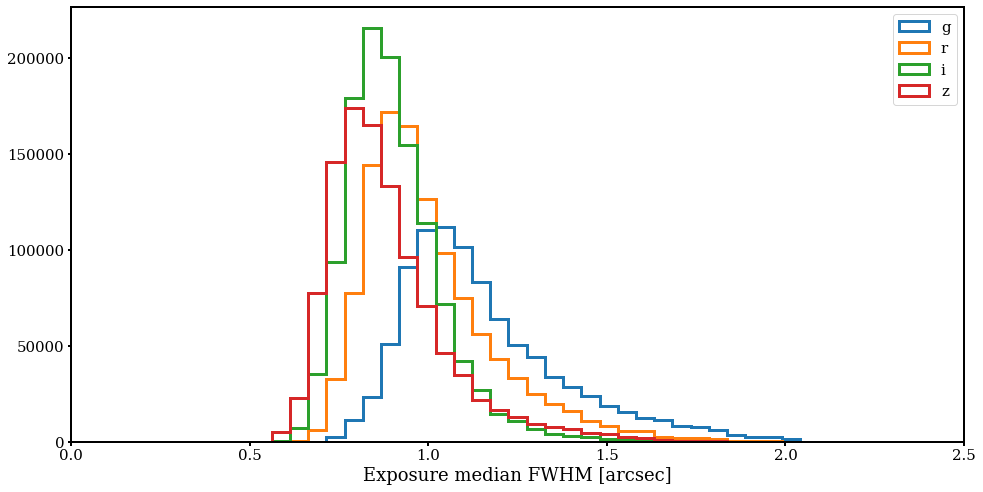

In [58]:
#plot color vs mag per band on one ax
fig, axs = plt.subplots(1,1, figsize=(16,8))
for i, band in enumerate(bands):
    ax = axs
    # plot size histogram
    size = cat['PSF_FWHM'][cat['BAND'] == band]
    ax.hist(size, np.linspace(0, 2.5, 50), label=band, histtype='step', lw=3)
    ax.set_xlim(0, 2.5)
    ax.legend()
    ax.set_xlabel('Exposure median FWHM [arcsec]')

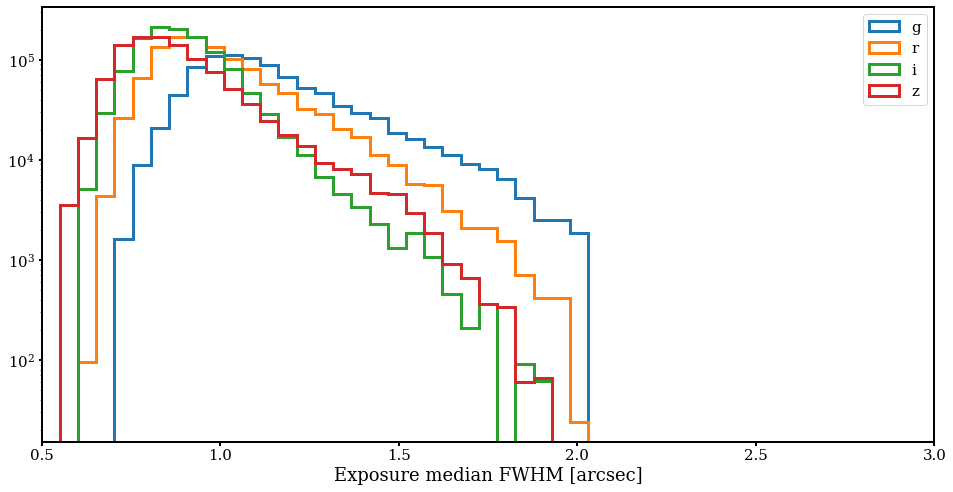

In [59]:
#plot color vs mag per band on one ax
fig, axs = plt.subplots(1,1, figsize=(16,8))
for i, band in enumerate(bands):
    ax = axs
    # plot size histogram
    size = cat['PSF_FWHM'][cat['BAND'] == band]
    ax.hist(size, np.linspace(0.5, 3.0, 50), label=band, histtype='step', lw=3)
    ax.set_xlim(0.5, 3.0)
    ax.set_yscale('log')
    ax.legend()
    ax.set_xlabel('Exposure median FWHM [arcsec]')

/tmp/ipykernel_3576/2667949696.py:17: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(tsize, fwhm, mincnt=1, bins='log', cmap=cmap, extent=(0, 3.5, 0.5, 3.0),
/tmp/ipykernel_3576/2667949696.py:17: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(tsize, fwhm, mincnt=1, bins='log', cmap=cmap, extent=(0, 3.5, 0.5, 3.0),
/tmp/ipykernel_3576/2667949696.py:17: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(tsize, fwhm, mincnt=1, bins='log

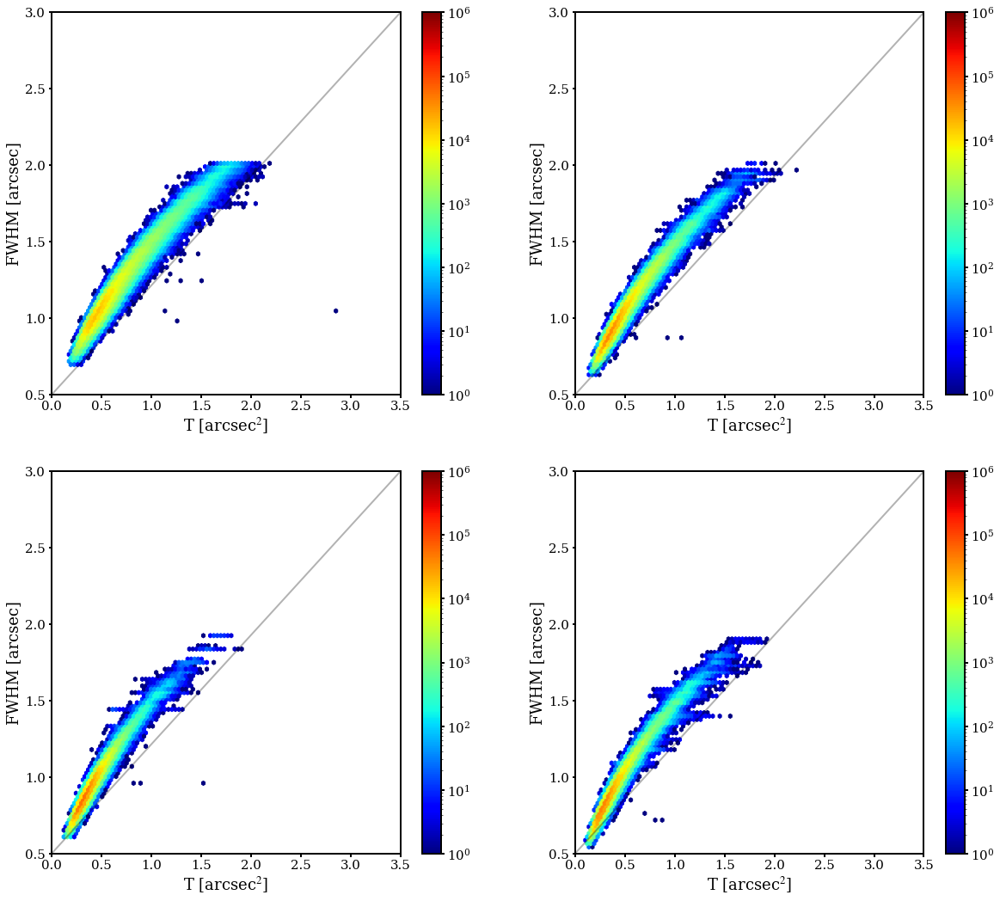

In [63]:
##plot T vs. FWHM correlation
fig, axs = plt.subplots(2,2, figsize=(20,18))
for i, band in enumerate('griz'):
    # <T> vs (color, mag)
    ax = axs[int(i/2)][i%2]
    # if band == 'z':
    #     color = 'IZ_COLOR'
    #     cmax = 0.7
    # else:
    #     color = 'GI_COLOR'
    #     cmax = 3.5
    data = cat[cat['BAND'] == band]
    tsize = data['T_DATA']
    fwhm = data['PSF_FWHM']
    
    cmap = plt.get_cmap('jet')
    im = ax.hexbin(tsize, fwhm, mincnt=1, bins='log', cmap=cmap, extent=(0, 3.5, 0.5, 3.0),
                   vmin=1., vmax=1e6)
    ax.plot(np.linspace(0,3.5,2),np.linspace(0.5,3.,2), c='k', alpha=0.3)
    # ax.set_aspect('equal')
    ax.set_xlim(0, 3.5)
    ax.set_ylim(0.5, 3.0)
    ax.set_xlabel(r'T [arcsec$^2$]')
    ax.set_ylabel('FWHM [arcsec]')
    cbar = plt.colorbar(im, ax=ax)
    #cbar.set_label(r'$\left<T_{\mathrm{PSF}}\right>$')


In [8]:
def make_profile(bin_data, shape_data, xmin=0., xmax=3.5, nbins=30):
    x_bins = np.linspace(xmin, xmax, nbins)
    # print('col_bins = ',x_bins)

    index = np.digitize(bin_data, x_bins)
    bin_shape = [shape_data[index == i].mean() for i in range(1, len(x_bins))]
    # print('bin_shape = ',bin_shape)
    bin_shape_err = [ np.sqrt(shape_data[index == i].var() / len(shape_data[index == i]))
                    for i in range(1, len(x_bins)) ]
    # print('bin_shape_err = ',bin_shape_err)

    # Fix up nans
    for i in range(1,len(x_bins)):
        if i not in index:
            bin_shape[i-1] = 0.
            bin_shape_err[i-1] = 0.
    
    return x_bins, bin_shape, bin_shape_err

In [16]:
def plot_profile(x_bins, bin_shape, bin_shape_err, ax, ymin=0., ymax=1., plt_zero_line=False,
                 min_xused=None, xlabel=None, ylabel=None, proflabel=None, profcolor=None):
    ax.set_ylim(ymin, ymax)
    if plt_zero_line:
        ax.axhline(0, color='black')
    if min_xused != None:
        ax.plot([min_xused,min_xused],[-1,1], color='Grey')
        ax.fill( [ymin,ymin,min_xused,min_xused], [-1,1,1,-1], fill=True, color='Grey',alpha=0.3)
    if profcolor is not None:
        profile = ax.errorbar(x_bins[:-1], bin_shape, yerr=bin_shape_err, fmt='o',
                              label=proflabel, color=profcolor)
    else:
        profile = ax.errorbar(x_bins[:-1], bin_shape, yerr=bin_shape_err, fmt='o',
                              label=proflabel)
        
    #ax.axhline(y=0.003, linewidth=4, color='grey')
    #ax.legend([t_line], [r'$\delta T$'])
    if proflabel is not None:
        ax.legend()
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    plt.tight_layout()

In [ ]:
# plot size vs. color 2d hist and profile
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    ax = axs[i][0]
    #plot size vs color 2d hist with log density
    if band == 'z':
        color = 'IZ_COLOR'
        gcolor = 0.34
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
        gcolor = 1.1
    # cat = cat[cat['T_DATA'] < 2.5]
    tmax = 1.6
    mask = (cat['BAND'] == band) & (cat['T_DATA'] < tmax)
    bandcat = cat[mask]
    chist = cat[color][mask]
    size = cat['T_DATA'][mask]
    cmap = plt.get_cmap('BuPu')
    im = ax.hexbin(chist, size, bins='log', mincnt=1, cmap=cmap)
    ax.set_ylim(0., tmax)
    ax.set_ylabel(r'{} band: T [arcsec$^2$]'.format(band))
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('# stars')
    
    #plot size vs color profile
    ax = axs[i][1]
    cbins, Tbins, Tbins_err = make_profile(chist, size, xmax=cmax)
    cbins2, Tpsfbins, Tpsfbins_err = make_profile(chist, cat['T_MODEL'][mask], xmax=cmax)
    stars_galcolor = bandcat['T_MODEL'][(bandcat[color] > gcolor - 0.01) & (bandcat[color] < gcolor + 0.01)]
    print(len(stars_galcolor), np.mean(stars_galcolor), np.median(stars_galcolor), np.std(stars_galcolor))
    # color+r'/%s$_{\rm gal, default}$'%color
    plot_profile(cbins, Tbins/np.mean(stars_galcolor), np.sqrt(np.power(Tbins_err,2) + np.var(stars_galcolor)), ax, ymin=0.5, ymax=1.5, xlabel=color,
                 ylabel=r'$\left<T\right>/T_{\rm PSF, gal color} \quad[{\rm arcsec}^2]$', proflabel=r'$T_{\rm *}$', profcolor='b')
    plot_profile(cbins, Tpsfbins/np.mean(stars_galcolor), np.sqrt(np.power(Tpsfbins_err,2) + np.var(stars_galcolor)), ax, ymin=0.5, ymax=1.5, xlabel=color,
                 ylabel=r'$\left<T\right>/T_{\rm PSF, gal color} \quad[{\rm arcsec}^2]$', proflabel=r'$T_{\rm PSF}$', profcolor='r')

In [68]:
a = np.linspace(0,10,11)
print(a)
a[a>2]/5
a**2

[ 0.  1.  2.  3.  4.  5.  6.  7.  8.  9. 10.]


array([  0.,   1.,   4.,   9.,  16.,  25.,  36.,  49.,  64.,  81., 100.])

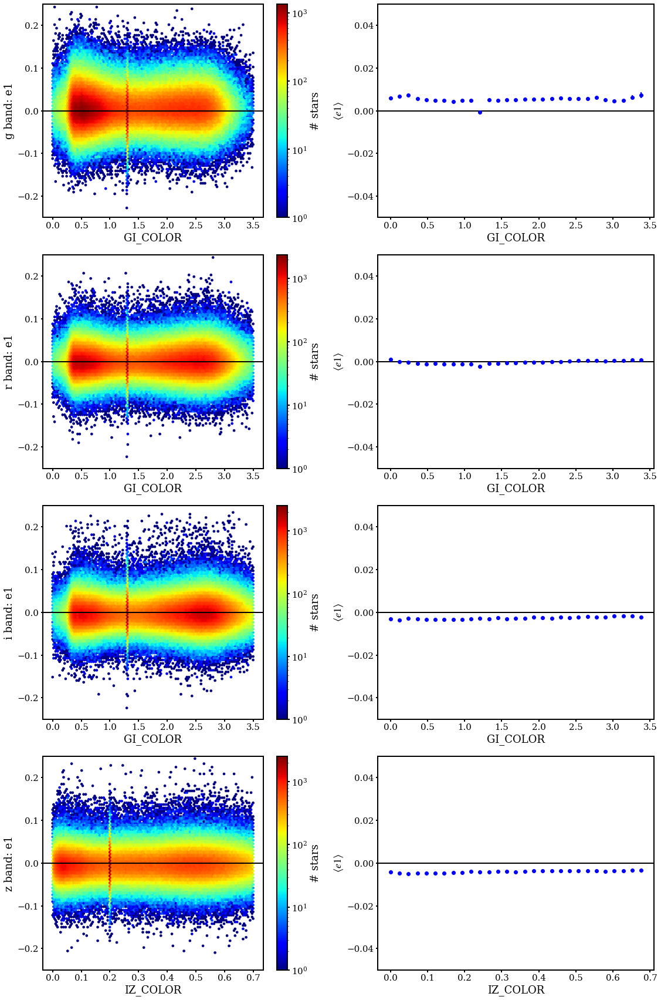

In [67]:
# plot e1 vs. color 2d hist and profile
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    ax = axs[i][0]
    #plot size vs color 2d hist with log density
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
    tmax = 0.25
    mask = (cat['BAND'] == band) & (cat['G1_DATA'] < tmax) & (cat['G1_DATA'] > -tmax)
    chist = cat[color][mask]
    size = cat['G1_DATA'][mask]
    cmap = plt.get_cmap('jet')
    im = ax.hexbin(chist, size, bins='log', mincnt=1, cmap=cmap)
    ax.axhline(0, color='black')
    ax.set_ylim(-tmax, tmax)
    ax.set_ylabel('{} band: e1'.format(band))
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('# stars')
    
    #plot e1 vs color profile
    ax = axs[i][1]
    cbins, Tbins, Tbins_err = make_profile(chist, size, ax, xmax=cmax)
    plot_profile(cbins, Tbins, Tbins_err, ymin=-0.05, ymax=0.05, xlabel=color,
                 ylabel=r'$\left<e1\right>$', plt_zero_line=True)

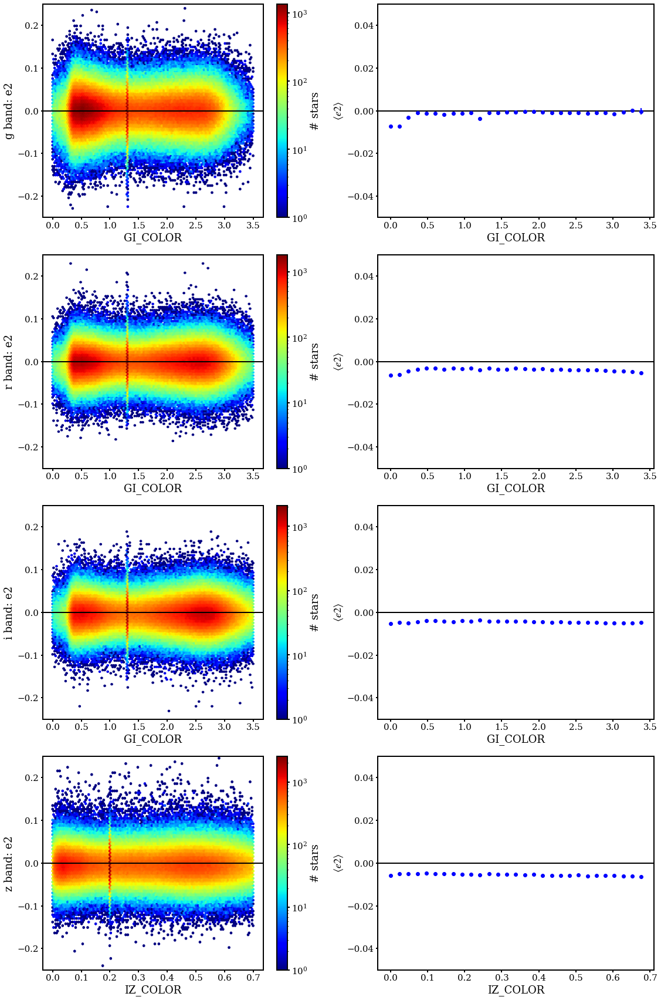

In [68]:
# plot e1 vs. color 2d hist and profile
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    ax = axs[i][0]
    #plot size vs color 2d hist with log density
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
    
    tmax = 0.25
    mask = (cat['BAND'] == band) & (cat['G2_DATA'] < tmax) & (cat['G2_DATA'] > -tmax)
    chist = cat[color][mask]
    size = cat['G2_DATA'][mask]
    cmap = plt.get_cmap('jet')
    im = ax.hexbin(chist, size, bins='log', mincnt=1, cmap=cmap)
    ax.axhline(0, color='black')
    ax.set_ylim(-tmax, tmax)
    ax.set_ylabel('{} band: e2'.format(band))
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('# stars')
    
    #plot e1 vs color profile
    ax = axs[i][1]
    cbins, Tbins, Tbins_err = make_profile(chist, size, ax, xmax=cmax)
    plot_profile(cbins, Tbins, Tbins_err, ymin=-0.05, ymax=0.05, xlabel=color,
                 ylabel=r'$\left<e2\right>$', plt_zero_line=True)

### Plotting shape residuals

### Residuals vs. color

In [12]:
def compute_res(d):
    
    de1 =  d['G1_DATA']-d['G1_MODEL']
    de2 =  d['G2_DATA']-d['G2_MODEL']
    dt =  d['T_DATA']-d['T_MODEL']
    dtfrac = dt/d['T_MODEL']
    print('mean de = ',np.mean(de1),np.mean(de2))
    print('mean dt = ',np.mean(dt))

    return dtfrac, dt, de1, de2

In [11]:
def bin_res_by_color(m, dT, dTfrac, de1, de2, min_edge=0., max_edge=3.5):

    print(band, min_edge, max_edge)
    bins = np.linspace(min_edge, max_edge, 30)
    print('col_bins = ',bins)

    index = np.digitize(m, bins)
    #print('len(index) = ',len(index))
    bin_de1 = [de1[index == i].mean() for i in range(1, len(bins))]
    #print('bin_de1 = ',bin_de1)
    bin_de2 = [de2[index == i].mean() for i in range(1, len(bins))]
    #print('bin_de2 = ',bin_de2)
    bin_dT = [dT[index == i].mean() for i in range(1, len(bins))]
    #print('bin_dT = ',bin_dT)
    bin_dTfrac = [dTfrac[index == i].mean() for i in range(1, len(bins))]
    #print('bin_dTfrac = ',bin_dTfrac)
    bin_de1_err = [ np.sqrt(de1[index == i].var() / len(de1[index == i]))
                    for i in range(1, len(bins)) ]
    #print('bin_de1_err = ',bin_de1_err)
    bin_de2_err = [ np.sqrt(de2[index == i].var() / len(de2[index == i]))
                    for i in range(1, len(bins)) ]
    #print('bin_de2_err = ',bin_de2_err)
    bin_dT_err = [ np.sqrt(dT[index == i].var() / len(dT[index == i]))
                    for i in range(1, len(bins)) ]
    #print('bin_dT_err = ',bin_dT_err)
    bin_dTfrac_err = [ np.sqrt(dTfrac[index == i].var() / len(dTfrac[index == i]))
                    for i in range(1, len(bins)) ]
    #print('bin_dTfrac_err = ',bin_dTfrac_err)

    # Fix up nans
    for i in range(1,len(bins)):
        if i not in index:
            bin_de1[i-1] = 0.
            bin_de2[i-1] = 0.
            bin_dT[i-1] = 0.
            bin_dTfrac[i-1] = 0.
            bin_de1_err[i-1] = 0.
            bin_de2_err[i-1] = 0.
            bin_dT_err[i-1] = 0.
            bin_dTfrac_err[i-1] = 0.
    
    return (min_edge, max_edge, bins, bin_dT, bin_dT_err, bin_dTfrac, 
            bin_dTfrac_err, bin_de1, bin_de1_err, bin_de2, bin_de2_err)

In [12]:
def plot_bin_res(min_edge, max_edge, bins, bin_dT, bin_dT_err, bin_dTfrac, bin_dTfrac_err,
                 bin_de1, bin_de1_err, bin_de2, bin_de2_err, cutlim=None, Tlims=(-0.0075, 0.0075),
                 Tfraclims=(-0.02, 0.02), elims=(-6.e-4,6.e-4), label=None, axes=None):

    ax = axes[0]
    ax.set_title('{} band'.format(band))
    ax.set_ylim(Tlims)
    ax.plot([min_edge,max_edge], [0,0], color='black')
    if cutlim != None:  
        ax.plot([cutlim,cutlim],[-1,1], color='Grey')
        ax.fill( [min_edge,min_edge,cutlim,cutlim], [-1,1,1,-1], fill=True, color='Grey',alpha=0.3)
    t_line = ax.errorbar(bins[:-1], bin_dT, yerr=bin_dT_err, fmt='o', label=label)
    #ax.axhline(y=0.003, linewidth=4, color='grey')
    #ax.legend([t_line], [r'$\delta T$'])
    ax.set_ylabel(r'$(T_{\rm PSF} - T_{\rm model}) \quad({\rm arcsec}^2)$')

    ax = axes[1]
    ax.set_ylim(Tfraclims)
    ax.plot([min_edge,max_edge], [0,0], color='black')
    if cutlim != None:  
        ax.plot([cutlim,cutlim],[-1,1], color='Grey')
        ax.fill( [min_edge,min_edge,cutlim,cutlim], [-1,1,1,-1], fill=True, color='Grey',alpha=0.3)
    tfrac_line = ax.errorbar(bins[:-1], bin_dTfrac, yerr=bin_dTfrac_err, label=label, fmt='o')
    #ax.legend([t_line], [r'$\delta T$'])
    ax.set_ylabel(r'$(T_{\rm PSF} - T_{\rm model})/ T_{\rm model}$')

    ax = axes[2]
    ax.set_ylim(elims)
    ax.plot([min_edge,max_edge], [0,0], color='black')
    if cutlim != None:  
        ax.plot([cutlim,cutlim],[-1,1], color='Grey')
        ax.fill( [min_edge,min_edge,cutlim,cutlim], [-1,1,1,-1], fill=True, color='Grey',alpha=0.3)
    e1_line = ax.errorbar(bins[:-1], bin_de1, yerr=bin_de1_err, label=label, fmt='o')
    e2_line = ax.errorbar(bins[:-1], bin_de2, yerr=bin_de2_err, label=label, fmt='o')
    ax.legend([e1_line, e2_line], [r'$e_1$', r'$e_2$'])
    ax.set_ylabel(r'$e_{\rm PSF} - e_{\rm model}$')
    ax.set_xlim(min_edge,max_edge)
    ax.set_xlabel(color)
    plt.tight_layout()

mean de =  1.9166641941158067e-05 -1.2359034075182122e-05
mean dt =  0.0009150552042360207
g 0.0 3.5
col_bins =  [0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069  1.20689655 1.32758621
 1.44827586 1.56896552 1.68965517 1.81034483 1.93103448 2.05172414
 2.17241379 2.29310345 2.4137931  2.53448276 2.65517241 2.77586207
 2.89655172 3.01724138 3.13793103 3.25862069 3.37931034 3.5       ]
mean de =  -1.9293452955541618e-05 -2.311249713821856e-05
mean dt =  -9.958851543941762e-05
r 0.0 3.5
col_bins =  [0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069  1.20689655 1.32758621
 1.44827586 1.56896552 1.68965517 1.81034483 1.93103448 2.05172414
 2.17241379 2.29310345 2.4137931  2.53448276 2.65517241 2.77586207
 2.89655172 3.01724138 3.13793103 3.25862069 3.37931034 3.5       ]
mean de =  2.2449537608160736e-05 -4.307592668745132e-05
mean dt =  -0.00022477070102926944
i 0.0 3.5

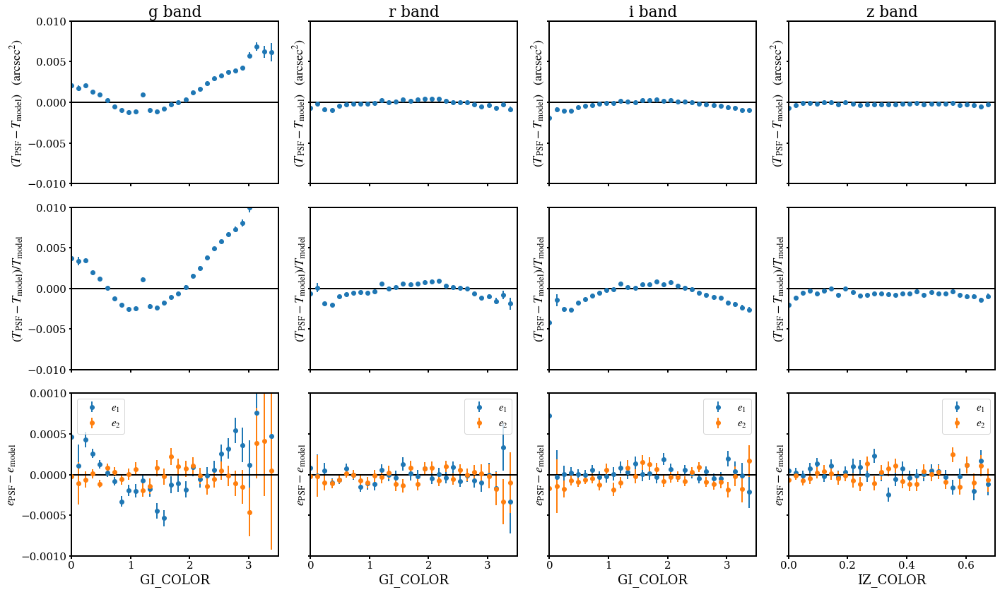

In [21]:
fig, axes = plt.subplots(3,4, figsize=(20,12), sharey='row', sharex='col')
bands = 'griz'
    
for i, band in enumerate(bands):
    data = cat[cat['BAND'] == band]
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
    fracsizeres, sizeres, e1res, e2res = compute_res(data)
    # zeropt = 30.
    # mag = zeropt - 2.5*np.log10(data['FLUX'])
    (min_edge, max_edge, bins, 
    bin_dT, bin_dT_err, 
    bin_dTfrac, bin_dTfrac_err,
    bin_de1, bin_de1_err, 
    bin_de2, bin_de2_err) = bin_res_by_color(data[color], sizeres, fracsizeres, 
                                                  e1res, e2res, max_edge=cmax)
    plot_bin_res(min_edge, max_edge, bins, bin_dT, bin_dT_err, bin_dTfrac,
                     bin_dTfrac_err, bin_de1, bin_de1_err, bin_de2, bin_de2_err,
                     Tlims=(-0.01, 0.01), Tfraclims=(-0.01, 0.01), elims=(-1e-3, 1e-3), axes=axes[:,i])

mean de =  1.9166641941158067e-05 -1.2359034075182122e-05
mean dt =  0.0009150552042360207
Total in band g:  921419
g 0.5 - 1.0asec:  244954 frac:  0.26584431187114654
g 0.0 3.5
col_bins =  [0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069  1.20689655 1.32758621
 1.44827586 1.56896552 1.68965517 1.81034483 1.93103448 2.05172414
 2.17241379 2.29310345 2.4137931  2.53448276 2.65517241 2.77586207
 2.89655172 3.01724138 3.13793103 3.25862069 3.37931034 3.5       ]
g 1.0 - 1.5asec:  591548 frac:  0.6419967463227912
g 0.0 3.5
col_bins =  [0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069  1.20689655 1.32758621
 1.44827586 1.56896552 1.68965517 1.81034483 1.93103448 2.05172414
 2.17241379 2.29310345 2.4137931  2.53448276 2.65517241 2.77586207
 2.89655172 3.01724138 3.13793103 3.25862069 3.37931034 3.5       ]
g 1.5 - 2.0asec:  81656 frac:  0.08861983527580829
g 0.0 3.5
col_

/tmp/ipykernel_3576/4120431168.py:9: RuntimeWarning: Mean of empty slice.
  bin_de1 = [de1[index == i].mean() for i in range(1, len(bins))]
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_3576/4120431168.py:11: RuntimeWarning: Mean of empty slice.
  bin_de2 = [de2[index == i].mean() for i in range(1, len(bins))]
/tmp/ipykernel_3576/4120431168.py:13: RuntimeWarning: Mean of empty slice.
  bin_dT = [dT[index == i].mean() for i in range(1, len(bins))]
/tmp/ipykernel_3576/4120431168.py:15: RuntimeWarning: Mean of empty slice.
  bin_dTfrac = [dTfrac[index == i].mean() for i in range(1, len(bins))]
/tmp/ipykernel_3576/4120431168.py:17: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_de1_err = [ np.sqrt(de1[index == i].var() / len(de1[index == i]))
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-p

mean de =  -1.9293452955541618e-05 -2.311249713821856e-05
mean dt =  -9.958851543941762e-05
Total in band r:  1130428
r 0.5 - 1.0asec:  674740 frac:  0.5968889659491803
r 0.0 3.5
col_bins =  [0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069  1.20689655 1.32758621
 1.44827586 1.56896552 1.68965517 1.81034483 1.93103448 2.05172414
 2.17241379 2.29310345 2.4137931  2.53448276 2.65517241 2.77586207
 2.89655172 3.01724138 3.13793103 3.25862069 3.37931034 3.5       ]
r 1.0 - 1.5asec:  427501 frac:  0.3781762305958451
r 0.0 3.5
col_bins =  [0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069  1.20689655 1.32758621
 1.44827586 1.56896552 1.68965517 1.81034483 1.93103448 2.05172414
 2.17241379 2.29310345 2.4137931  2.53448276 2.65517241 2.77586207
 2.89655172 3.01724138 3.13793103 3.25862069 3.37931034 3.5       ]
r 1.5 - 2.0asec:  25355 frac:  0.022429557654269003
r 0.0 3.5
co

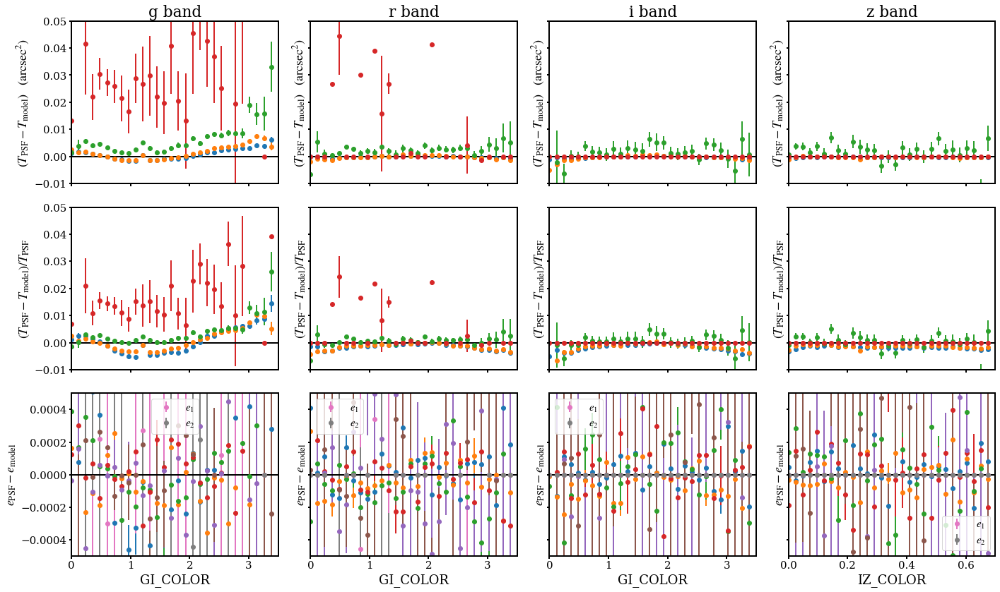

In [73]:
fig, axes = plt.subplots(3,4, figsize=(20,12), sharey='row', sharex='col')
tlims = [(0,0.6), (0.6,1.0), (1.0, 1.5), (1.5, 2.5)]
fwhmlims = [(0.5, 1.0), (1.0, 1.5), (1.5, 2.0), (2.0, 3.0)]
for i, band in enumerate(bands):
    data = cat[cat['BAND'] == band]
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
    fracsizeres, sizeres, e1res, e2res = compute_res(data)
    # zeropt = 30.
    # mag = zeropt - 2.5*np.log10(data['FLUX'])
    print('Total in band {}: '.format(band), len(data))
    for lims in fwhmlims:
        t_cut = np.logical_and(data['PSF_FWHM'] > lims[0], data['PSF_FWHM'] < lims[1])
        data_cut = data[t_cut]
        # mag_cut = mag[t_cut]
        fracsizeres_cut = fracsizeres[t_cut]
        sizeres_cut = sizeres[t_cut]
        e1res_cut = e1res[t_cut]
        e2res_cut = e2res[t_cut]

        print(band, '{} - {}asec: '.format(lims[0],lims[1]), len(data_cut), 'frac: ', len(data_cut)/len(data))
        (min_edge, max_edge, bins, 
         bin_dT, bin_dT_err, 
         bin_dTfrac, bin_dTfrac_err,
         bin_de1, bin_de1_err, 
         bin_de2, bin_de2_err) = bin_res_by_color(data_cut[color], sizeres_cut, fracsizeres_cut, 
                                                  e1res_cut, e2res_cut, max_edge=cmax)
        plot_bin_res(min_edge, max_edge, bins, bin_dT, bin_dT_err, bin_dTfrac,
                     bin_dTfrac_err, bin_de1, bin_de1_err, bin_de2, bin_de2_err,
                     Tlims=(-0.01, 0.05), Tfraclims=(-0.01, 0.05), elims=(-0.5e-3, 0.5e-3), axes=axes[:,i])

In [22]:
def plot_2d_res(ind_var, dT, dTfrac, de1, de2, min_edge=0., max_edge=3.5, 
                Tlims=(-0.0075, 0.0075), Tfraclims=(-0.02, 0.02), xaxis='Magnitude',
                elims=(-6.e-4,6.e-4), band=None, axes=None, binscale='log'):
    vmin=1
    vmax=5000
    # if band == 'z':
    #     color='IZ_COLOR'
    # else:
    #     color='GI_COLOR'
    ax = axes[0]
    cmap = plt.get_cmap('jet')
    ax.set_title('{} band'.format(band))
    ax.set_ylim(Tlims)
    im = ax.hexbin(ind_var, dT, mincnt=1, cmap=cmap, vmin=vmin, vmax=vmax,
                   extent=(min_edge, max_edge, Tlims[0], Tlims[1]), bins=binscale)
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
    ax.plot([min_edge,max_edge], [0,0], color='black', alpha=0.5)
    ax.set_ylabel(r'$(T_{\rm PSF} - T_{\rm model}) \quad({\rm arcsec}^2)$')

    ax = axes[1]
    ax.set_xlim(min_edge,max_edge)
    ax.set_ylim(Tfraclims)
    im = ax.hexbin(ind_var, dTfrac, mincnt=1, cmap=cmap, vmin=vmin, vmax=vmax,
                   extent=(min_edge, max_edge, Tfraclims[0], Tfraclims[1]), bins=binscale)
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
    ax.plot([min_edge,max_edge], [0,0], color='black', alpha=0.5)
    ax.set_ylabel(r'$(T_{\rm PSF} - T_{\rm model})/ T_{\rm model}$')

    ax = axes[2]
    ax.set_xlim(min_edge,max_edge)
    ax.set_ylim(elims)
    im = ax.hexbin(ind_var, de1, mincnt=1, cmap=cmap, vmin=vmin, vmax=vmax,
                   extent=(min_edge, max_edge, elims[0], elims[1]), bins=binscale)
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
    ax.plot([min_edge,max_edge], [0,0], color='black', alpha=0.5)
    ax.set_ylabel(r'$e_{1, \rm PSF} - e_{1, \rm model}$')
    # ax.set_xlabel(color)
    
    ax = axes[3]
    ax.set_xlim(min_edge,max_edge)
    ax.set_ylim(elims)
    im = ax.hexbin(ind_var, de2, mincnt=1, cmap=cmap, vmin=vmin, vmax=vmax,
                   extent=(min_edge, max_edge, elims[0], elims[1]), bins=binscale)
    #ax.axhline(y=0.0002, linewidth=4, color='grey')
    #ax.axhline(y=-0.0002, linewidth=4, color='grey')
    #ax.legend()
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
    ax.plot([min_edge,max_edge], [0,0], color='black', alpha=0.5)
    ax.set_ylabel(r'$e_{2,\rm PSF} - e_{2,\rm model}$')
    ax.set_xlabel(xaxis)
    plt.tight_layout()

/tmp/ipykernel_3576/2215085701.py:14: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(ind_var, dT, mincnt=1, cmap=cmap, vmin=vmin, vmax=vmax,
/tmp/ipykernel_3576/2215085701.py:24: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(ind_var, dTfrac, mincnt=1, cmap=cmap, vmin=vmin, vmax=vmax,
/tmp/ipykernel_3576/2215085701.py:34: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(ind_var, de1, mincnt=1, cmap=cmap, vmin=vmin, vmax=vmax,
/tmp/

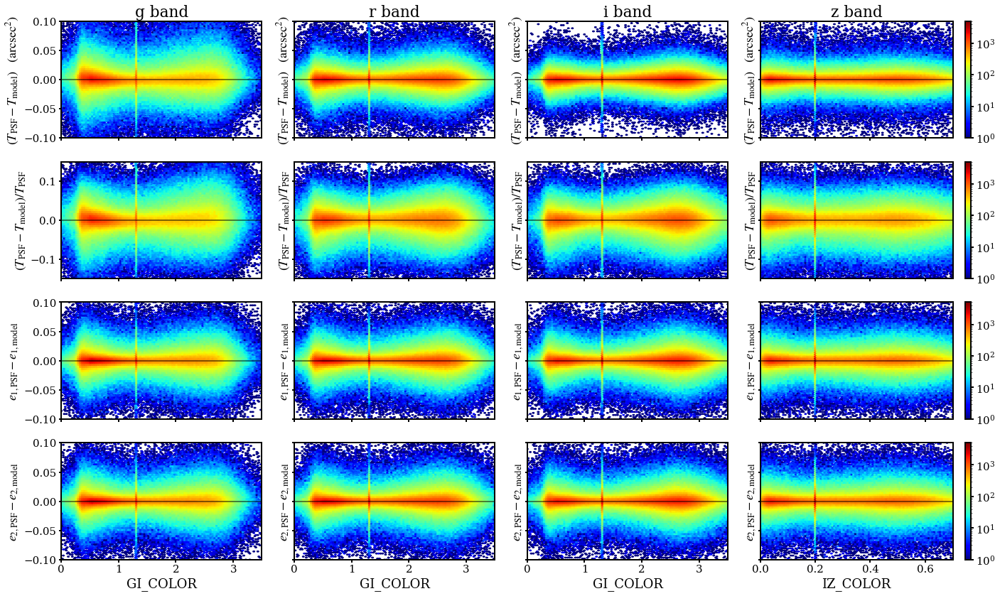

In [75]:
fig, axes = plt.subplots(4,4, figsize=(20,12), sharey='row', sharex='col', gridspec_kw={'width_ratios': [1,1,1,1.2]})

for i, band in enumerate(bands):
    data = cat[cat['BAND'] == band]
    if band == 'z':
        color = 'IZ_COLOR'
        max_edge = 0.7
    else:
        color = 'GI_COLOR'
        max_edge = 3.5
    plot_2d_res(data[color], data['T_DATA']-data['T_MODEL'], (data['T_DATA']-data['T_MODEL'])/data['T_DATA'],
                data['G1_DATA']-data['G1_MODEL'], data['G2_DATA']-data['G2_MODEL'], max_edge=max_edge, 
                Tlims=(-0.1, 0.1), Tfraclims=(-0.15, 0.15), elims=(-0.1, 0.1), xaxis=color, band=band, axes=axes[:,i])

### Residuals vs. Magnitude

/tmp/ipykernel_3576/3274996165.py:8: RuntimeWarning: invalid value encountered in log10
  mag = zeropt - 2.5*np.log10(data['FLUX'])


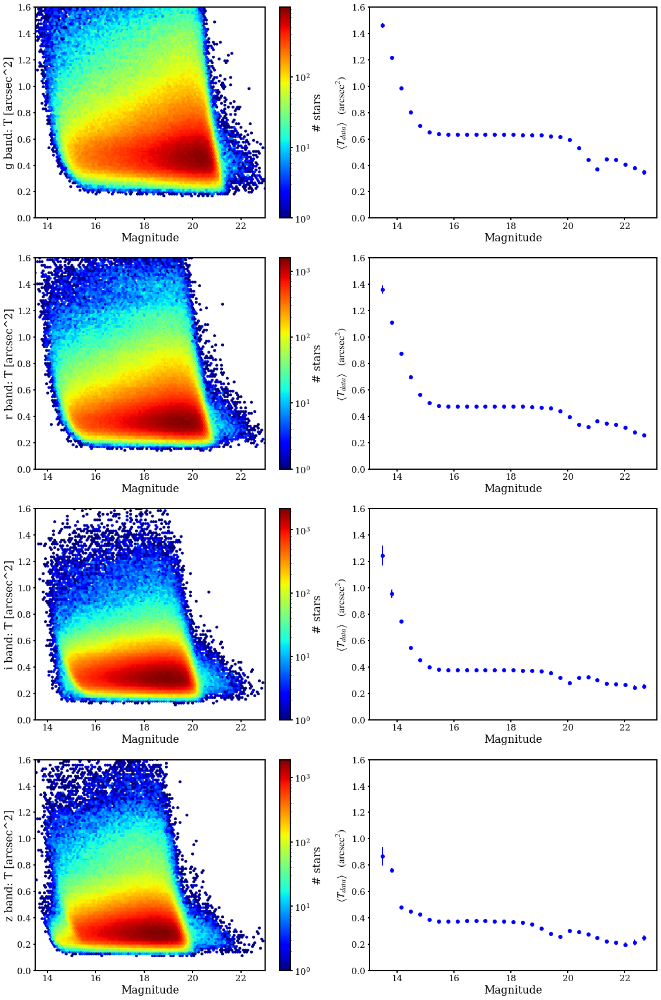

In [76]:
#plot size vs. color 2d hist and profile
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    ax = axs[i][0]
    data = cat[cat['BAND'] == band]
    #plot size vs color 2d hist with log density
    zeropt = 30.
    mag = zeropt - 2.5*np.log10(data['FLUX'])
    mmin = 13.5
    mmax = 23.
    mmask = np.logical_and(mag > mmin, mag < mmax)
    mag = mag[mmask]
    data = data[mmask]
    size = data['T_DATA']
    cmap = plt.get_cmap('jet')
    tmax = 1.6
    im = ax.hexbin(mag, size, bins='log', mincnt=1, cmap=cmap, extent=(mmin, mmax, 0.,tmax))
    ax.set_ylim(0., tmax)
    ax.set_xlim(mmin, mmax)
    ax.set_ylabel('{} band: T [arcsec^2]'.format(band))
    ax.set_xlabel('Magnitude')
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('# stars')
    
    ax = axs[i][1]
    x_bins, bin_shape, bin_shape_err = make_profile(mag, size, ax, xmin=mmin, xmax=mmax, nbins=30)
    plot_profile(x_bins, bin_shape, bin_shape_err, ymin=0., ymax=1.6, plt_zero_line=True,
                 xlabel = 'Magnitude', ylabel=r'$\left<T_{data}\right> \quad({\rm arcsec}^2)$')

/tmp/ipykernel_3576/1917349598.py:8: RuntimeWarning: invalid value encountered in log10
  mag = zeropt - 2.5*np.log10(data['FLUX'])


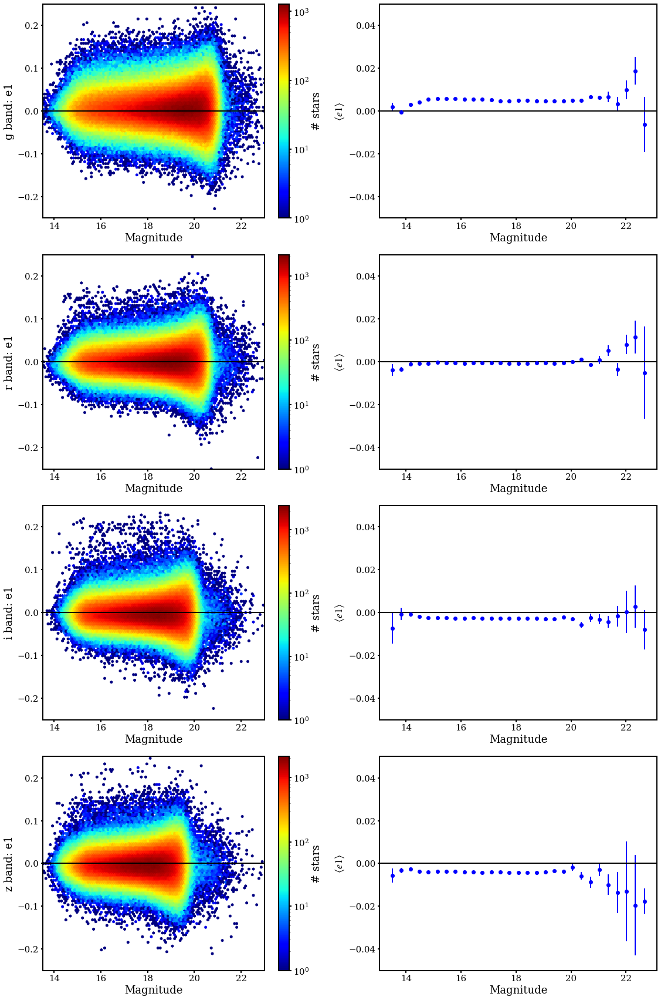

In [77]:
#plot size vs. color 2d hist and profile
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    ax = axs[i][0]
    data = cat[cat['BAND'] == band]
    #plot size vs color 2d hist with log density
    zeropt = 30.
    mag = zeropt - 2.5*np.log10(data['FLUX'])
    mmin = 13.5
    mmax = 23.
    mmask = np.logical_and(mag > mmin, mag < mmax)
    mag = mag[mmask]
    data = data[mmask]
    size = data['G1_DATA']
    cmap = plt.get_cmap('jet')
    emin = -0.25
    emax = 0.25
    im = ax.hexbin(mag, size, bins='log', mincnt=1, cmap=cmap, extent=(mmin, mmax, emin, emax))
    ax.axhline(0, color='k')
    ax.set_ylim(emin, emax)
    ax.set_xlim(mmin, mmax)
    ax.set_ylabel('{} band: e1'.format(band))
    ax.set_xlabel('Magnitude')
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('# stars')
    
    
    ax = axs[i][1]
    x_bins, bin_shape, bin_shape_err = make_profile(mag, size, ax, xmin=mmin, xmax=mmax, nbins=30)
    plot_profile(x_bins, bin_shape, bin_shape_err, ymin=-0.05, ymax=0.05, plt_zero_line=True,
                 xlabel = 'Magnitude', ylabel=r'$\left<e1\right>$')

/tmp/ipykernel_3576/1239028785.py:8: RuntimeWarning: invalid value encountered in log10
  mag = zeropt - 2.5*np.log10(data['FLUX'])


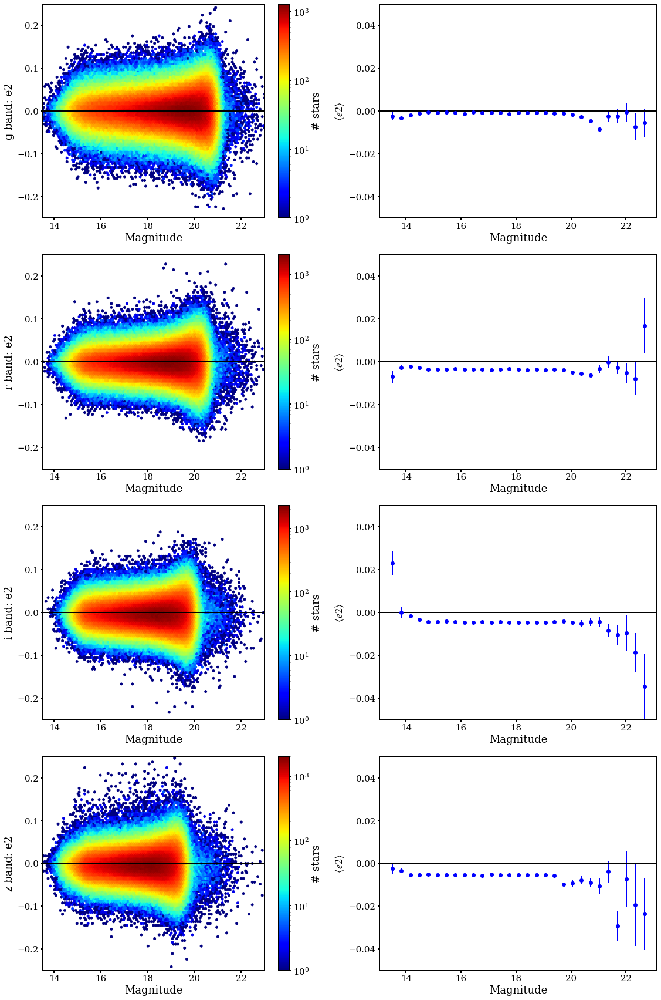

In [78]:
#plot size vs. color 2d hist and profile
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    ax = axs[i][0]
    data = cat[cat['BAND'] == band]
    #plot size vs color 2d hist with log density
    zeropt = 30.
    mag = zeropt - 2.5*np.log10(data['FLUX'])
    mmin = 13.5
    mmax = 23.
    mmask = np.logical_and(mag > mmin, mag < mmax)
    mag = mag[mmask]
    data = data[mmask]
    size = data['G2_DATA']
    cmap = plt.get_cmap('jet')
    emin = -0.25
    emax = 0.25
    im = ax.hexbin(mag, size, bins='log', mincnt=1, cmap=cmap, extent=(mmin, mmax, emin, emax))
    ax.axhline(0, color='k')
    ax.set_ylim(emin, emax)
    ax.set_xlim(mmin, mmax)
    ax.set_ylabel('{} band: e2'.format(band))
    ax.set_xlabel('Magnitude')
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('# stars')
    
    
    ax = axs[i][1]
    x_bins, bin_shape, bin_shape_err = make_profile(mag, size, ax, xmin=mmin, xmax=mmax, nbins=30)
    plot_profile(x_bins, bin_shape, bin_shape_err, ymin=-0.05, ymax=0.05, plt_zero_line=True,
                 xlabel = 'Magnitude', ylabel=r'$\left<e2\right>$')

In [23]:
def bin_by_mag(m, dT, dTfrac, de1, de2, mmin=15., mmax=21., min_mused=16.5, 
               label=None, axes=None, xlabel='Magnitude', tlims=(-0.0075, 0.0075),
               tfraclims=(-0.02, 0.02), elims=(-6.e-4,6.e-4)):
    min_mag = mmin
    max_mag = mmax
    print(band, min_mag, max_mag)
    mag_bins = np.linspace(min_mag, max_mag,30)
    #print('col_bins = ',mag_bins)

    index = np.digitize(m, mag_bins)
    #print('len(index) = ',len(index))
    bin_de1 = [de1[index == i].mean() for i in range(1, len(mag_bins))]
    #print('bin_de1 = ',bin_de1)
    bin_de2 = [de2[index == i].mean() for i in range(1, len(mag_bins))]
    #print('bin_de2 = ',bin_de2)
    bin_dT = [dT[index == i].mean() for i in range(1, len(mag_bins))]
    #print('bin_dT = ',bin_dT)
    bin_dTfrac = [dTfrac[index == i].mean() for i in range(1, len(mag_bins))]
    #print('bin_dTfrac = ',bin_dTfrac)
    bin_de1_err = [ np.sqrt(de1[index == i].var() / len(de1[index == i]))
                    for i in range(1, len(mag_bins)) ]
    #print('bin_de1_err = ',bin_de1_err)
    bin_de2_err = [ np.sqrt(de2[index == i].var() / len(de2[index == i]))
                    for i in range(1, len(mag_bins)) ]
    #print('bin_de2_err = ',bin_de2_err)
    bin_dT_err = [ np.sqrt(dT[index == i].var() / len(dT[index == i]))
                    for i in range(1, len(mag_bins)) ]
    #print('bin_dT_err = ',bin_dT_err)
    bin_dTfrac_err = [ np.sqrt(dTfrac[index == i].var() / len(dTfrac[index == i]))
                    for i in range(1, len(mag_bins)) ]
    #print('bin_dTfrac_err = ',bin_dTfrac_err)

    # Fix up nans
    for i in range(1,len(mag_bins)):
        if i not in index:
            bin_de1[i-1] = 0.
            bin_de2[i-1] = 0.
            bin_dT[i-1] = 0.
            bin_dTfrac[i-1] = 0.
            bin_de1_err[i-1] = 0.
            bin_de2_err[i-1] = 0.
            bin_dT_err[i-1] = 0.
            bin_dTfrac_err[i-1] = 0.

    ax = axes[0]
    ax.set_title('{} band'.format(band))
    ax.set_ylim(tlims)
    ax.plot([min_mag,max_mag], [0,0], color='black')
    ax.plot([min_mused,min_mused],[-1,1], color='Grey')
    ax.fill( [min_mag,min_mag,min_mused,min_mused], [-1,1,1,-1], fill=True, color='Grey',alpha=0.1)
    #t_line = ax.errorbar(mag_bins[:-1], bin_dT, yerr=bin_dT_err, color='blue', fmt='o')
    t_line = ax.errorbar(mag_bins[:-1], bin_dT, yerr=bin_dT_err, label=label, fmt='o')
    #ax.axhline(y=0.003, linewidth=4, color='grey')
    #ax.legend([t_line], [r'$\delta T$'])
    ax.set_ylabel(r'$(T_{\rm PSF} - T_{\rm model}) \quad({\rm arcsec}^2)$')

    ax = axes[1]
    ax.set_ylim(tfraclims)
    ax.plot([min_mag,max_mag], [0,0], color='black')
    ax.plot([min_mused,min_mused],[-1,1], color='Grey')
    ax.fill( [min_mag,min_mag,min_mused,min_mused], [-1,1,1,-1], fill=True, color='Grey',alpha=0.1)
    #t_line = ax.errorbar(mag_bins[:-1], bin_dTfrac, yerr=bin_dTfrac_err, color='blue', fmt='o')
    t_line = ax.errorbar(mag_bins[:-1], bin_dTfrac, yerr=bin_dTfrac_err, label=label, fmt='o')
    #ax.legend([t_line], [r'$\delta T$'])
    # ax.legend(ncol=2, columnspacing=0.5)
    ax.set_ylabel(r'$(T_{\rm PSF} - T_{\rm model})/ T_{\rm model}$')

    ax = axes[2]
    ax.set_ylim(elims)
    ax.plot([min_mag,max_mag], [0,0], color='black')
    ax.plot([min_mused,min_mused],[-1,1], color='Grey')
    ax.fill( [min_mag,min_mag,min_mused,min_mused], [-1,1,1,-1], fill=True, color='Grey',alpha=0.1)
    # e1_line = ax.errorbar(mag_bins[:-1], bin_de1, yerr=bin_de1_err, color='red', mfc='white', fmt='o')
    # e2_line = ax.errorbar(mag_bins[:-1], bin_de2, yerr=bin_de2_err, color='blue', fmt='o')
    e1_line = ax.errorbar(mag_bins[:-1], bin_de1, yerr=bin_de1_err, mfc='white', fmt='o', label=label)
    e2_line = ax.errorbar(mag_bins[:-1], bin_de2, yerr=bin_de2_err, fmt='o', label=label)
    #ax.axhline(y=0.0002, linewidth=4, color='grey')
    #ax.axhline(y=-0.0002, linewidth=4, color='grey')
    #ax.legend(ncol=2, columnspacing=0.5)
    ax.legend([e1_line, e2_line], [r'$e_1$', r'$e_2$'], loc='lower left')
    ax.set_ylabel(r'$e_{\rm PSF} - e_{\rm model}$')
    ax.set_xlim(min_mag,max_mag)
    ax.set_xlabel(xlabel)
    plt.tight_layout()

mean de =  1.9166641941158067e-05 -1.2359034075182122e-05
mean dt =  0.0009150552042360207
Total in band:  921419
g 15.0 21.0
mean de =  -1.9293452955541618e-05 -2.311249713821856e-05
mean dt =  -9.958851543941762e-05
Total in band:  1130428
r 15.0 21.0
mean de =  2.2449537608160736e-05 -4.307592668745132e-05
mean dt =  -0.00022477070102926944
Total in band:  1188171
i 15.0 21.0
mean de =  1.6281142681137398e-05 -1.2188384645438633e-05
mean dt =  -0.00022156100935947386
Total in band:  1062461
z 15.0 21.0


/tmp/ipykernel_16328/3416957456.py:7: RuntimeWarning: invalid value encountered in log10
  mag = zeropt - 2.5*np.log10(data['FLUX'])


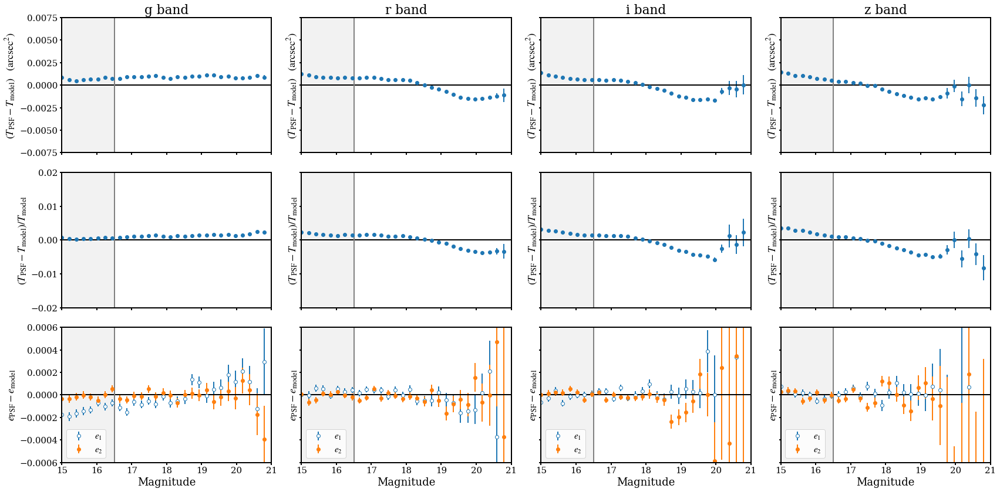

In [24]:
fig, axes = plt.subplots(3,4, figsize=(24,12), sharey='row', sharex='col')
# tlims = [(0,0.6), (0.6,1.0), (1.0, 1.5), (1.5, 2.5)]
for i, band in enumerate(bands):
    data = cat[cat['BAND'] == band]
    fracsizeres, sizeres, e1res, e2res = compute_res(data)
    zeropt = 30.
    mag = zeropt - 2.5*np.log10(data['FLUX'])
    print('Total in band: ', len(data))

    bin_by_mag(mag, sizeres, fracsizeres, e1res, e2res, axes=axes[:,i])

mean de =  1.9166641941158067e-05 -1.2359034075182122e-05
mean dt =  0.0009150552042360207
Total in band:  921419
g 0.5 - 1.0asec:  244954 frac:  0.26584431187114654
g 15.0 21.0
g 1.0 - 1.5asec:  591548 frac:  0.6419967463227912
g 15.0 21.0
g 1.5 - 2.0asec:  81656 frac:  0.08861983527580829
g 15.0 21.0
mean de =  -1.9293452955541618e-05 -2.311249713821856e-05
mean dt =  -9.958851543941762e-05
Total in band:  1130428
r 0.5 - 1.0asec:  674740 frac:  0.5968889659491803
r 15.0 21.0
r 1.0 - 1.5asec:  427501 frac:  0.3781762305958451
r 15.0 21.0
r 1.5 - 2.0asec:  25355 frac:  0.022429557654269003
r 15.0 21.0
mean de =  2.2449537608160736e-05 -4.307592668745132e-05
mean dt =  -0.00022477070102926944
Total in band:  1188171
i 0.5 - 1.0asec:  959828 frac:  0.8078197498508212
i 15.0 21.0
i 1.0 - 1.5asec:  221797 frac:  0.18667094214553293
i 15.0 21.0
i 1.5 - 2.0asec:  4671 frac:  0.003931252319741855
i 15.0 21.0


/tmp/ipykernel_3576/992732953.py:12: RuntimeWarning: Mean of empty slice.
  bin_de1 = [de1[index == i].mean() for i in range(1, len(mag_bins))]
/tmp/ipykernel_3576/992732953.py:14: RuntimeWarning: Mean of empty slice.
  bin_de2 = [de2[index == i].mean() for i in range(1, len(mag_bins))]
/tmp/ipykernel_3576/992732953.py:16: RuntimeWarning: Mean of empty slice.
  bin_dT = [dT[index == i].mean() for i in range(1, len(mag_bins))]
/tmp/ipykernel_3576/992732953.py:18: RuntimeWarning: Mean of empty slice.
  bin_dTfrac = [dTfrac[index == i].mean() for i in range(1, len(mag_bins))]
/tmp/ipykernel_3576/992732953.py:20: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_de1_err = [ np.sqrt(de1[index == i].var() / len(de1[index == i]))
/tmp/ipykernel_3576/992732953.py:23: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_de2_err = [ np.sqrt(de2[index == i].var() / len(de2[index == i]))
/tmp/ipykernel_3576/992732953.py:26: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_dT_err = 

mean de =  1.6281142681137398e-05 -1.2188384645438633e-05
mean dt =  -0.00022156100935947386
Total in band:  1062461
z 0.5 - 1.0asec:  863959 frac:  0.8131677303919862
z 15.0 21.0


/tmp/ipykernel_3576/3916980135.py:8: RuntimeWarning: invalid value encountered in log10
  mag = zeropt - 2.5*np.log10(data['FLUX'])


z 1.0 - 1.5asec:  188556 frac:  0.17747098481732507
z 15.0 21.0
z 1.5 - 2.0asec:  8509 frac:  0.008008764557004916
z 15.0 21.0


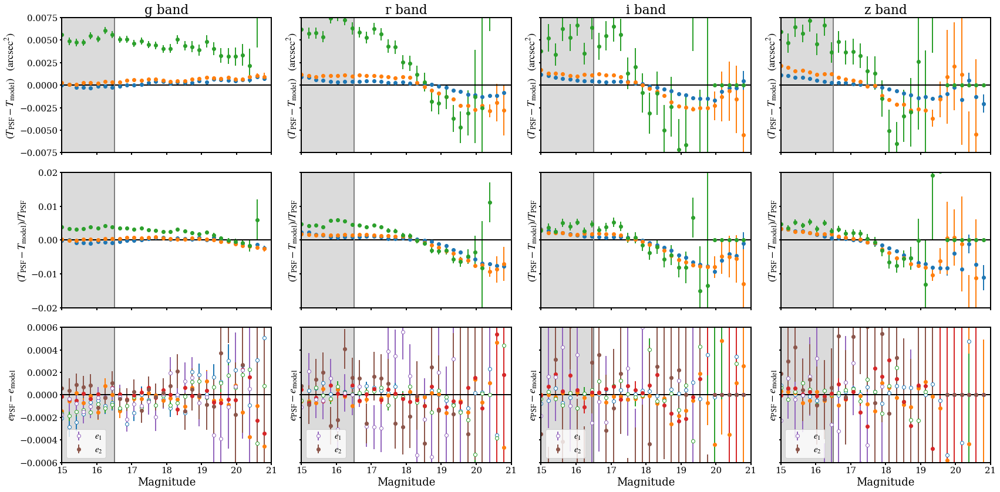

In [83]:
fig, axes = plt.subplots(3,4, figsize=(24,12), sharey='row', sharex='col')
tlims = [(0,0.6), (0.6,1.0), (1.0, 1.5)]
fwhmlims = [(0.5, 1.0), (1.0, 1.5), (1.5, 2.0)]
for i, band in enumerate(bands):
    data = cat[cat['BAND'] == band]
    fracsizeres, sizeres, e1res, e2res = compute_res(data)
    zeropt = 30.
    mag = zeropt - 2.5*np.log10(data['FLUX'])
    print('Total in band: ', len(data))
    for lims in fwhmlims:
        t_cut = np.logical_and(data['PSF_FWHM'] > lims[0], data['PSF_FWHM'] < lims[1])
        mag_cut = mag[t_cut]
        fracsizeres_cut = fracsizeres[t_cut]
        sizeres_cut = sizeres[t_cut]
        e1res_cut = e1res[t_cut]
        e2res_cut = e2res[t_cut]

        print(band, '{} - {}asec: '.format(lims[0],lims[1]), len(mag_cut), 'frac: ', len(mag_cut)/len(data))
        bin_by_mag(mag_cut, sizeres_cut, fracsizeres_cut, e1res_cut, e2res_cut, axes=axes[:,i], label=str(lims))

/tmp/ipykernel_3576/2215085701.py:14: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(ind_var, dT, mincnt=1, cmap=cmap, vmin=vmin, vmax=vmax,
/tmp/ipykernel_3576/2215085701.py:24: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(ind_var, dTfrac, mincnt=1, cmap=cmap, vmin=vmin, vmax=vmax,
/tmp/ipykernel_3576/2215085701.py:34: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(ind_var, de1, mincnt=1, cmap=cmap, vmin=vmin, vmax=vmax,
/tmp/

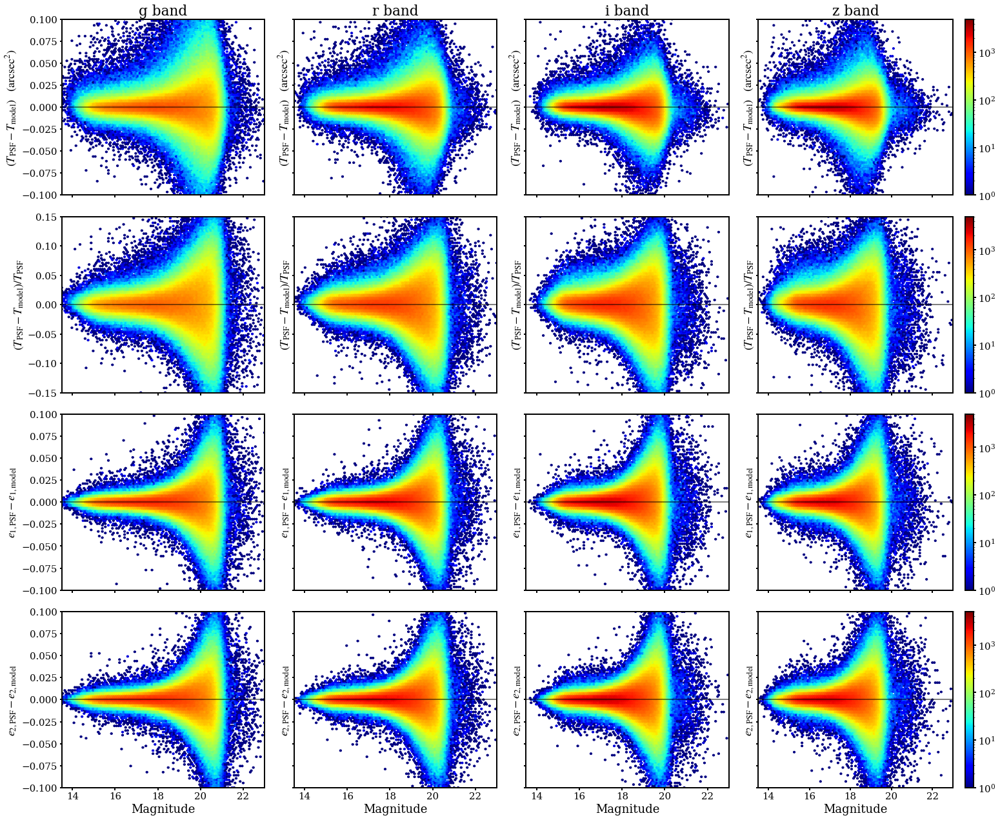

In [84]:
fig, axes = plt.subplots(4,4, figsize=(22,18), sharey='row', sharex='col', gridspec_kw={'width_ratios': [1,1,1,1.2]})

for i, band in enumerate(bands):
    data = cat[cat['BAND'] == band]
    zeropt = 30.
    mag = zeropt - 2.5*np.log10(data['FLUX'])
    plot_2d_res(mag, data['T_DATA']-data['T_MODEL'], (data['T_DATA']-data['T_MODEL'])/data['T_DATA'],
                data['G1_DATA']-data['G1_MODEL'], data['G2_DATA']-data['G2_MODEL'], min_edge=13.5,
                max_edge=23., Tlims=(-0.1, 0.1), Tfraclims=(-0.15, 0.15), elims=(-0.1, 0.1), 
                band=band, axes=axes[:,i])

mean de =  1.9166641941158067e-05 -1.2359034075182122e-05
mean dt =  0.0009150552042360207
Total in band:  921419
g 0.3 1.8


/tmp/ipykernel_3576/992732953.py:12: RuntimeWarning: Mean of empty slice.
  bin_de1 = [de1[index == i].mean() for i in range(1, len(mag_bins))]
/tmp/ipykernel_3576/992732953.py:14: RuntimeWarning: Mean of empty slice.
  bin_de2 = [de2[index == i].mean() for i in range(1, len(mag_bins))]
/tmp/ipykernel_3576/992732953.py:16: RuntimeWarning: Mean of empty slice.
  bin_dT = [dT[index == i].mean() for i in range(1, len(mag_bins))]
/tmp/ipykernel_3576/992732953.py:18: RuntimeWarning: Mean of empty slice.
  bin_dTfrac = [dTfrac[index == i].mean() for i in range(1, len(mag_bins))]
/tmp/ipykernel_3576/992732953.py:20: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_de1_err = [ np.sqrt(de1[index == i].var() / len(de1[index == i]))
/tmp/ipykernel_3576/992732953.py:23: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_de2_err = [ np.sqrt(de2[index == i].var() / len(de2[index == i]))
/tmp/ipykernel_3576/992732953.py:26: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_dT_err = 

mean de =  -1.9293452955541618e-05 -2.311249713821856e-05
mean dt =  -9.958851543941762e-05
Total in band:  1130428
r 0.3 1.8
mean de =  2.2449537608160736e-05 -4.307592668745132e-05
mean dt =  -0.00022477070102926944
Total in band:  1188171
i 0.3 1.8
mean de =  1.6281142681137398e-05 -1.2188384645438633e-05
mean dt =  -0.00022156100935947386
Total in band:  1062461
z 0.3 1.8


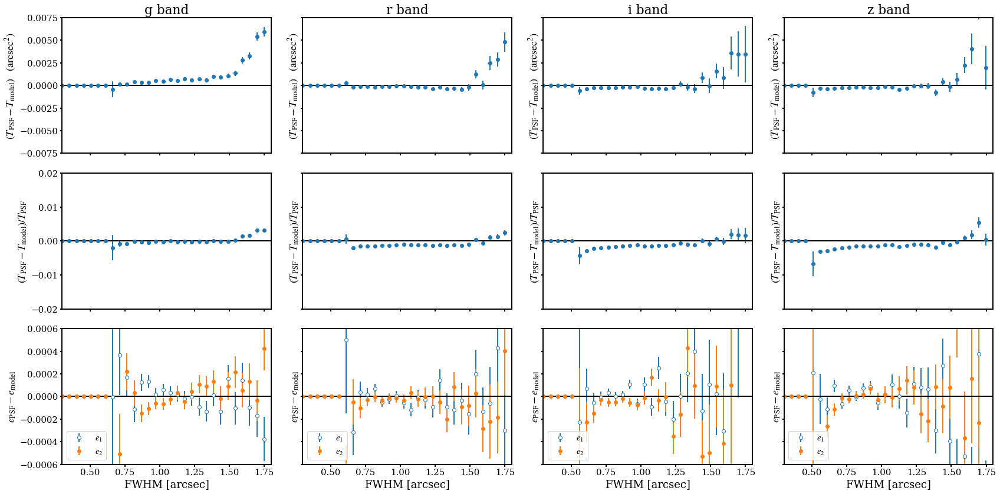

In [85]:
fig, axes = plt.subplots(3,4, figsize=(24,12), sharey='row', sharex='col')
for i, band in enumerate(bands):
    data = cat[cat['BAND'] == band]
    fracsizeres, sizeres, e1res, e2res = compute_res(data)
    print('Total in band: ', len(data))

    bin_by_mag(data['PSF_FWHM'], sizeres, fracsizeres, e1res, e2res, mmin=0.3, mmax=1.8, min_mused=0, 
               axes=axes[:,i], xlabel='FWHM [arcsec]')

mean de =  1.9166641941158067e-05 -1.2359034075182122e-05
mean dt =  0.0009150552042360207
Total in band:  921419
g 0.0 1.8


/tmp/ipykernel_3576/992732953.py:12: RuntimeWarning: Mean of empty slice.
  bin_de1 = [de1[index == i].mean() for i in range(1, len(mag_bins))]
/tmp/ipykernel_3576/992732953.py:14: RuntimeWarning: Mean of empty slice.
  bin_de2 = [de2[index == i].mean() for i in range(1, len(mag_bins))]
/tmp/ipykernel_3576/992732953.py:16: RuntimeWarning: Mean of empty slice.
  bin_dT = [dT[index == i].mean() for i in range(1, len(mag_bins))]
/tmp/ipykernel_3576/992732953.py:18: RuntimeWarning: Mean of empty slice.
  bin_dTfrac = [dTfrac[index == i].mean() for i in range(1, len(mag_bins))]
/tmp/ipykernel_3576/992732953.py:20: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_de1_err = [ np.sqrt(de1[index == i].var() / len(de1[index == i]))
/tmp/ipykernel_3576/992732953.py:23: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_de2_err = [ np.sqrt(de2[index == i].var() / len(de2[index == i]))
/tmp/ipykernel_3576/992732953.py:26: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_dT_err = 

mean de =  -1.9293452955541618e-05 -2.311249713821856e-05
mean dt =  -9.958851543941762e-05
Total in band:  1130428
r 0.0 1.8
mean de =  2.2449537608160736e-05 -4.307592668745132e-05
mean dt =  -0.00022477070102926944
Total in band:  1188171
i 0.0 1.8
mean de =  1.6281142681137398e-05 -1.2188384645438633e-05
mean dt =  -0.00022156100935947386
Total in band:  1062461
z 0.0 1.8


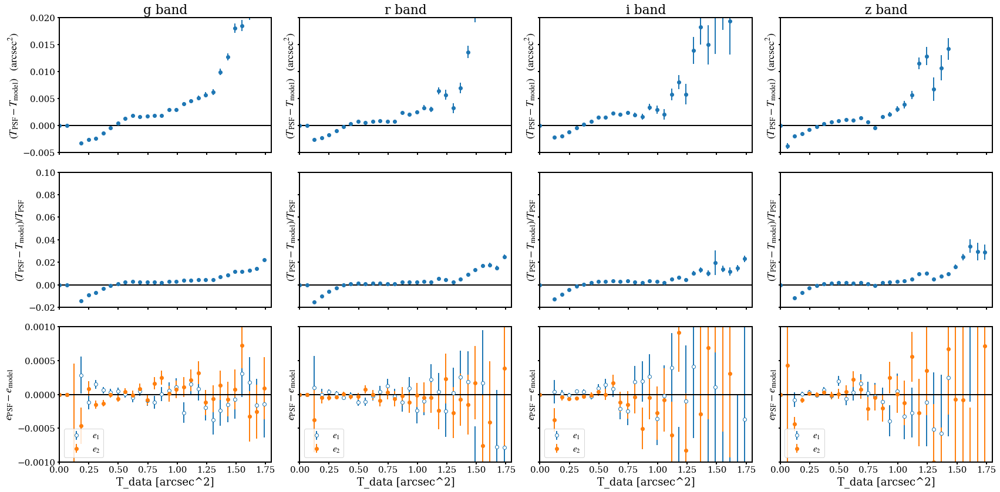

In [86]:
fig, axes = plt.subplots(3,4, figsize=(24,12), sharey='row', sharex='col')
for i, band in enumerate(bands):
    data = cat[cat['BAND'] == band]
    fracsizeres, sizeres, e1res, e2res = compute_res(data)
    print('Total in band: ', len(data))

    bin_by_mag(data['T_DATA'], sizeres, fracsizeres, e1res, e2res, mmin=0., mmax=1.8, min_mused=0,
               axes=axes[:,i], tlims=(-0.005, 0.02), tfraclims=(-0.02,0.1), elims=(-0.001, 0.001),
               xlabel='T_data [arcsec^2]')

### cutting FWHM>1.5asec

In [87]:
cat2 = cat[cat['PSF_FWHM'] < 1.5]

mean de =  2.682542887180489e-05 -2.4268462076125452e-05
mean dt =  0.0005527913761112237
g 0.0 3.5
col_bins =  [0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069  1.20689655 1.32758621
 1.44827586 1.56896552 1.68965517 1.81034483 1.93103448 2.05172414
 2.17241379 2.29310345 2.4137931  2.53448276 2.65517241 2.77586207
 2.89655172 3.01724138 3.13793103 3.25862069 3.37931034 3.5       ]
mean de =  -1.8900326796272567e-05 -2.1919689987174433e-05
mean dt =  -0.00015352512373764652
r 0.0 3.5
col_bins =  [0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069  1.20689655 1.32758621
 1.44827586 1.56896552 1.68965517 1.81034483 1.93103448 2.05172414
 2.17241379 2.29310345 2.4137931  2.53448276 2.65517241 2.77586207
 2.89655172 3.01724138 3.13793103 3.25862069 3.37931034 3.5       ]
mean de =  2.260359341717299e-05 -4.211593802080808e-05
mean dt =  -0.0002328583760313815
i 0.0 3.5


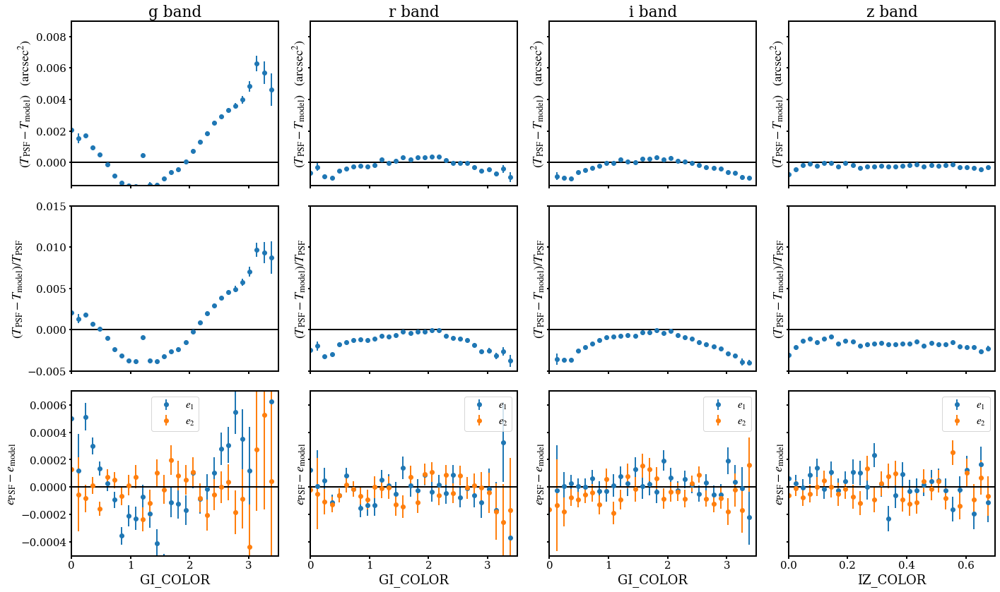

In [88]:
fig, axes = plt.subplots(3,4, figsize=(20,12), sharey='row', sharex='col')
bands = 'griz'
for i, band in enumerate(bands):
    data = cat2[cat2['BAND'] == band]
    fracsizeres, sizeres, e1res, e2res = compute_res(data)
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
        
    (min_edge, max_edge, bins, 
         bin_dT, bin_dT_err, 
         bin_dTfrac, bin_dTfrac_err,
         bin_de1, bin_de1_err, 
         bin_de2, bin_de2_err) = bin_res_by_color(data[color], sizeres, fracsizeres, 
                                                  e1res, e2res, max_edge=cmax)
    plot_bin_res(min_edge, max_edge, bins, bin_dT, bin_dT_err, bin_dTfrac,
                     bin_dTfrac_err, bin_de1, bin_de1_err, bin_de2, bin_de2_err,
                     Tlims=(-0.0015, 0.009), Tfraclims=(-0.005, 0.015), elims=(-5.e-4, 7.e-4), axes=axes[:,i])

mean de =  2.682542887180489e-05 -2.4268462076125452e-05
mean dt =  0.0005527913761112237
Total in band:  838618
g 15.0 21.0
mean de =  -1.8900326796272567e-05 -2.1919689987174433e-05
mean dt =  -0.00015352512373764652
Total in band:  1104990
r 15.0 21.0
mean de =  2.260359341717299e-05 -4.211593802080808e-05
mean dt =  -0.0002328583760313815
Total in band:  1183500
i 15.0 21.0
mean de =  2.2158203584296218e-05 -1.2931372106588115e-05
mean dt =  -0.0002406072019711474
Total in band:  1053725
z 15.0 21.0


/tmp/ipykernel_3576/2527140145.py:7: RuntimeWarning: invalid value encountered in log10
  mag = zeropt - 2.5*np.log10(data['FLUX'])


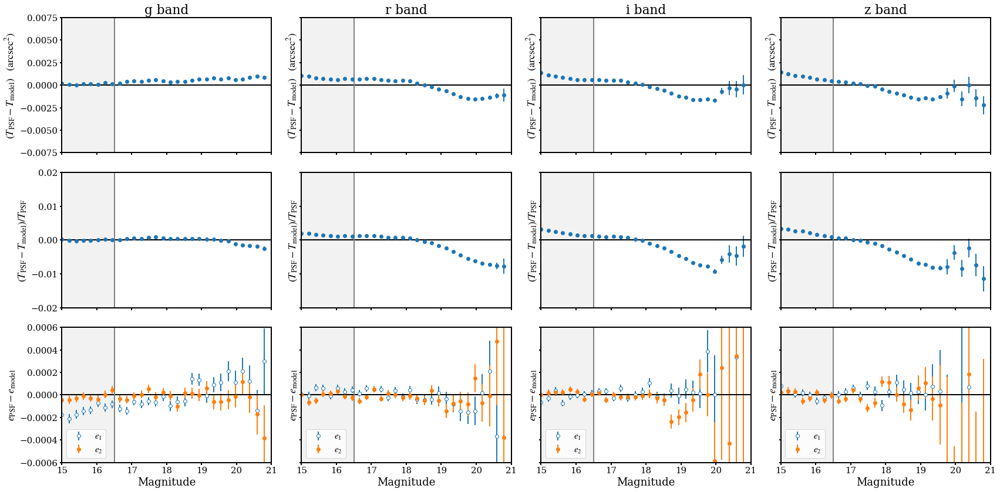

In [89]:
fig, axes = plt.subplots(3,4, figsize=(24,12), sharey='row', sharex='col')
# tlims = [(0,0.6), (0.6,1.0), (1.0, 1.5), (1.5, 2.5)]
for i, band in enumerate(bands):
    data = cat2[cat2['BAND'] == band]
    fracsizeres, sizeres, e1res, e2res = compute_res(data)
    zeropt = 30.
    mag = zeropt - 2.5*np.log10(data['FLUX'])
    print('Total in band: ', len(data))

    bin_by_mag(mag, sizeres, fracsizeres, e1res, e2res, axes=axes[:,i])

### cutting T>1.5asec^2

In [73]:
cat2 = cat[cat['T_DATA'] < 1.5]

mean de =  0.0001192681348728832 5.795620400730939e-05
mean dt =  0.0009317195938944921
Total in band:  1310900
g 15.0 21.0


/tmp/ipykernel_18167/2527140145.py:7: RuntimeWarning: invalid value encountered in log10
  mag = zeropt - 2.5*np.log10(data['FLUX'])
No handles with labels found to put in legend.


mean de =  -2.3891499988783085e-05 8.785705887712023e-06
mean dt =  -1.7263915894419765e-05
Total in band:  1556508
r 15.0 21.0


No handles with labels found to put in legend.


mean de =  -1.5105034479013088e-05 -5.9805061039558305e-06
mean dt =  -0.00016418162804737643
Total in band:  1627583
i 15.0 21.0


No handles with labels found to put in legend.


mean de =  -7.701915222921478e-06 -8.635889001712407e-06
mean dt =  -0.00017685195458733196
Total in band:  1378183
z 15.0 21.0


No handles with labels found to put in legend.


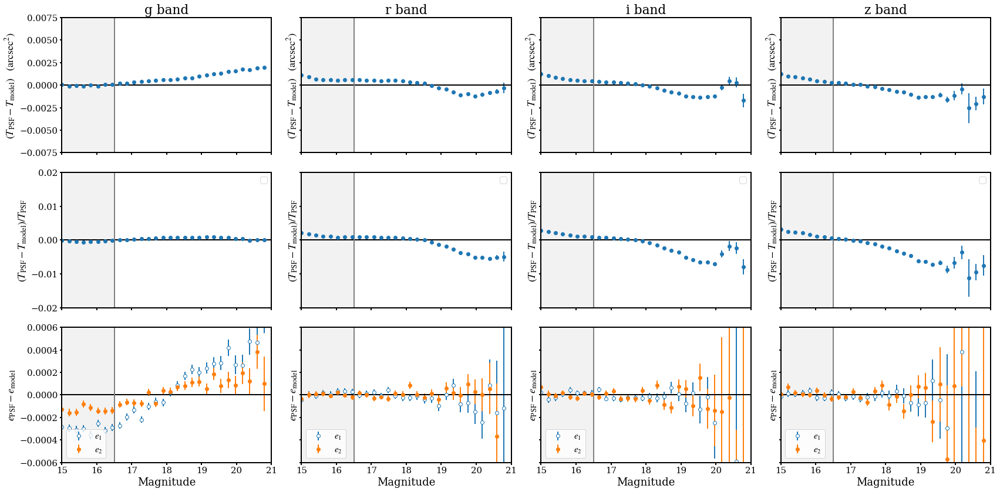

In [74]:
fig, axes = plt.subplots(3,4, figsize=(24,12), sharey='row', sharex='col')
# tlims = [(0,0.6), (0.6,1.0), (1.0, 1.5), (1.5, 2.5)]
for i, band in enumerate(bands):
    data = cat2[cat2['BAND'] == band]
    fracsizeres, sizeres, e1res, e2res = compute_res(data)
    zeropt = 30.
    mag = zeropt - 2.5*np.log10(data['FLUX'])
    print('Total in band: ', len(data))

    bin_by_mag(mag, sizeres, fracsizeres, e1res, e2res, axes=axes[:,i])

### Rho Stats

In [92]:
import os
import sys
sys.path.append('/global/homes/s/schutt20/gband_proj/plotting_scripts')

from rho_stats import measure_rho, write_stats, plot_overall_rho

In [95]:
max_sep = 250
max_mag = 0
name = 'y6a2_piff_v3_allres_v3_subsample'
work = '/global/homes/s/schutt20/y6a2_piff_v3_testing/rho_output'
bands = 'griz'

In [96]:
for band in bands:
    data = cat[cat['BAND'] == band]
    stats = measure_rho(data, max_sep, max_mag, cattype='hsm', subtract_mean=True, do_rho0=False)
    stat_file = os.path.join(work, "rho_%s_%s.json"%(name,band))
    write_stats(stat_file,*stats)

mean e =  0.005004936293904815 -0.001319428639409835
std e =  0.03707189657330999 0.03600777151700984
mean T =  0.6146013908877682
std T =  0.2654777020935369
mean de =  1.9166641941158067e-05 -1.2359034075182122e-05
std de =  0.017405060567791824 0.017275960351329934
mean dT =  0.0009150552042360207
std dT =  0.023549247525996478
mean dT/T =  7.482990325224428e-06
std dT/T =  0.036310879081326464
ra =  [ 61.83342286 -34.60028767  23.60963068 ...  83.24563182  35.55862159
  48.02203652]
dec =  [-6.60533680e+01  8.39092734e-04 -3.03628838e+01 ... -2.73641441e+01
 -3.94431428e+00 -5.95471529e+01]
Doing correlation of qcat vs qcat
nbins = 32, min,max sep = 0.5..250 arcmin, bin_size = 0.194207
Starting process GG auto-correlations for cat qcat.
Using 64 threads.
Building GField from cat qcat
Starting 1024 jobs.
.....................................................................................................................................................................................

/global/homes/s/schutt20/gband_proj/plotting_scripts/rho_stats.py:28: RuntimeWarning: invalid value encountered in log10
  m = zeropt- 2.5*np.log10(np.array(data['FLUX']))


mean e =  -0.004051684220001857 -0.00538897090068843
std e =  0.028975473514535034 0.030179602972524516
mean T =  0.36702993446290494
std T =  0.16118698728878525
mean de =  1.6281142681137398e-05 -1.2188384645438633e-05
std de =  0.016172278160666256 0.016007408606528217
mean dT =  -0.00022156100935947386
std dT =  0.012876683340037911
mean dT/T =  -0.0017020205524308617
std dT/T =  0.03233872362310654
ra =  [ 22.65717988   2.1503739   42.85355552 ... -39.86020263  86.43221337
 -30.2134482 ]
dec =  [-65.72592019 -62.26839684 -43.2031349  ...  -0.16568298 -28.77014743
  -0.28133925]
Doing correlation of qcat vs qcat
nbins = 32, min,max sep = 0.5..250 arcmin, bin_size = 0.194207
Starting process GG auto-correlations for cat qcat.
Using 64 threads.
Building GField from cat qcat
Starting 1024 jobs.
.................................................................................................................................................................................................

griz
Read /global/homes/s/schutt20/y6a2_piff_v3_testing/rho_output/rho_y6a2_piff_v3_allres_v3_subsample_g.json
len(stats) =  31
wrote /global/homes/s/schutt20/y6a2_piff_v3_testing/rho_output/rho_y6a2_piff_v3_allres_v3_subsample_g.dat


/global/homes/s/schutt20/gband_proj/plotting_scripts/rho_stats.py:479: MatplotlibDeprecationWarning: The 'nonposy' parameter of __init__() has been renamed 'nonpositive' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  plt.yscale('log', nonposy='clip')
/global/homes/s/schutt20/gband_proj/plotting_scripts/rho_stats.py:559: MatplotlibDeprecationWarning: The 'nonposy' parameter of __init__() has been renamed 'nonpositive' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  plt.yscale('log', nonposy='clip')


Read /global/homes/s/schutt20/y6a2_piff_v3_testing/rho_output/rho_y6a2_piff_v3_allres_v3_subsample_r.json
len(stats) =  31
wrote /global/homes/s/schutt20/y6a2_piff_v3_testing/rho_output/rho_y6a2_piff_v3_allres_v3_subsample_r.dat


/global/homes/s/schutt20/gband_proj/plotting_scripts/rho_stats.py:479: MatplotlibDeprecationWarning: The 'nonposy' parameter of __init__() has been renamed 'nonpositive' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  plt.yscale('log', nonposy='clip')
/global/homes/s/schutt20/gband_proj/plotting_scripts/rho_stats.py:559: MatplotlibDeprecationWarning: The 'nonposy' parameter of __init__() has been renamed 'nonpositive' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  plt.yscale('log', nonposy='clip')


Read /global/homes/s/schutt20/y6a2_piff_v3_testing/rho_output/rho_y6a2_piff_v3_allres_v3_subsample_i.json
len(stats) =  31
wrote /global/homes/s/schutt20/y6a2_piff_v3_testing/rho_output/rho_y6a2_piff_v3_allres_v3_subsample_i.dat


/global/homes/s/schutt20/gband_proj/plotting_scripts/rho_stats.py:479: MatplotlibDeprecationWarning: The 'nonposy' parameter of __init__() has been renamed 'nonpositive' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  plt.yscale('log', nonposy='clip')
/global/homes/s/schutt20/gband_proj/plotting_scripts/rho_stats.py:559: MatplotlibDeprecationWarning: The 'nonposy' parameter of __init__() has been renamed 'nonpositive' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  plt.yscale('log', nonposy='clip')


Read /global/homes/s/schutt20/y6a2_piff_v3_testing/rho_output/rho_y6a2_piff_v3_allres_v3_subsample_z.json
len(stats) =  31
wrote /global/homes/s/schutt20/y6a2_piff_v3_testing/rho_output/rho_y6a2_piff_v3_allres_v3_subsample_z.dat


/global/homes/s/schutt20/gband_proj/plotting_scripts/rho_stats.py:479: MatplotlibDeprecationWarning: The 'nonposy' parameter of __init__() has been renamed 'nonpositive' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  plt.yscale('log', nonposy='clip')
/global/homes/s/schutt20/gband_proj/plotting_scripts/rho_stats.py:559: MatplotlibDeprecationWarning: The 'nonposy' parameter of __init__() has been renamed 'nonpositive' since Matplotlib 3.3; support for the old name will be dropped two minor releases later.
  plt.yscale('log', nonposy='clip')


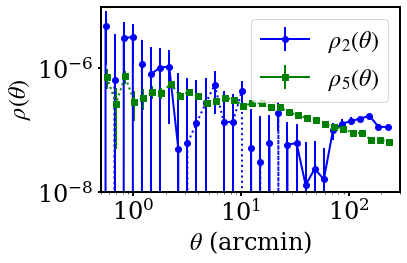

In [97]:
plot_overall_rho(work, name, bands=bands)

/tmp/ipykernel_3576/2978174964.py:16: RuntimeWarning: invalid value encountered in log10
  mag = zeropt - 2.5*np.log10(flux)


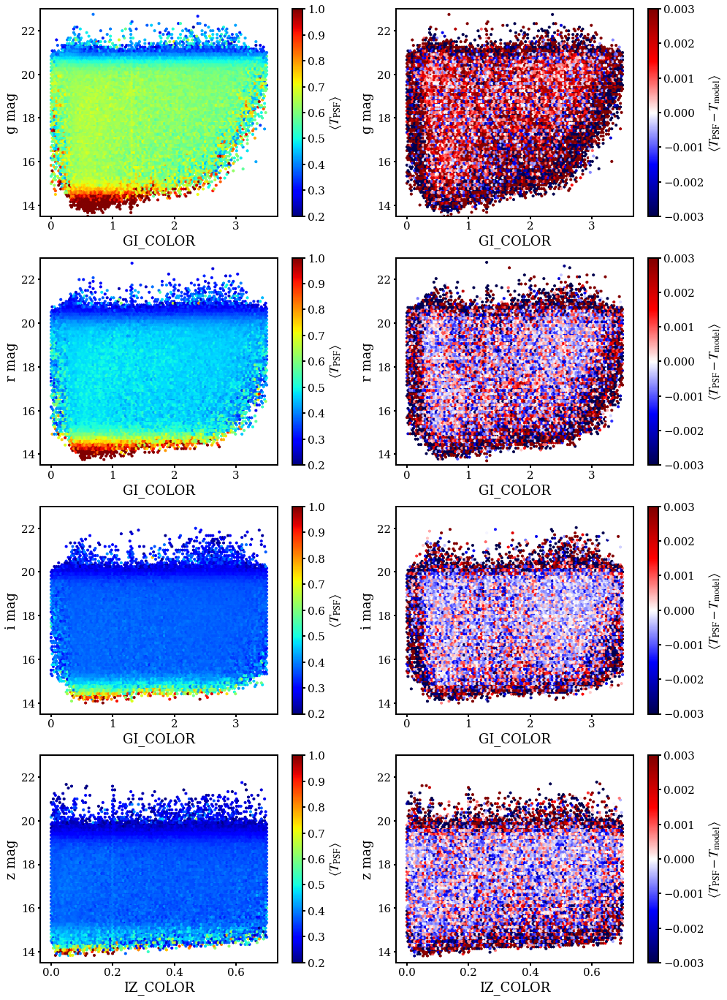

In [98]:
##plot <T>  and <dT> vs (color,mag) per band
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    # <T> vs (color, mag)
    ax = axs[i][0]
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
    data = cat[cat['BAND'] == band]
    chist = data[color]
    flux = data['FLUX']
    zeropt = 30.
    mag = zeropt - 2.5*np.log10(flux)
    mmin = 13.5
    mmax = 23.
    mask = (mag > mmin) & (mag < mmax)
    size = data['T_DATA'][mask]
    chist = chist[mask]
    mag = mag[mask]
    cmap = plt.get_cmap('jet')
    im = ax.hexbin(chist, mag, size, mincnt=1, cmap=cmap, reduce_C_function=np.mean,
                   vmin=0.2, vmax=1., extent=(0, cmax, mmin, mmax))
    ax.set_ylim(mmin, mmax)
    ax.set_ylabel('{} mag'.format(band))
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label(r'$\left<T_{\mathrm{PSF}}\right>$')

    # <dT> vs (color, mag)
    ax = axs[i][1]
    dT = data['T_DATA'] - data['T_MODEL']
    cmap = plt.get_cmap('seismic')
    im = ax.hexbin(chist, mag, dT, mincnt=1, cmap=cmap, reduce_C_function=np.mean,
                   vmin=-0.003, vmax=0.003)
    ax.set_ylim(mmin, mmax)
    ax.set_ylabel('{} mag'.format(band))
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label(r'$\left<T_{\mathrm{PSF}} - T_{\mathrm{model}}\right>$')

/tmp/ipykernel_3576/3075663798.py:16: RuntimeWarning: invalid value encountered in log10
  mag = zeropt - 2.5*np.log10(flux)


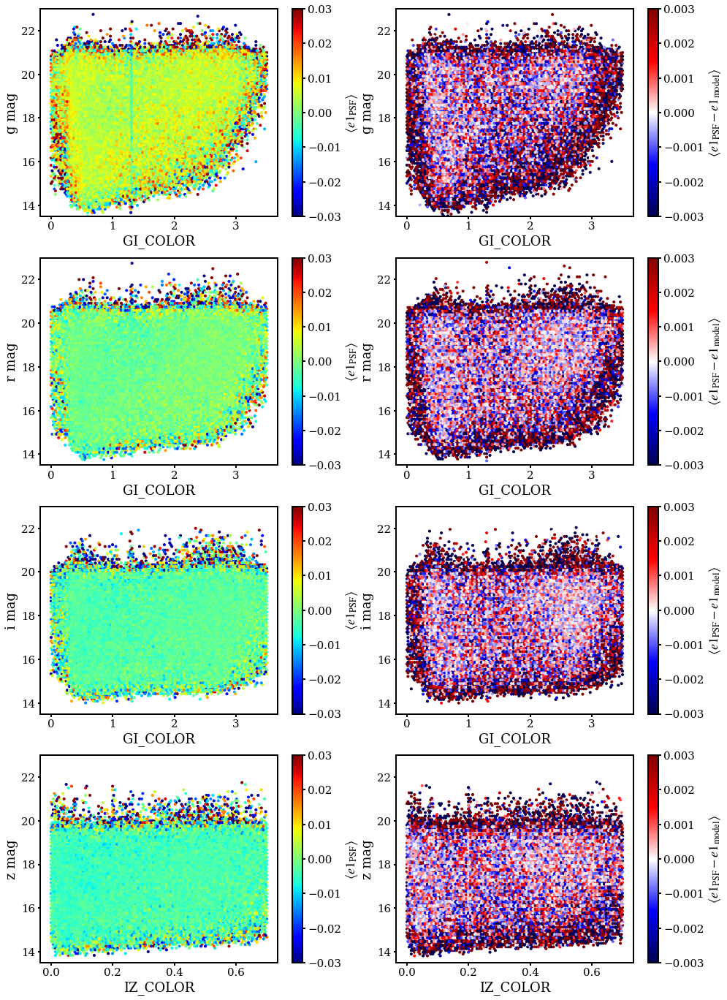

In [99]:
##plot <e1>  and <de1> vs (color,mag) per band
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    # <T> vs (color, mag)
    ax = axs[i][0]
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
    data = cat[cat['BAND'] == band]
    chist = data[color]
    flux = data['FLUX']
    zeropt = 30.
    mag = zeropt - 2.5*np.log10(flux)
    mmin = 13.5
    mmax = 23.
    mask = (mag > 13.5) & (mag < mmax)
    size = data['G1_DATA'][mask]
    chist = chist[mask]
    mag = mag[mask]
    cmap = plt.get_cmap('jet')
    vmin = -0.03
    im = ax.hexbin(chist, mag, size, mincnt=1, cmap=cmap, reduce_C_function=np.mean,
                   vmin=vmin, vmax=-vmin, extent=(0, cmax, mmin, mmax))
    ax.set_ylim(mmin, mmax)
    ax.set_ylabel('{} mag'.format(band))
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label(r'$\left<e1_{\mathrm{PSF}}\right>$')

    # <dT> vs (color, mag)
    ax = axs[i][1]
    dT = data['G1_DATA'] - data['G1_MODEL']
    cmap = plt.get_cmap('seismic')
    im = ax.hexbin(chist, mag, dT, mincnt=1, cmap=cmap, reduce_C_function=np.mean,
                   vmin=-0.003, vmax=0.003)
    ax.set_ylim(mmin, mmax)
    ax.set_ylabel('{} mag'.format(band))
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label(r'$\left<e1_{\mathrm{PSF}} - e1_{\mathrm{model}}\right>$')

/tmp/ipykernel_16328/2245902426.py:16: RuntimeWarning: invalid value encountered in log10
  mag = zeropt - 2.5*np.log10(flux)


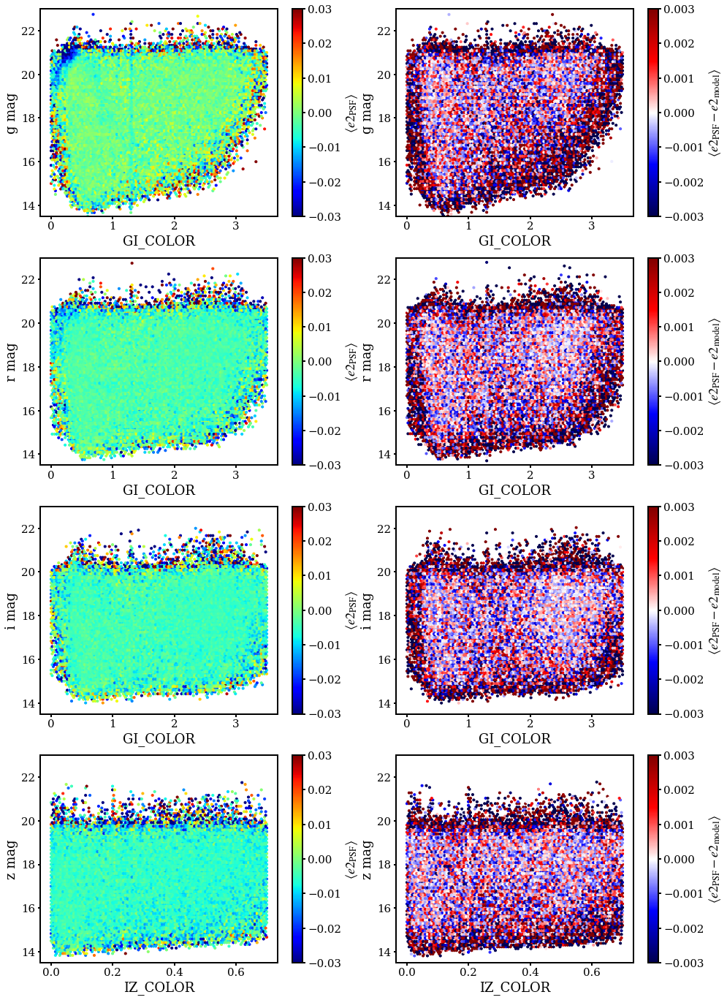

In [25]:
##plot <e2>  and <de2> vs (color,mag) per band
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    # <T> vs (color, mag)
    ax = axs[i][0]
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
    data = cat[cat['BAND'] == band]
    chist = data[color]
    flux = data['FLUX']
    zeropt = 30.
    mag = zeropt - 2.5*np.log10(flux)
    mmin = 13.5
    mmax = 23.
    mask = (mag > 13.5) & (mag < mmax)
    size = data['G2_DATA'][mask]
    chist = chist[mask]
    mag = mag[mask]
    cmap = plt.get_cmap('jet')
    vmin = -0.03
    im = ax.hexbin(chist, mag, size, mincnt=1, cmap=cmap, reduce_C_function=np.mean,
                   vmin=vmin, vmax=-vmin, extent=(0, cmax, mmin, mmax))
    ax.set_ylim(mmin, mmax)
    ax.set_ylabel('{} mag'.format(band))
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label(r'$\left<e2_{\mathrm{PSF}}\right>$')

    # <dT> vs (color, mag)
    ax = axs[i][1]
    dT = data['G2_DATA'] - data['G2_MODEL']
    cmap = plt.get_cmap('seismic')
    im = ax.hexbin(chist, mag, dT, mincnt=1, cmap=cmap, reduce_C_function=np.mean,
                   vmin=-0.003, vmax=0.003)
    ax.set_ylim(mmin, mmax)
    ax.set_ylabel('{} mag'.format(band))
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label(r'$\left<e2_{\mathrm{PSF}} - e2_{\mathrm{model}}\right>$')

### IR/optical color-color diagram

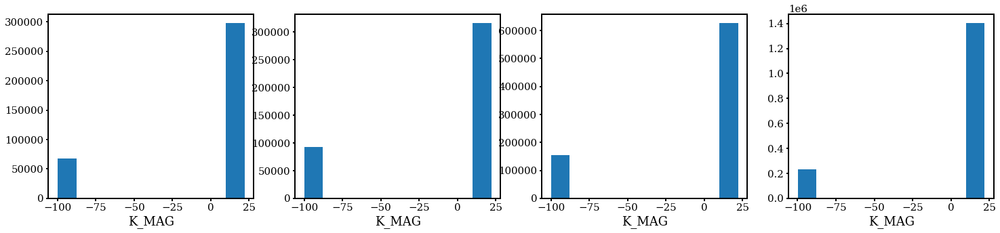

In [73]:
fig, axs = plt.subplots(1,4, figsize=(25,5))
for i, band in enumerate('griz'):
    ccat = cat[cat['BAND'] == band]
    ax = axs[i]
    ir = ccat['K_MAG']
    im = ax.hist(ir)
    # ax.set_ylim(0,tmax)
    ax.set_xlabel('K_MAG')

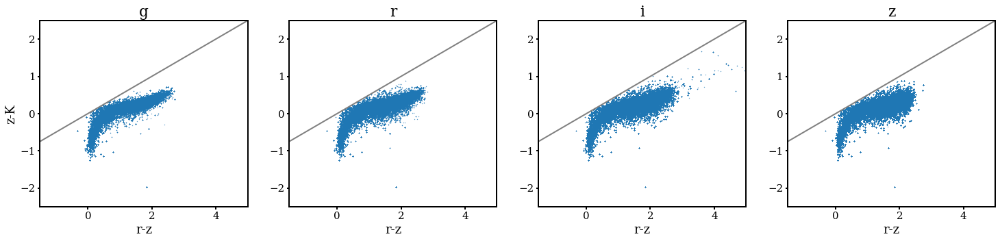

In [74]:
fig, axs = plt.subplots(1,4, figsize=(25,5))
# z-K vs r-z
for i, band in enumerate('griz'):
    ccat = cat[cat['BAND'] == band]
    ax = axs[i]
    # tmax = 1.5
    mask = (ccat['VHS_OBJ'] == 1) & (ccat['Z_MAG'] > 0)
    ir = (ccat['Z_MAG'] - ccat['K_MAG'])[mask]
    opt = (ccat['R_MAG'] - ccat['Z_MAG'])[mask]
    im = ax.scatter(opt, ir, s=0.1)
    cut = ax.plot([-10,10], [-5,5], color='gray')
    ax.set_xlim(-1.5,5)
    ax.set_ylim(-2.5,2.5)
    ax.set_xlabel('r-z')
    ax.set_title(band)
    if band == 'g':
        ax.set_ylabel('z-K')
    # if band == 'z':
    #     cbar = plt.colorbar(im, ax=ax)
    #     cbar.set_label('# stars')

/tmp/ipykernel_10255/991505563.py:14: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(opt[binmask], ir[binmask], bins='log', mincnt=1, vmax=5000)


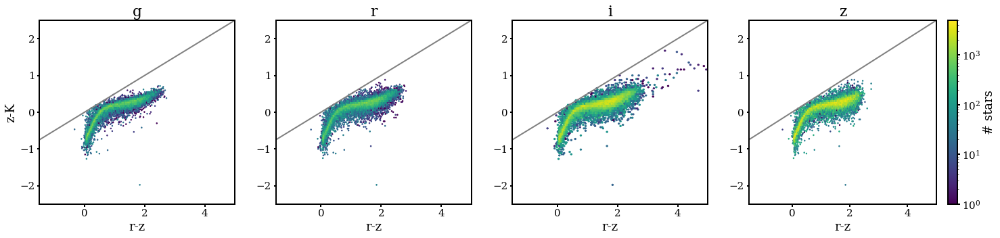

In [75]:
fig, axs = plt.subplots(1,4, figsize=(25,5), gridspec_kw={'width_ratios': [1,1,1,1.2]})
# z-K vs r-z
for i, band in enumerate('griz'):
    ccat = cat[cat['BAND'] == band]
    ax = axs[i]
    zk_min = -2.5
    zk_max = 2.5
    rz_min = -1.5
    rz_max = 5.
    mask = (ccat['VHS_OBJ'] == 1) & (ccat['Z_MAG'] > 0)
    ir = (ccat['Z_MAG'] - ccat['K_MAG'])[mask]
    opt = (ccat['R_MAG'] - ccat['Z_MAG'])[mask]
    binmask = (ir > zk_min) & (ir < zk_max) & (opt > rz_min) & (opt < rz_max)
    im = ax.hexbin(opt[binmask], ir[binmask], bins='log', mincnt=1, vmax=5000)
    cut = ax.plot([-10,10], [-5,5], color='gray')
    ax.set_xlim(rz_min, rz_max)
    ax.set_ylim(zk_min, zk_max)
    ax.set_xlabel('r-z')
    ax.set_title(band)
    if band == 'g':
        ax.set_ylabel('z-K')
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label('# stars')

### Checking T/Tpsf for stars

/tmp/ipykernel_30796/3256663511.py:9: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(xdat, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
/tmp/ipykernel_30796/3256663511.py:25: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(xdat, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
/tmp/ipykernel_30796/3256663511.py:42: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(xdat, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)


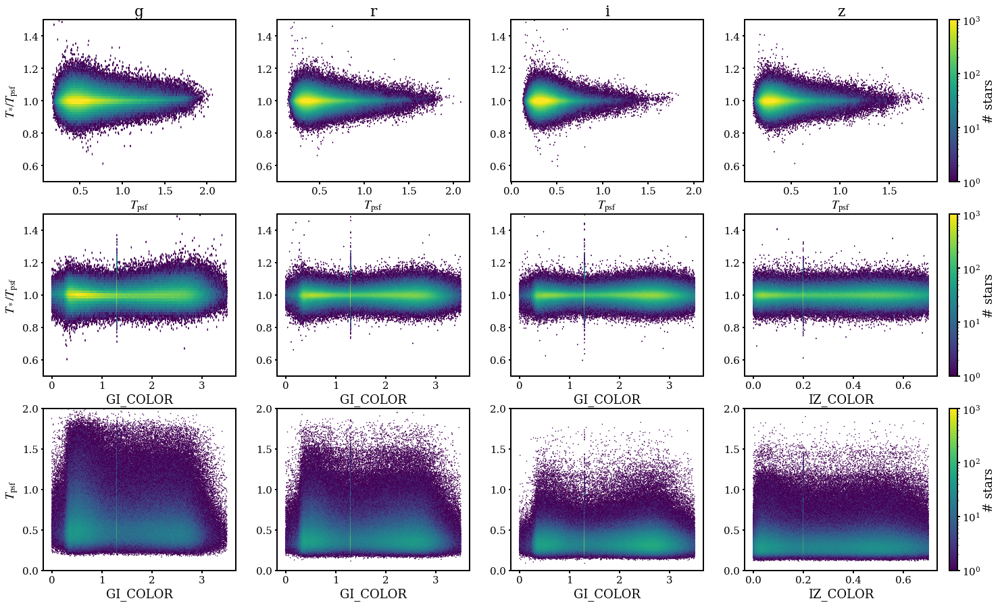

In [29]:
fig, axs = plt.subplots(3,4, figsize=(25,15), gridspec_kw={'width_ratios': [1,1,1,1.25]})
# shape residuals vs. SNR
for i, band in enumerate(bands):
    ccat = cat[cat['BAND'] == band]
    
    ax = axs[0,i]
    ax.set_title(band)
    xdat = ccat['T_MODEL']
    dat = ccat['T_DATA']/ccat['T_MODEL']
    im = ax.hexbin(xdat, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
    ax.set_xlabel(r'$T_{\rm psf}$')
    ax.set_ylim((0.5,1.5))
    if band == 'g':
        ax.set_ylabel(r'$T_{*}/T_{\rm psf}$')
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label('# stars')

    ax = axs[1,i]
    if band == 'z':
        color = 'IZ_COLOR'
    else:
        color = 'GI_COLOR'
    xdat = ccat[color]
    im = ax.hexbin(xdat, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
    # ax.set_xlabel('SNR')
    ax.set_ylim((0.5, 1.5))
    ax.set_xlabel(color)
    if band == 'g':
        ax.set_ylabel(r'$T_*/T_{\rm psf}$')
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label('# stars')

#     ax = axs[2,i]
#     emax = 0.2
#     mask = (np.abs(ccat['G2_DATA']) < emax)
#     snr = ccat['SNR'][mask]
#     dat = ccat['G2_DATA'][mask]
#     im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
#     ax.set_xlabel('SNR')
#     ax.set_ylim(-emax, emax)
#     if band == 'g':
#         ax.set_ylabel('e2')
#     if band == 'z':
#         cbar = plt.colorbar(im, ax=ax)
#         cbar.set_label('# stars')


/tmp/ipykernel_30796/4176868584.py:13: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(xdat, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)


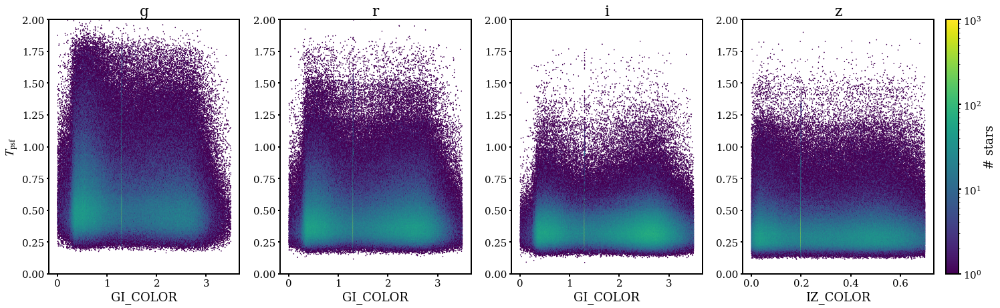

In [31]:
fig, axs = plt.subplots(1,4, figsize=(25,7), gridspec_kw={'width_ratios': [1,1,1,1.25]})

for i, band in enumerate(bands):
    ccat = cat[cat['BAND'] == band]
    ax = axs[i]
    ax.set_title(band)
    if band == 'z':
        color = 'IZ_COLOR'
    else:
        color = 'GI_COLOR'
    xdat = ccat[color]
    dat = ccat['T_MODEL']
    im = ax.hexbin(xdat, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
    # ax.set_xlabel('SNR')
    ax.set_ylim((0., 2.))
    ax.set_xlabel(color)
    if band == 'g':
        ax.set_ylabel(r'$T_{\rm psf}$')
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label('# stars')

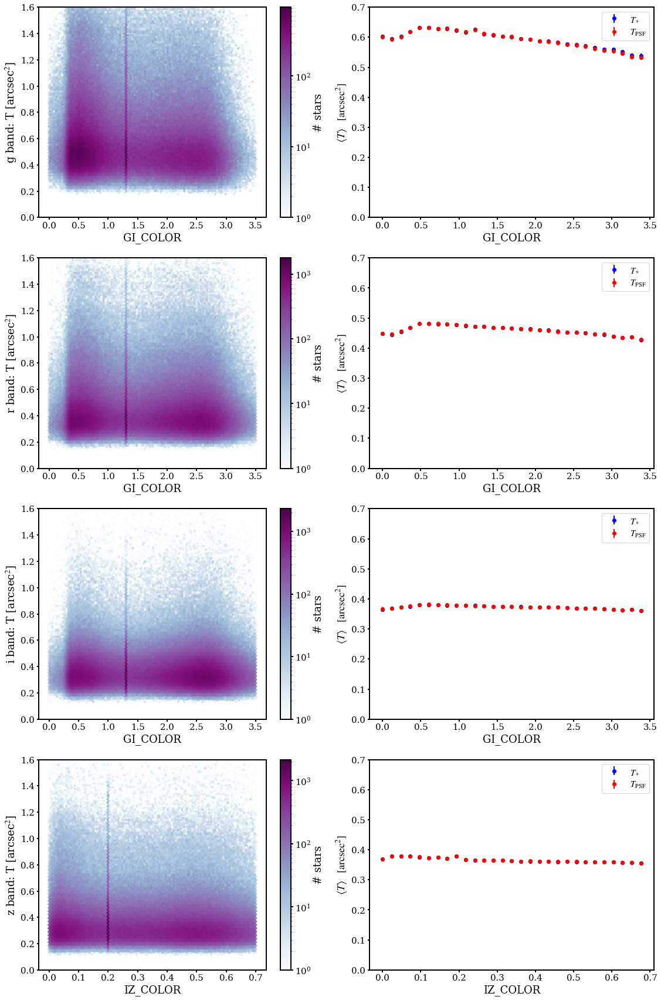

In [13]:
# plot size vs. color 2d hist and profile
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    ax = axs[i][0]
    #plot size vs color 2d hist with log density
    if band == 'z':
        color = 'IZ_COLOR'
        gcolor = 0.34
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
        gcolor = 1.1
    # cat = cat[cat['T_DATA'] < 2.5]
    tmax = 1.6
    mask = (cat['BAND'] == band) & (cat['T_DATA'] < tmax)
    bandcat = cat[mask]
    chist = cat[color][mask]
    size = cat['T_DATA'][mask]
    cmap = plt.get_cmap('BuPu')
    im = ax.hexbin(chist, size, bins='log', mincnt=1, cmap=cmap)
    ax.set_ylim(0., tmax)
    ax.set_ylabel(r'{} band: T [arcsec$^2$]'.format(band))
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('# stars')
    
    #plot size vs color profile
    ax = axs[i][1]
    cbins, Tbins, Tbins_err = make_profile(chist, size, xmax=cmax)
    cbins2, Tpsfbins, Tpsfbins_err = make_profile(chist, cat['T_MODEL'][mask], xmax=cmax)
    # stars_galcolor = bandcat['T_MODEL'][(bandcat[color] > gcolor - 0.01) & (bandcat[color] < gcolor + 0.01)]
    # print(len(stars_galcolor), np.mean(stars_galcolor), np.median(stars_galcolor), np.std(stars_galcolor))
    # color+r'/%s$_{\rm gal, default}$'%color
    plot_profile(cbins, Tbins, Tbins_err, ax, ymax=0.7, xlabel=color,
                 ylabel=r'$\left<T_{*}\right>\quad[{\rm arcsec}^2]$', proflabel=r'$T_{\rm *}$', profcolor='b')
    plot_profile(cbins, Tpsfbins, Tpsfbins_err, ax, ymax=0.7, xlabel=color,
                 ylabel=r'$\left<T\right> \quad[{\rm arcsec}^2]$', proflabel=r'$T_{\rm PSF}$', profcolor='r')

/tmp/ipykernel_10030/3371203184.py:6: RuntimeWarning: Mean of empty slice.
  bin_shape = [shape_data[index == i].mean() for i in range(1, len(x_bins))]
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_10030/3371203184.py:8: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_shape_err = [ np.sqrt(shape_data[index == i].var() / len(shape_data[index == i]))
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:221: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:253: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_10030/3371203184

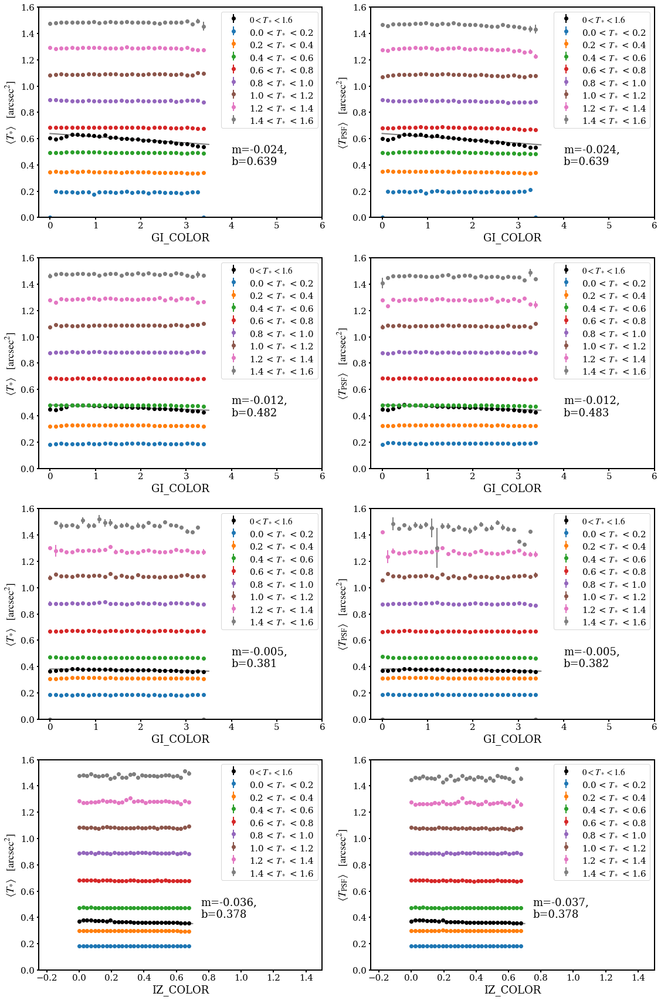

In [32]:
# plot size vs. color 2d hist and profile
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    #plot size vs color 2d hist with log density
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
        pltcmax = 1.5
        textx = 0.75
        gcolor = 0.34
    else:
        color = 'GI_COLOR'
        cmax = 3.5
        pltcmax = 6.
        textx = 4.
        gcolor = 1.1
    # cat = cat[cat['T_DATA'] < 2.5]
    tmax = 1.6
    
    mask = (cat['BAND'] == band) & (cat['T_DATA'] < tmax)
    bcat = cat[mask]
    chist = bcat[color]
    starsize = bcat['T_DATA']
    psfsize = bcat['T_MODEL']
    
    cbins, Tbins, Tbins_err = make_profile(chist, starsize, xmax=cmax)
    p0 = np.polyfit(cbins[:-1], Tbins, 1, w=1/np.power(Tbins_err, 2))
    cbins2, Tpsfbins, Tpsfbins_err = make_profile(chist, psfsize, xmax=cmax)
    p1 = np.polyfit(cbins2[:-1], Tpsfbins, 1, w=1/np.power(Tpsfbins_err, 2))

    # stars_galcolor = bandcat['T_MODEL'][(bandcat[color] > gcolor - 0.01) & (bandcat[color] < gcolor + 0.01)]
    # print(len(stars_galcolor), np.mean(stars_galcolor), np.median(stars_galcolor), np.std(stars_galcolor))
    # color+r'/%s$_{\rm gal, default}$'%color
    ax = axs[i][0]
    plot_profile(cbins, Tbins, Tbins_err, ax, ymax=0.7, xlabel=color,
                 ylabel=r'$\left<T_{*}\right>\quad[{\rm arcsec}^2]$', proflabel=r'$0 < T_{\rm *} < 1.6$', profcolor='k')
    ax.text(textx, 0.4, 'm=%.3f,\nb=%.3f'%(p0[0], p0[1]))
    x = np.asarray([min(cbins), max(cbins)])
    ax.plot(x, p0[0]*x + p0[1], color='k', alpha=0.5) 
    # ax.hist(starsize, orientation='horizontal', density=True, histtype='stepfilled', alpha=0.3, color='k')
    ax = axs[i][1]
    plot_profile(cbins2, Tpsfbins, Tpsfbins_err, ax, ymax=0.7, xlabel=color,
                 ylabel=r'$\left<T\right> \quad[{\rm arcsec}^2]$', proflabel=r'$0 < T_{\rm *} < 1.6$', profcolor='k')
    # ax.hist(starsize, orientation='horizontal', density=True, histtype='stepfilled', alpha=0.3, color='k')
    x = np.asarray([min(cbins2), max(cbins2)])
    ax.plot(x, p1[0]*x + p1[1], color='k', alpha=0.5) 
    ax.text(textx, 0.4, 'm=%.3f,\nb=%.3f'%(p1[0], p1[1]))
    
    lims = np.linspace(0, 1.6, 9)
    for k in range(len(lims) - 1):
        trange = (lims[k], lims[k+1])
        slicemask = (bcat['T_DATA'] > trange[0]) & (bcat['T_DATA'] < trange[1])
        slicecat = bcat[slicemask]
        cslice = slicecat[color]
        tdataslice = slicecat['T_DATA']
        tpsfslice = slicecat['T_MODEL']
        
        cbins, Tbins, Tbins_err = make_profile(cslice, tdataslice, xmax=cmax)
        cbins2, Tpsfbins, Tpsfbins_err = make_profile(cslice, tpsfslice, xmax=cmax)
        # stars_galcolor = bandcat['T_MODEL'][(bandcat[color] > gcolor - 0.01) & (bandcat[color] < gcolor + 0.01)]
        # print(len(stars_galcolor), np.mean(stars_galcolor), np.median(stars_galcolor), np.std(stars_galcolor))
        # color+r'/%s$_{\rm gal, default}$'%color
        ax = axs[i][0]
        plot_profile(cbins, Tbins, Tbins_err, ax, ymax=1.6, xlabel=color,
                     ylabel=r'$\left<T_{*}\right> \quad[{\rm arcsec}^2]$', proflabel=r'%.1f < $T_*$ < %.1f'%(trange[0], trange[1]))
        ax.set_xlim((-0.25, pltcmax))
        ax = axs[i][1]
        plot_profile(cbins, Tpsfbins, Tpsfbins_err, ax, ymax=1.6, xlabel=color,
                     ylabel=r'$\left<T_{\rm PSF}\right> \quad[{\rm arcsec}^2]$', proflabel=r'%.1f < $T_*$ < %.1f'%(trange[0], trange[1]))
        ax.set_xlim((-0.25, pltcmax))

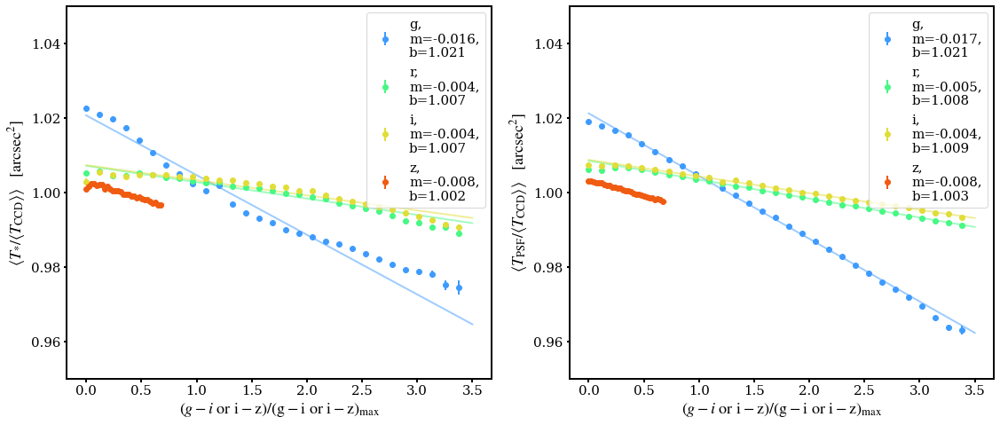

In [47]:
# plot size vs. color 2d hist and profile
fig, axs = plt.subplots(1,2, figsize=(16,7))
cmap = plt.get_cmap('turbo')
for i, band in enumerate(bands):
    #plot size vs color 2d hist with log density
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
        pltcmax = 1.5
        textx = 0.75
        gcolor = 0.34
    else:
        color = 'GI_COLOR'
        cmax = 3.5
        pltcmax = 6.
        textx = 4.
        gcolor = 1.1
    # cat = cat[cat['T_DATA'] < 2.5]
    tmax = 1.6
    
    mask = (cat['BAND'] == band) & (cat['T_DATA'] < tmax)
    ccd_t_mskd = ccd_t[mask]
    bcat = cat[mask]
    chist = bcat[color]
    starsize = bcat['T_DATA']/ccd_t_mskd
    psfsize = bcat['T_MODEL']/ccd_t_mskd
    
    cbins, Tbins, Tbins_err = make_profile(chist, starsize, xmax=cmax)
    scaled_cbins = cbins
    p0 = np.polyfit(scaled_cbins[:-1], Tbins, 1, w=1/np.power(Tbins_err, 2))
    _, Tpsfbins, Tpsfbins_err = make_profile(chist, psfsize, xmax=cmax)
    p1 = np.polyfit(scaled_cbins[:-1], Tpsfbins, 1, w=1/np.power(Tpsfbins_err, 2))

    # stars_galcolor = bandcat['T_MODEL'][(bandcat[color] > gcolor - 0.01) & (bandcat[color] < gcolor + 0.01)]
    # print(len(stars_galcolor), np.mean(stars_galcolor), np.median(stars_galcolor), np.std(stars_galcolor))
    # color+r'/%s$_{\rm gal, default}$'%color
    pltcolor = cmap((i+1)/5)
    ax = axs[0]
    ymin=0.95
    ymax=1.05
    plot_profile(scaled_cbins, Tbins, Tbins_err, ax, ymin=ymin, ymax=ymax,
                 ylabel=r'$\left< T_{*} / \left<T_{\rm CCD}\right> \right>\quad[{\rm arcsec}^2]$', 
                 proflabel=band+'\nm=%.3f,\nb=%.3f'%(p0[0], p0[1]), profcolor=pltcolor)
    # ax.text(textx, 0.4, 'm=%.3f,\nb=%.3f'%(p0[0], p0[1]))
    x = np.asarray([min(scaled_cbins), max(scaled_cbins)])
    ax.plot(x, p0[0]*x + p0[1], color=pltcolor, alpha=0.5)
    ax.set_xlabel(r'$(g-i~ \rm{or}~ i-z)/(g-i~ \rm{or}~ i-z)_{\rm max}$')
    # ax.hist(starsize, orientation='horizontal', density=True, histtype='stepfilled', alpha=0.3, color='k')
    ax = axs[1]
    plot_profile(scaled_cbins, Tpsfbins, Tpsfbins_err, ax, ymin=ymin, ymax=ymax,
                 ylabel=r'$\left<T_{\rm PSF} / \left<T_{\rm CCD}\right> \right> \quad[{\rm arcsec}^2]$',
                 proflabel=band+'\nm=%.3f,\nb=%.3f'%(p1[0], p1[1]), profcolor=pltcolor)
    # ax.hist(starsize, orientation='horizontal', density=True, histtype='stepfilled', alpha=0.3, color='k')
    x = np.asarray([min(scaled_cbins), max(scaled_cbins)])
    ax.plot(x, p1[0]*x + p1[1], color=pltcolor, alpha=0.5)
    ax.set_xlabel(r'$(g-i~ \rm{or}~ i-z)/(g-i~ \rm{or}~ i-z)_{\rm max}$')

    # ax.text(textx, 0.4, 'm=%.3f,\nb=%.3f'%(p1[0], p1[1]))
    
#     lims = np.linspace(0, 1.6, 9)
#     for k in range(len(lims) - 1):
#         trange = (lims[k], lims[k+1])
#         slicemask = (bcat['T_DATA'] > trange[0]) & (bcat['T_DATA'] < trange[1])
#         slicecat = bcat[slicemask]
#         cslice = slicecat[color]
#         tdataslice = slicecat['T_DATA']
#         tpsfslice = slicecat['T_MODEL']
        
#         cbins, Tbins, Tbins_err = make_profile(cslice, tdataslice, xmax=cmax)
#         cbins2, Tpsfbins, Tpsfbins_err = make_profile(cslice, tpsfslice, xmax=cmax)
#         # stars_galcolor = bandcat['T_MODEL'][(bandcat[color] > gcolor - 0.01) & (bandcat[color] < gcolor + 0.01)]
#         # print(len(stars_galcolor), np.mean(stars_galcolor), np.median(stars_galcolor), np.std(stars_galcolor))
#         # color+r'/%s$_{\rm gal, default}$'%color
#         ax = axs[i][0]
#         plot_profile(cbins, Tbins, Tbins_err, ax, ymax=1.6, xlabel=color,
#                      ylabel=r'$\left<T_{*}\right> \quad[{\rm arcsec}^2]$', proflabel=r'%.1f < $T_*$ < %.1f'%(trange[0], trange[1]))
#         ax.set_xlim((-0.25, pltcmax))
#         ax = axs[i][1]
#         plot_profile(cbins, Tpsfbins, Tpsfbins_err, ax, ymax=1.6, xlabel=color,
#                      ylabel=r'$\left<T_{\rm PSF}\right> \quad[{\rm arcsec}^2]$', proflabel=r'%.1f < $T_*$ < %.1f'%(trange[0], trange[1]))
#         ax.set_xlim((-0.25, pltcmax))

In [33]:
ccd_t = fcat[1]['STAR_T_MEAN'][idx_sample]

[  6433  34508 118268 111558  84638  58366  44459  57335  37516  38244
  41677  45719  48616  50468  50539  43647  26593  11175   3992   1360]
[  6433  34508 118268 111558  84638  58366  44459  57335  37516  38244
  41677  45719  48616  50468  50539  43647  26593  11175   3992   1360]
[  5904  32677 109114 100280  78756  55432  44423  66161  41619  47073
  54750  63475  72895  81558  88060  81056  56676  29996  13793   5818]
[  5904  32677 109114 100280  78756  55432  44423  66161  41619  47073
  54750  63475  72895  81558  88060  81056  56676  29996  13793   5818]
[  4000  24596  89494  83582  66895  47996  39259  65872  37718  43098
  51455  62193  75512  91578 109343 110285  85787  52779  30333  16310]
[  4000  24596  89494  83582  66895  47996  39259  65872  37718  43098
  51455  62193  75512  91578 109343 110285  85787  52779  30333  16310]
[67716 82034 68524 53884 46639 71202 44278 45765 46566 46898 48492 52563
 57274 60899 60936 57442 50407 42504 33391 24916]
[67716 82034 68524 

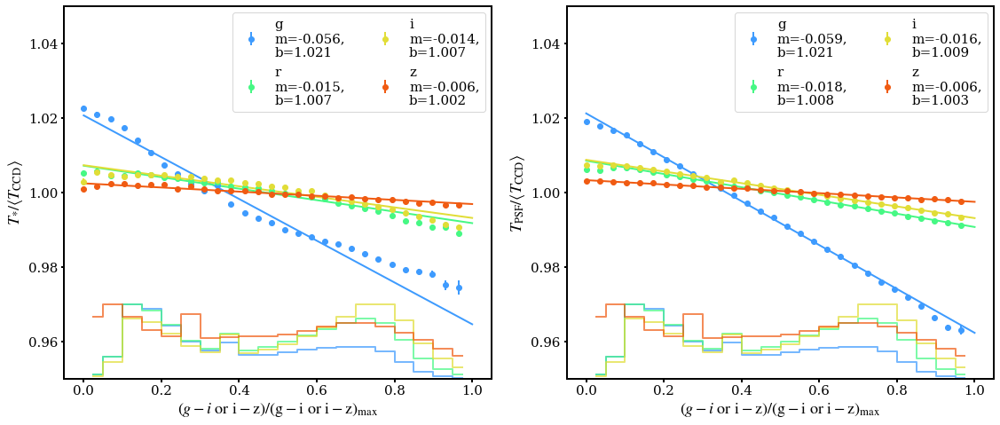

In [14]:
# plot size vs. color 2d hist and profile
fig, axs = plt.subplots(1,2, figsize=(16,7))
cmap = plt.get_cmap('turbo')
for i, band in enumerate(bands):
    #plot size vs color 2d hist with log density
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
        pltcmax = 1.5
        textx = 0.75
        gcolor = 0.34
    else:
        color = 'GI_COLOR'
        cmax = 3.5
        pltcmax = 6.
        textx = 4.
        gcolor = 1.1
    # cat = cat[cat['T_DATA'] < 2.5]
    tmax = 1.6
    
    mask = (cat['BAND'] == band) & (cat['T_DATA'] < tmax)
    # ccd_t_mskd = ccd_t[mask]
    bcat = cat[mask]
    chist = bcat[color]
    ccd_t_mskd = bcat['STAR_T_MEAN']
    starsize = bcat['T_DATA']/ccd_t_mskd
    psfsize = bcat['T_MODEL']/ccd_t_mskd
    
    cbins, Tbins, Tbins_err = make_profile(chist, starsize, xmax=cmax)
    scaled_cbins = cbins/cmax
    p0 = np.polyfit(scaled_cbins[:-1], Tbins, 1, w=1/np.power(Tbins_err, 2))
    _, Tpsfbins, Tpsfbins_err = make_profile(chist, psfsize, xmax=cmax)
    p1 = np.polyfit(scaled_cbins[:-1], Tpsfbins, 1, w=1/np.power(Tpsfbins_err, 2))

    # stars_galcolor = bandcat['T_MODEL'][(bandcat[color] > gcolor - 0.01) & (bandcat[color] < gcolor + 0.01)]
    # print(len(stars_galcolor), np.mean(stars_galcolor), np.median(stars_galcolor), np.std(stars_galcolor))
    # color+r'/%s$_{\rm gal, default}$'%color
    pltcolor = cmap((i+1)/5)
    ax = axs[0]
    ymin=0.95
    ymax=1.05
    scaled_cbins = cbins/cmax
    plot_profile(scaled_cbins, Tbins, Tbins_err, ax, ymin=ymin, ymax=ymax,
                 ylabel=r'$T_{*} / \left<T_{\rm CCD}\right>$', 
                 proflabel=band+'\nm=%.3f,\nb=%.3f'%(p0[0], p0[1]), profcolor=pltcolor)
    # ax.text(textx, 0.4, 'm=%.3f,\nb=%.3f'%(p0[0], p0[1]))
    x = np.asarray([min(scaled_cbins), max(scaled_cbins)])
    ax.plot(x, p0[0]*x + p0[1], color=pltcolor)
    ax.set_xlabel(r'$(g-i~ \rm{or}~ i-z)/(g-i~ \rm{or}~ i-z)_{\rm max}$')
    hist, bin_edges = np.histogram(chist/cmax, bins=20)
    print(hist)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2.
    scaled_hist = (hist / (50 * max(hist))) + ymin
    ax.step(bin_centers, scaled_hist, alpha=0.7, color=pltcolor, where='mid')
    ax.legend(ncol=2)
    ax = axs[1]
    plot_profile(scaled_cbins, Tpsfbins, Tpsfbins_err, ax, ymin=ymin, ymax=ymax,
                 ylabel=r'$T_{\rm PSF} / \left<T_{\rm CCD}\right>$',
                 proflabel=band+'\nm=%.3f,\nb=%.3f'%(p1[0], p1[1]), profcolor=pltcolor)
    hist, bin_edges = np.histogram(chist/cmax, bins=20)
    print(hist)
    bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2.
    scaled_hist = (hist / (50 * max(hist))) + ymin
    ax.step(bin_centers, scaled_hist, alpha=0.7, color=pltcolor, where='mid')
    x = np.asarray([min(scaled_cbins), max(scaled_cbins)])
    ax.plot(x, p1[0]*x + p1[1], color=pltcolor)
    ax.set_xlabel(r'$(g-i~ \rm{or}~ i-z)/(g-i~ \rm{or}~ i-z)_{\rm max}$')
    ax.legend(ncol=2)
    # ax.text(textx, 0.4, 'm=%.3f,\nb=%.3f'%(p1[0], p1[1]))
    
#     lims = np.linspace(0, 1.6, 9)
#     for k in range(len(lims) - 1):
#         trange = (lims[k], lims[k+1])
#         slicemask = (bcat['T_DATA'] > trange[0]) & (bcat['T_DATA'] < trange[1])
#         slicecat = bcat[slicemask]
#         cslice = slicecat[color]
#         tdataslice = slicecat['T_DATA']
#         tpsfslice = slicecat['T_MODEL']
        
#         cbins, Tbins, Tbins_err = make_profile(cslice, tdataslice, xmax=cmax)
#         cbins2, Tpsfbins, Tpsfbins_err = make_profile(cslice, tpsfslice, xmax=cmax)
#         # stars_galcolor = bandcat['T_MODEL'][(bandcat[color] > gcolor - 0.01) & (bandcat[color] < gcolor + 0.01)]
#         # print(len(stars_galcolor), np.mean(stars_galcolor), np.median(stars_galcolor), np.std(stars_galcolor))
#         # color+r'/%s$_{\rm gal, default}$'%color
#         ax = axs[i][0]
#         plot_profile(cbins, Tbins, Tbins_err, ax, ymax=1.6, xlabel=color,
#                      ylabel=r'$\left<T_{*}\right> \quad[{\rm arcsec}^2]$', proflabel=r'%.1f < $T_*$ < %.1f'%(trange[0], trange[1]))
#         ax.set_xlim((-0.25, pltcmax))
#         ax = axs[i][1]
#         plot_profile(cbins, Tpsfbins, Tpsfbins_err, ax, ymax=1.6, xlabel=color,
#                      ylabel=r'$\left<T_{\rm PSF}\right> \quad[{\rm arcsec}^2]$', proflabel=r'%.1f < $T_*$ < %.1f'%(trange[0], trange[1]))
#         ax.set_xlim((-0.25, pltcmax))

#### Now test this slope in g-band vs. T_CCD

/tmp/ipykernel_10390/277203444.py:6: RuntimeWarning: Mean of empty slice.
  bin_shape = np.asarray([shape_data[index == i].mean() for i in range(1, len(x_bins))])
/tmp/ipykernel_10390/277203444.py:8: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_shape_err = np.asarray([ np.sqrt(shape_data[index == i].var() / len(shape_data[index == i]))


[0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.20689655 1.32758621] [1.01590971 1.0005619  0.98901269 0.98444173 0.98058158 0.97680416
 0.9743948  0.99908703 0.98868048 0.94426461 0.98963253] [0.00020661 0.00027624 0.00033676 0.00037876 0.00047008 0.00088116
 0.00228555 0.01265632 0.01027901 0.         0.        ]
[0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069  1.20689655 1.44827586
 1.56896552 1.68965517] [1.01395999 0.99976829 0.98916055 0.98467152 0.98125728 0.97890887
 0.97680506 0.9732287  0.98816689 0.97808428 1.00855386 0.96824471
 1.00936298 0.98176232] [0.00010836 0.00014818 0.00018989 0.00021943 0.0002742  0.00051836
 0.00148602 0.00627326 0.01169732 0.01056946 0.         0.02130387
 0.         0.        ]
[0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069  1.32758621] [1.01162157 0.99967447 0.99048

/tmp/ipykernel_10390/277203444.py:6: RuntimeWarning: Mean of empty slice.
  bin_shape = np.asarray([shape_data[index == i].mean() for i in range(1, len(x_bins))])
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_10390/277203444.py:8: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_shape_err = np.asarray([ np.sqrt(shape_data[index == i].var() / len(shape_data[index == i]))
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:221: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:253: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


[0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069  1.20689655 1.44827586
 1.56896552 1.68965517] [1.0136162  1.00179324 0.98961865 0.98117738 0.97446103 0.96965199
 0.96455576 0.97231345 0.99943579 0.98444083 1.00811576 0.98731088
 1.02349574 1.03378102] [7.49667465e-05 1.02635310e-04 1.11560626e-04 1.24416521e-04
 1.52674528e-04 3.86763307e-04 8.54101109e-04 3.49216713e-03
 5.64834265e-03 1.19408862e-02 0.00000000e+00 3.02427372e-03
 0.00000000e+00 0.00000000e+00]
[0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069  1.32758621] [1.01144348 1.00123587 0.99001226 0.9826724  0.97727826 0.97250725
 0.96868648 0.98203209 0.98204004 1.01085731 0.98618043] [8.50192787e-05 1.06539569e-04 1.29942011e-04 1.50025837e-04
 1.87075332e-04 3.61737468e-04 1.12121663e-03 5.15824006e-03
 6.81434311e-03 1.92804456e-02 0.00000000e+00]
[0.         0.12068966 0.24137931 0.36206897 0.48275

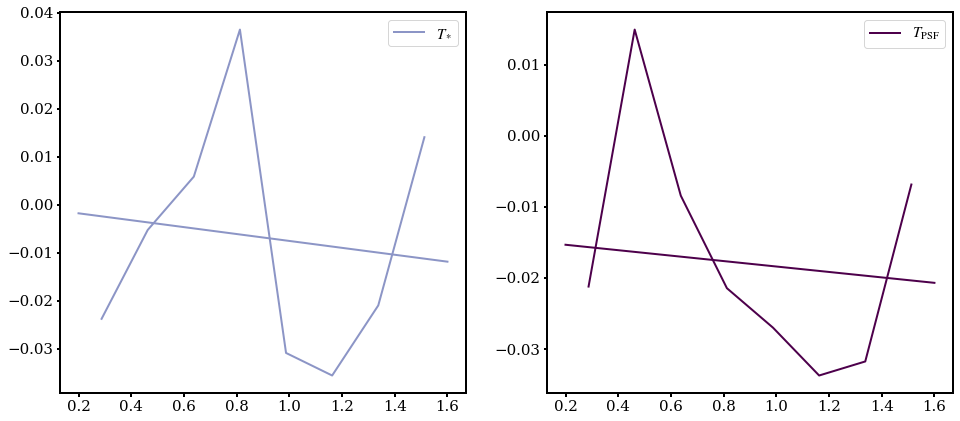

In [42]:
fig, axs = plt.subplots(1,2, figsize=(16,7))
cmap = plt.get_cmap('BuPu')

# set up catalogs for g-band
tmax = 1.6
cmax = 3.5
mask = (cat['BAND'] == 'g') & (cat['T_DATA'] < tmax)
bcat = cat[mask]
chist = bcat[color]
ccd_t_mskd = bcat['STAR_T_MEAN']
starsize = bcat['T_DATA']/ccd_t_mskd
psfsize = bcat['T_MODEL']/ccd_t_mskd

# set up T_CCD slices
lims = np.linspace(0.2, 1.6, 9)
lim_centers = (lims[:-1] + lims[1:]) / 2.
tlist = [('T_DATA', r'$T_*$'), ('T_MODEL', r'$T_{\rm PSF}$')]

for i, (ttype, ax) in enumerate(zip(tlist, axs)):
    pars_list = []
    for k in range(len(lims) - 1):
        trange = (lims[k], lims[k+1])
        slicemask = (bcat['STAR_T_MEAN'] > trange[0]) & (bcat['STAR_T_MEAN'] < trange[1])
        cslice = bcat[slicemask][color]
        # ccd_t_slice =  bcat[slicemask]['STAR_T_MEAN']
        tslice = bcat[slicemask][ttype[0]]/bcat[slicemask]['STAR_T_MEAN']
        
        cbins, Tbins, Tbins_err = make_profile(cslice, tslice, xmax=cmax)
        nz_mask = np.nonzero(Tbins)[0]
        # print(nz_mask, type(Tbins))
        # print(cbins, Tbins, Tbins_err)
        mcbins = cbins[nz_mask]
        mTbins = Tbins[nz_mask]
        mTbins_err = Tbins_err[nz_mask]
        print(mcbins, mTbins, mTbins_err)
        
        p = np.polyfit(mcbins, mTbins, 1)
        # p, _, cov = np.polyfit(mcbins, mTbins, 1, w=1/np.power(Tbins_err, 2))
        pars_list.append(p)
    pars_arr = np.asarray(pars_list)
    print(pars_arr)
    ps = np.polyfit(lim_centers, pars_arr[:,0], 1)
    # ps, _, covs = np.polyfit(lim_centers, pars_arr[:,0], 1, w=1/cov[0,0])
    print(ttype[0], ps)
    # print(ttype[0], ps, covs)
    ax.errorbar(lim_centers, pars_arr[:,0], color=cmap((i+1)/2), label=ttype[1])
    # ax.errorbar(lim_centers, pars_arr[:,i], np.sqrt(cov[i,i]), color=cmap(i/2), label=ttype[1])
    x = np.asarray([lims[0], lims[-1]])
    ax.plot(x, ps[1]*x + ps[0], color=cmap((i+1)/2))
    ax.legend()

In [62]:
np.linspace(0.2, 1.6, 15)


array([0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2, 1.3, 1.4,
       1.5, 1.6])

/tmp/ipykernel_10390/277203444.py:6: RuntimeWarning: Mean of empty slice.
  bin_shape = np.asarray([shape_data[index == i].mean() for i in range(1, len(x_bins))])
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_10390/277203444.py:8: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_shape_err = np.asarray([ np.sqrt(shape_data[index == i].var() / len(shape_data[index == i]))
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:221: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:253: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


T_DATA [-0.00347599 -0.00831929]


/tmp/ipykernel_10390/277203444.py:6: RuntimeWarning: Mean of empty slice.
  bin_shape = np.asarray([shape_data[index == i].mean() for i in range(1, len(x_bins))])
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_10390/277203444.py:8: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_shape_err = np.asarray([ np.sqrt(shape_data[index == i].var() / len(shape_data[index == i]))
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:221: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:253: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


T_MODEL [-0.01894468 -0.00501497]
[ 14744 123620 231654 198517 118628  74721  50124  33680  23581  16885
  12592   9544   5383   1349     89]


Text(0, 0.5, '$\\frac{d(T/T_{\\rm CCD})}{d(g-i)}$')

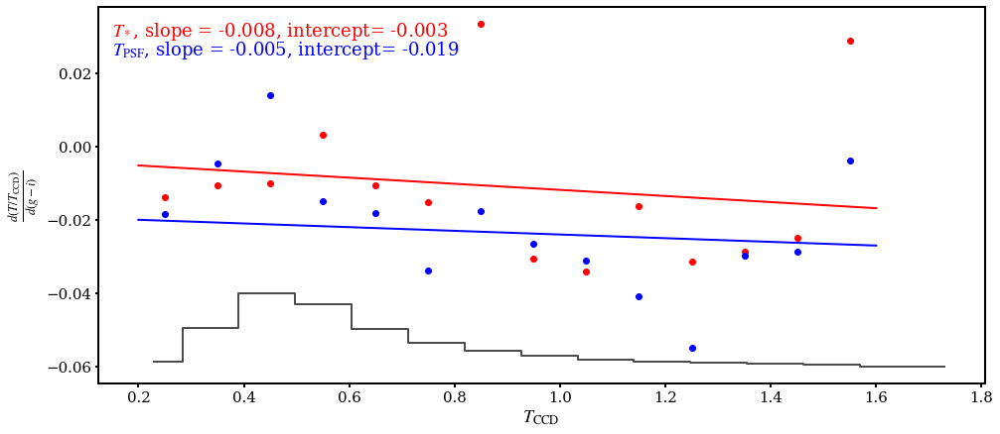

In [72]:
fig, ax = plt.subplots(1,1, figsize=(16,7))
cmap = plt.get_cmap('RdBu')

# set up catalogs for g-band
tmax = 1.6
cmax = 3.5
mask = (cat['BAND'] == 'g') & (cat['T_DATA'] < tmax)
bcat = cat[mask]
chist = bcat[color]
ccd_t_mskd = bcat['STAR_T_MEAN']
starsize = bcat['T_DATA']/ccd_t_mskd
psfsize = bcat['T_MODEL']/ccd_t_mskd
hist, bin_edges = np.histogram((ccd_t_mskd), bins=15)

# set up T_CCD slices
lims = np.linspace(0.2, 1.6, 15)
lim_centers = (lims[:-1] + lims[1:]) / 2.
tlist = [('T_DATA', r'$T_*$'), ('T_MODEL', r'$T_{\rm PSF}$')]
cols = ['r', 'b']
for i, ttype in enumerate(tlist):
    pars_list = []
    for k in range(len(lims) - 1):
        trange = (lims[k], lims[k+1])
        slicemask = (bcat['STAR_T_MEAN'] > trange[0]) & (bcat['STAR_T_MEAN'] < trange[1])
        cslice = bcat[slicemask][color]
        # ccd_t_slice =  bcat[slicemask]['STAR_T_MEAN']
        tslice = bcat[slicemask][ttype[0]]/bcat[slicemask]['STAR_T_MEAN']
        
        cbins, Tbins, Tbins_err = make_profile(cslice, tslice, xmax=cmax)
        nz_mask = np.nonzero(Tbins)[0]
        # print(nz_mask, type(Tbins))
        # print(cbins, Tbins, Tbins_err)
        mcbins = cbins[nz_mask]
        mTbins = Tbins[nz_mask]
        mTbins_err = Tbins_err[nz_mask]
        # print(mcbins, mTbins, mTbins_err)
        
        p = np.polyfit(mcbins, mTbins, 1)
        p, _, cov = np.polyfit(mcbins, mTbins, 1, w=1/np.power(Tbins_err, 2))
        pars_list.append(p)
    pars_arr = np.asarray(pars_list)
    # print(pars_arr)
    ps = np.polyfit(lim_centers, pars_arr[:,0], 1)
    # ps, _, covs = np.polyfit(lim_centers, pars_arr[:,0], 1, w=1/cov[0,0])
    print(ttype[0], ps)
    # print(ttype[0], ps, covs)
    col = cols[i]
    ax.scatter(lim_centers, pars_arr[:,0], color=col)
    # ax.errorbar(lim_centers, pars_arr[:,i], np.sqrt(cov[i,i]), color=cmap(i/2), label=ttype[1])
    x = np.asarray([lims[0], lims[-1]])
    ax.plot(x, ps[1]*x + ps[0], color=col)
    ax.text(0.15, (i*-0.005)+0.03, '%s, slope = %.3f, intercept= %.3f'%(ttype[1], ps[1], ps[0]), color=col)

hist, bin_edges = np.histogram((ccd_t_mskd), bins=15)
print(hist)
bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2.
scaled_hist = (hist / (50 * max(hist))) - 0.06
ax.step(bin_centers, scaled_hist, alpha=0.7, color='k', where='mid')
ax.set_xlabel(r'$T_{\rm CCD}$')
ax.set_ylabel(r'$\frac{d(T/T_{\rm CCD})}{d(g-i)}$')
# ax.legend()

[ 23286 133667 217958 186099 115413  74114  50631  35316  24781  17812
  13663  10306   7466   3801] [0.20005266 0.30003428 0.40001591 0.49999754 0.59997917 0.6999608
 0.79994243 0.89992406 0.99990569 1.09988731 1.19986894 1.29985057
 1.3998322  1.49981383 1.59979546]
[0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724] [1.01619442 1.00057421 0.98964388 0.9864079  0.98181782 0.97980365
 0.97138919 0.99553906 0.98757161] [0.00046223 0.00062205 0.00071233 0.00079915 0.00099588 0.00181202
 0.00467996 0.00962261 0.013195  ]


/tmp/ipykernel_10390/277203444.py:6: RuntimeWarning: Mean of empty slice.
  bin_shape = np.asarray([shape_data[index == i].mean() for i in range(1, len(x_bins))])
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_10390/277203444.py:8: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_shape_err = np.asarray([ np.sqrt(shape_data[index == i].var() / len(shape_data[index == i]))
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:221: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:253: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


[0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069 ] [1.01540037 1.00041994 0.98864763 0.98379897 0.98057608 0.97586941
 0.97692869 0.98581205 0.99619807 1.01693549] [0.00018506 0.00024792 0.00030907 0.00034954 0.0004362  0.00081212
 0.00223314 0.01359057 0.01124976 0.02341997]
[0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069 ] [1.01431222 0.99978497 0.98895562 0.98478223 0.98118657 0.97971161
 0.97601992 0.96710055 1.004736   0.97507343] [0.0001423  0.00019306 0.00024814 0.00028676 0.00035557 0.000679
 0.00191651 0.00787438 0.01731556 0.01118702]
[0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069 ] [1.0126028  0.99955834 0.99008331 0.98551764 0.98215803 0.98012801
 0.98244637 0.99524711 0.95370617 1.05245964] [0.00014581 0.00020426 0.00026176 0.00030733 0.00038676 0.00073641
 0.00210116 0.00935534 0.012310

/tmp/ipykernel_10390/277203444.py:6: RuntimeWarning: Mean of empty slice.
  bin_shape = np.asarray([shape_data[index == i].mean() for i in range(1, len(x_bins))])
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/tmp/ipykernel_10390/277203444.py:8: RuntimeWarning: Degrees of freedom <= 0 for slice
  bin_shape_err = np.asarray([ np.sqrt(shape_data[index == i].var() / len(shape_data[index == i]))
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:221: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/global/homes/s/schutt20/miniconda3/envs/piff-dev/lib/python3.9/site-packages/numpy/core/_methods.py:253: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


[0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069 ] [1.01519005 1.00297928 0.98995439 0.98060959 0.9739804  0.96757184
 0.96144745 0.97456663 0.98640573 1.04249691] [0.00012785 0.00015946 0.00018507 0.00020764 0.00027204 0.00045638
 0.00134536 0.00879286 0.01037899 0.02711617]
[0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069 ] [1.01383554 1.00189526 0.98958964 0.98105724 0.97408538 0.96927341
 0.96385901 0.97042627 0.99819756 0.981083  ] [9.88855398e-05 1.43118398e-04 1.46484321e-04 1.63078662e-04
 1.98866078e-04 3.81298888e-04 1.07678039e-03 4.39649041e-03
 4.76140464e-03 9.63886462e-03]
[0.         0.12068966 0.24137931 0.36206897 0.48275862 0.60344828
 0.72413793 0.84482759 0.96551724 1.0862069 ] [1.01239185 1.00133731 0.98980944 0.98186161 0.97605552 0.97151987
 0.96764142 0.98054031 0.98634764 0.98543944] [9.91883150e-05 1.22810147e-04 1.49344171e-04 1.6960762

Text(0, 0.5, '$\\frac{d(T/T_{\\rm CCD})}{d(g-i)}$')

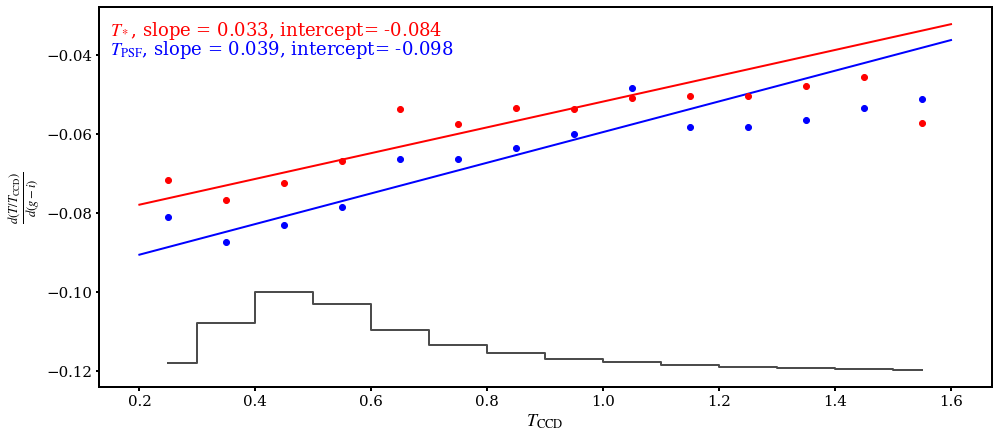

In [105]:
fig, ax = plt.subplots(1,1, figsize=(16,7))
cmap = plt.get_cmap('RdBu')

# set up catalogs for g-band
tmax = 1.6
cmax = 3.5
mask = (cat['BAND'] == 'g') & (cat['T_DATA'] < tmax)
bcat = cat[mask]
chist = bcat[color]
ccd_t_mskd = bcat['STAR_T_MEAN']
starsize = bcat['T_DATA']/ccd_t_mskd
psfsize = bcat['T_MODEL']/ccd_t_mskd
ccd_t_hist = ccd_t_mskd[(ccd_t_mskd > 0.2) & (ccd_t_mskd < tmax)]
hist, bin_edges = np.histogram((ccd_t_hist), bins=14)
print(hist, bin_edges)

# set up T_CCD slices
lims = np.linspace(0.2, 1.6, 15)
lim_centers = (lims[:-1] + lims[1:]) / 2.
tlist = [('T_DATA', r'$T_*$'), ('T_MODEL', r'$T_{\rm PSF}$')]
cols = ['r', 'b']
for i, ttype in enumerate(tlist):
    pars_list = []
    errslist=[]
    for k in range(len(lims) - 1):
        trange = (lims[k], lims[k+1])
        slicemask = (bcat['STAR_T_MEAN'] > trange[0]) & (bcat['STAR_T_MEAN'] < trange[1])
        cslice = bcat[slicemask][color]
        # ccd_t_slice =  bcat[slicemask]['STAR_T_MEAN']
        tslice = bcat[slicemask][ttype[0]]/bcat[slicemask]['STAR_T_MEAN']
        
        cbins, Tbins, Tbins_err = make_profile(cslice, tslice, xmax=cmax)
        nz_mask = np.nonzero(Tbins_err)[0]
        # print(nz_mask, type(Tbins))
        # print(cbins, Tbins, Tbins_err)
        mcbins = cbins[nz_mask]
        mTbins = Tbins[nz_mask]
        mTbins_err = Tbins_err[nz_mask]
        print(mcbins, mTbins, mTbins_err)
        
        # p = np.polyfit(mcbins, mTbins, 1)
        p, cov = np.polyfit(mcbins, mTbins, 1, w=1/mTbins_err, cov=True)
        # print(cov)
        errslist.append(cov[0,0])
        pars_list.append(p)
    pars_arr = np.asarray(pars_list)
    errs_arr = np.asarray(errslist)
    # print(pars_arr)
    # print(errs_arr)
    # ps = np.polyfit(lim_centers, pars_arr[:,0], 1)
    ps, covs = np.polyfit(lim_centers, pars_arr[:,0], 1, w=np.sqrt(hist), cov=True)
    # print(ttype[0], ps)
    print(ttype[0], ps, covs)
    col = cols[i]
    # ax.scatter(lim_centers, pars_arr[:,0], color=col)
    ax.errorbar(lim_centers, pars_arr[:,0], yerr=errs_arr, fmt='o', color=col, label=ttype[1])
    x = np.asarray([lims[0], lims[-1]])
    ax.plot(x, ps[0]*x + ps[1], color=col)
    ax.text(0.15, (i*-0.005)-0.035, '%s, slope = %.3f, intercept= %.3f'%(ttype[1], ps[0], ps[1]), color=col)

bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2.
scaled_hist = (hist / (50 * max(hist))) - 0.12
ax.step(bin_centers, scaled_hist, alpha=0.7, color='k', where='mid')
ax.set_xlabel(r'$T_{\rm CCD}$')
ax.set_ylabel(r'$\frac{d(T/T_{\rm CCD})}{d(g-i)}$')
# ax.legend()

In [ ]:
# plot size vs. color 2d hist and profile
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    ax = axs[i][0]
    #plot size vs color 2d hist with log density
    if band == 'z':
        color = 'IZ_COLOR'
        gcolor = 0.34
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
        gcolor = 1.1
    # cat = cat[cat['T_DATA'] < 2.5]
    tmax = 1.6
    mask = (cat['BAND'] == band) & (cat['T_DATA'] < tmax)
    bandcat = cat[mask]
    chist = cat[color][mask]
    size = cat['T_DATA'][mask]
    cmap = plt.get_cmap('BuPu')
    im = ax.hexbin(chist, size, bins='log', mincnt=1, cmap=cmap)
    ax.set_ylim(0., tmax)
    ax.set_ylabel(r'{} band: T [arcsec$^2$]'.format(band))
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('# stars')
    
    #plot size vs color profile
    ax = axs[i][1]
    batch = np.linspace(0,1.6,)
    cbins, Tbins, Tbins_err = make_profile(chist, size, xmax=cmax)
    cbins2, Tpsfbins, Tpsfbins_err = make_profile(chist, cat['T_MODEL'][mask], xmax=cmax)
    stars_galcolor = bandcat['T_MODEL'][(bandcat[color] > gcolor - 0.01) & (bandcat[color] < gcolor + 0.01)]
    print(len(stars_galcolor), np.mean(stars_galcolor), np.median(stars_galcolor), np.std(stars_galcolor))
    # color+r'/%s$_{\rm gal, default}$'%color
    plot_profile(cbins, Tbins/np.mean(stars_galcolor), np.sqrt(np.power(Tbins_err,2) + np.var(stars_galcolor)), ax, ymin=0.5, ymax=1.5, xlabel=color,
                 ylabel=r'$\left<T\right>/T_{\rm PSF, gal color} \quad[{\rm arcsec}^2]$', proflabel=r'$T_{\rm *}$', profcolor='b')
    plot_profile(cbins, Tpsfbins/np.mean(stars_galcolor), np.sqrt(np.power(Tpsfbins_err,2) + np.var(stars_galcolor)), ax, ymin=0.5, ymax=1.5, xlabel=color,
                 ylabel=r'$\left<T\right>/T_{\rm PSF, gal color} \quad[{\rm arcsec}^2]$', proflabel=r'$T_{\rm PSF}$', profcolor='r')
    
#     chist = cat[color][mask]
#     size = cat['T_DATA'][mask]
#     cmap = plt.get_cmap('BuPu')
#     im = ax.hexbin(chist, size, bins='log', mincnt=1, cmap=cmap)
#     ax.set_ylim(0., tmax)
#     ax.set_ylabel(r'{} band: T [arcsec$^2$]'.format(band))
#     ax.set_xlabel(color)
#     cbar = plt.colorbar(im, ax=ax)
#     cbar.set_label('# stars')
    
#     #plot size vs color profile
#     ax = axs[i][1]
#     cbins, Tbins, Tbins_err = make_profile(chist, size, xmax=cmax)
#     cbins2, Tpsfbins, Tpsfbins_err = make_profile(chist, cat['T_MODEL'][mask], xmax=cmax)
#     stars_galcolor = bandcat['T_MODEL'][(bandcat[color] > gcolor - 0.01) & (bandcat[color] < gcolor + 0.01)]
#     print(len(stars_galcolor), np.mean(stars_galcolor), np.median(stars_galcolor), np.std(stars_galcolor))
#     # color+r'/%s$_{\rm gal, default}$'%color
#     plot_profile(cbins, Tbins/np.mean(stars_galcolor), np.sqrt(np.power(Tbins_err,2) + np.var(stars_galcolor)), ax, ymin=0.5, ymax=1.5, xlabel=color,
#                  ylabel=r'$\left<T\right>/T_{\rm PSF, gal color} \quad[{\rm arcsec}^2]$', proflabel=r'$T_{\rm *}$', profcolor='b')
#     plot_profile(cbins, Tpsfbins/np.mean(stars_galcolor), np.sqrt(np.power(Tpsfbins_err,2) + np.var(stars_galcolor)), ax, ymin=0.5, ymax=1.5, xlabel=color,
#                  ylabel=r'$\left<T\right>/T_{\rm PSF, gal color} \quad[{\rm arcsec}^2]$', proflabel=r'$T_{\rm PSF}$', profcolor='r')

In [21]:
np.linspace(0,1.6, 9)

array([0. , 0.2, 0.4, 0.6, 0.8, 1. , 1.2, 1.4, 1.6])

/tmp/ipykernel_30796/2879616139.py:10: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(xdat, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
/tmp/ipykernel_30796/2879616139.py:28: MatplotlibDeprecationWarning: Passing parameters norm and vmin/vmax simultaneously is deprecated since 3.3 and will become an error two minor releases later. Please pass vmin/vmax directly to the norm when creating it.
  im = ax.hexbin(xdat, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)


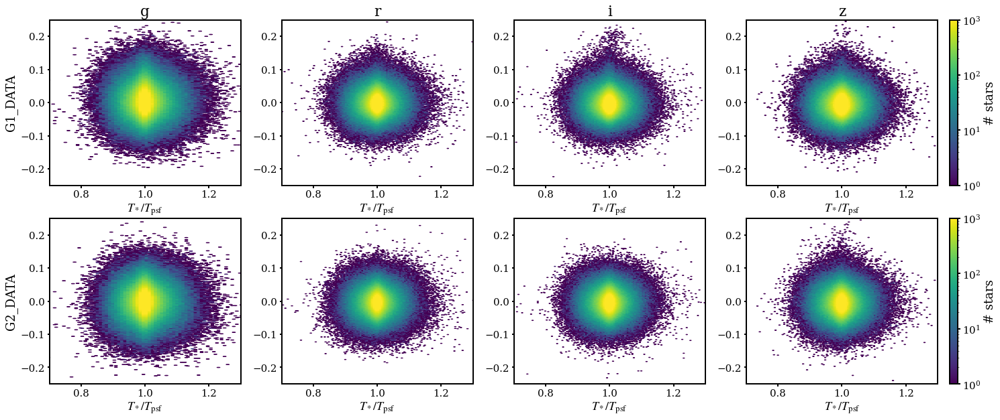

In [25]:
fig, axs = plt.subplots(2,4, figsize=(25,10), gridspec_kw={'width_ratios': [1,1,1,1.25]})
# shape residuals vs. SNR
for i, band in enumerate(bands):
    ccat = cat[cat['BAND'] == band]
    
    ax = axs[0,i]
    datlabel = 'G1_DATA'
    xdat = ccat['T_DATA']/ccat['T_MODEL']
    dat = ccat[datlabel]
    im = ax.hexbin(xdat, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
    ax.set_title(band)
    ax.set_xlim((0.7, 1.3))
    ax.set_ylim((-0.25,0.25))
    ax.set_xlabel(r'$T_*/T_{\rm psf}$')
    if band == 'g':
        ax.set_ylabel(datlabel)
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label('# stars')

    ax = axs[1,i]
    datlabel = 'G2_DATA'
    if band == 'z':
        color = 'IZ_COLOR'
    else:
        color = 'GI_COLOR'
    dat = ccat[datlabel]
    im = ax.hexbin(xdat, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
    # ax.set_xlabel('SNR')
    ax.set_xlim((0.7, 1.3))
    ax.set_ylim((-0.25, 0.25))
    ax.set_xlabel(r'$T_*/T_{\rm psf}$')
    if band == 'g':
        ax.set_ylabel(datlabel)
    if band == 'z':
        cbar = plt.colorbar(im, ax=ax)
        cbar.set_label('# stars')

#     ax = axs[2,i]
#     emax = 0.2
#     mask = (np.abs(ccat['G2_DATA']) < emax)
#     snr = ccat['SNR'][mask]
#     dat = ccat['G2_DATA'][mask]
#     im = ax.hexbin(snr, dat, bins='log', mincnt=1, gridsize=500, vmax=1000)
#     ax.set_xlabel('SNR')
#     ax.set_ylim(-emax, emax)
#     if band == 'g':
#         ax.set_ylabel('e2')
#     if band == 'z':
#         cbar = plt.colorbar(im, ax=ax)
#         cbar.set_label('# stars')


# HSM v ngmix

In [ ]:
from astropy.coordinates import SkyCoord
from astropy import units as u

In [ ]:
ngcat = fitsio.read('/global/homes/s/schutt20/gband_proj/catalogs/piff_v4_griz_ngmix_nocuts_allres.fits')
ngcat = ngcat[ngcat['BAND'] != 'Y']

In [ ]:
hsm = cat
hsmra = hsm['RA']
hsmra[hsmra > 180.] -= 360.
hsmdec = hsm['DEC']

In [ ]:
ngra = ngcat['RA']
ngra[ngra > 180.] -= 360.
ngdec = ngcat['DEC']

In [ ]:
hsmcoord = SkyCoord(hsmra*u.degree, hsmdec*u.degree)
ngcoord = SkyCoord(ngra*u.degree, ngdec*u.degree)

In [ ]:
print(len(hsmcoord), len(ngcoord), len(ngcoord)-len(hsmcoord))

In [ ]:
idx, d2d, d3d = hsmcoord.match_to_catalog_sky(ngcoord, nthneighbor=1)

In [ ]:
print(len(idx), len(d2d))

In [ ]:
mask = d2d < 0.1*u.arcsec
print(len(d2d[mask]) - len(hsmcoord))

In [ ]:
ngmatch = ngcat[idx]

In [ ]:
def compute_cat_res(hsm, ngmix):
    dT_data = hsm['T_DATA'] - ngmix['STAR_T']
    dT_model = hsm['T_MODEL'] - ngmix['MODEL_T']
    dT_res = (hsm['T_DATA'] - hsm['T_MODEL']) - (ngmix['STAR_T'] - ngmix['MODEL_T'])
    de1_data = hsm['G1_DATA'] - ngmix['STAR_E1']
    de1_model = hsm['G1_MODEL'] - ngmix['MODEL_E1']
    de1_res = (hsm['G1_DATA'] - hsm['G1_MODEL']) - (ngmix['STAR_E1'] - ngmix['MODEL_E1'])
    de2_data = hsm['G2_DATA'] - ngmix['STAR_E2']
    de2_model = hsm['G2_MODEL'] - ngmix['MODEL_E2']
    de2_res = (hsm['G2_DATA'] - hsm['G2_MODEL']) - (ngmix['STAR_E2'] - ngmix['MODEL_E2'])
    return (dT_data, dT_model, dT_res, de1_data, de1_model, de1_res, de2_data, de2_model, de2_res)

In [ ]:
def calc_mag(flux, zeropt=31.):
    return zeropt - 2.5*np.log10(flux)

In [ ]:
(dT_data, dT_model, dT_res, de1_data, de1_model, de1_res, de2_data, de2_model, de2_res) = compute_cat_res(hsm, ngmatch)

In [ ]:
dT_data

In [ ]:
hsmmag = calc_mag(hsm['FLUX'])
ngmag = calc_mag(ngmatch['FLUX'])
dmag = hsmmag - ngmag

In [ ]:
dcolor = np.ndarray((0,))
for band in 'griz':
    if band == 'z':
        color = 'IZ_COLOR'
    else:
        color = 'GI_COLOR'
    hsmdata = hsm[hsm['BAND'] == band]
    ngdata = ngmatch[ngmatch['BAND'] == band]
    dbandcolor = hsmdata[color] - ngdata[color]
    dcolor = np.concatenate((dcolor, dbandcolor), axis=0)
dcolor

In [ ]:
len(dcolor)

In [ ]:
print(hsm['BAND'] == 'g')
for band in 'griz':
    print(np.array_equal(hsm['BAND'] == band, ngmatch['BAND'] == band))

In [ ]:
##plot T_hsm vs T_ngmix correlation
fig, axs = plt.subplots(2,2, figsize=(20,18))
for i, band in enumerate('griz'):
    # <T> vs (color, mag)
    ax = axs[int(i/2)][i%2]
    # if band == 'z':
    #     color = 'IZ_COLOR'
    #     cmax = 0.7
    # else:
    #     color = 'GI_COLOR'
    #     cmax = 3.5
    hdata = hsm[hsm['BAND'] == band]
    hsize = hdata['T_DATA']
    ndata = ngmatch[ngmatch['BAND'] == band]
    nsize = ndata['STAR_T']
    print('HSM: ', min(hsize), max(hsize))
    print('ngmix: ', min(nsize), max(nsize))
    print(len(nsize) -len(nsize[nsize < 2.5])) 
    
    cmap = plt.get_cmap('jet')
    im = ax.hexbin(hsize, nsize, mincnt=1, bins='log', cmap=cmap, extent=(0, 2.5, 0, 2.5),
                   vmin=1., vmax=1e5)
    ax.plot(np.linspace(0,2.5,2),np.linspace(0,2.5,2), c='k', alpha=0.3)
    ax.set_aspect('equal')
    ax.set_xlim(0, 2.5)
    ax.set_ylim(0, 2.5)
    ax.set_ylabel(r'$T_{\rm ngmix}$')
    ax.set_xlabel(r'$T_{\rm HSM}$')
    cbar = plt.colorbar(im, ax=ax)
    #cbar.set_label(r'$\left<T_{\mathrm{PSF}}\right>$')


In [ ]:
##plot T_hsm vs T_ngmix correlation
fig, axs = plt.subplots(2,2, figsize=(20,18))
for i, band in enumerate('griz'):
    # <T> vs (color, mag)
    ax = axs[int(i/2)][i%2]
    # if band == 'z':
    #     color = 'IZ_COLOR'
    #     cmax = 0.7
    # else:
    #     color = 'GI_COLOR'
    #     cmax = 3.5
    hdata = hsm[hsm['BAND'] == band]
    hsize = hdata['T_MODEL']
    ndata = ngmatch[ngmatch['BAND'] == band]
    nsize = ndata['MODEL_T']
    print('HSM: ', min(hsize), max(hsize))
    print('ngmix: ', min(nsize), max(nsize))
    print(len(nsize) -len(nsize[nsize < 2.5])) 
    
    cmap = plt.get_cmap('jet')
    im = ax.hexbin(hsize, nsize, mincnt=1, bins='log', cmap=cmap, extent=(0, 2.5, 0, 2.5),
                   vmin=1., vmax=1e5)
    ax.plot(np.linspace(0,2.5,2),np.linspace(0,2.5,2), c='k', alpha=0.3)
    ax.set_aspect('equal')
    ax.set_xlim(0, 2.5)
    ax.set_ylim(0, 2.5)
    ax.set_ylabel(r'Model $T_{\rm ngmix}$')
    ax.set_xlabel(r'Model $T_{\rm HSM}$')
    cbar = plt.colorbar(im, ax=ax)
    #cbar.set_label(r'$\left<T_{\mathrm{PSF}}\right>$')


In [ ]:
##plot T_hsm vs T_ngmix correlation
fig, axs = plt.subplots(2,2, figsize=(20,18))
for i, band in enumerate('griz'):
    # <T> vs (color, mag)
    ax = axs[int(i/2)][i%2]
    # if band == 'z':
    #     color = 'IZ_COLOR'
    #     cmax = 0.7
    # else:
    #     color = 'GI_COLOR'
    #     cmax = 3.5
    hdata = hsm[hsm['BAND'] == band]
    hsize = hdata['G1_DATA']
    ndata = ngmatch[ngmatch['BAND'] == band]
    nsize = ndata['STAR_E1']
    print('HSM: ', min(hsize), max(hsize))
    print('ngmix: ', min(nsize), max(nsize))
    
    cmap = plt.get_cmap('jet')
    im = ax.hexbin(hsize, nsize, mincnt=1, norm=mpl.colors.LogNorm(1., 1e5), cmap=cmap, extent=(-1, 1, -1, 1))
    ax.plot(np.linspace(-1,1,2),np.linspace(-1,1,2), c='k', alpha=0.3)
    ax.set_aspect('equal')
    ax.set_xlim(-1, 1)
    ax.set_ylim(-1, 1)
    ax.set_ylabel(r'$e1_{\rm ngmix}$')
    ax.set_xlabel(r'$e1_{\rm HSM}$')
    cbar = plt.colorbar(im, ax=ax)
    #cbar.set_label(r'$\left<T_{\mathrm{PSF}}\right>$')


In [ ]:
##plot T_hsm vs T_ngmix correlation
fig, axs = plt.subplots(2,2, figsize=(20,18))
for i, band in enumerate('griz'):
    # <T> vs (color, mag)
    ax = axs[int(i/2)][i%2]
    # if band == 'z':
    #     color = 'IZ_COLOR'
    #     cmax = 0.7
    # else:
    #     color = 'GI_COLOR'
    #     cmax = 3.5
    hdata = hsm[hsm['BAND'] == band]
    hsize = hdata['G1_MODEL']
    ndata = ngmatch[ngmatch['BAND'] == band]
    nsize = ndata['MODEL_E1']
    print('HSM: ', min(hsize), max(hsize))
    print('ngmix: ', min(nsize), max(nsize))
    
    cmap = plt.get_cmap('jet')
    im = ax.hexbin(hsize, nsize, mincnt=1, norm=mpl.colors.LogNorm(1., 1e5), cmap=cmap, extent=(-1, 1, -1, 1))
    ax.plot(np.linspace(-1,1,2),np.linspace(-1,1,2), c='k', alpha=0.3)
    ax.set_aspect('equal')
    ax.set_xlim(-1, 1)
    ax.set_ylim(-1, 1)
    ax.set_ylabel(r'$e1_{\rm ngmix}$')
    ax.set_xlabel(r'$e1_{\rm HSM}$')
    cbar = plt.colorbar(im, ax=ax)
    #cbar.set_label(r'$\left<T_{\mathrm{PSF}}\right>$')


In [ ]:
##plot T_hsm vs T_ngmix correlation
fig, axs = plt.subplots(2,2, figsize=(20,18))
for i, band in enumerate('griz'):
    # <T> vs (color, mag)
    ax = axs[int(i/2)][i%2]
    # if band == 'z':
    #     color = 'IZ_COLOR'
    #     cmax = 0.7
    # else:
    #     color = 'GI_COLOR'
    #     cmax = 3.5
    hdata = hsm[hsm['BAND'] == band]
    hsize = hdata['G2_DATA']
    ndata = ngmatch[ngmatch['BAND'] == band]
    nsize = ndata['STAR_E2']
    print('HSM: ', min(hsize), max(hsize))
    print('ngmix: ', min(nsize), max(nsize))
    
    cmap = plt.get_cmap('jet')
    im = ax.hexbin(hsize, nsize, mincnt=1, norm=mpl.colors.LogNorm(1., 1e5), cmap=cmap, extent=(-1, 1, -1, 1))
    ax.plot(np.linspace(-1,1,2),np.linspace(-1,1,2), c='k', alpha=0.3)
    ax.set_aspect('equal')
    ax.set_xlim(-1, 1)
    ax.set_ylim(-1, 1)
    ax.set_ylabel(r'$e2_{\rm ngmix}$')
    ax.set_xlabel(r'$e2_{\rm HSM}$')
    cbar = plt.colorbar(im, ax=ax)
    #cbar.set_label(r'$\left<T_{\mathrm{PSF}}\right>$')


In [ ]:
##plot T_hsm vs T_ngmix correlation
fig, axs = plt.subplots(2,2, figsize=(20,18))
for i, band in enumerate('griz'):
    # <T> vs (color, mag)
    ax = axs[int(i/2)][i%2]
    # if band == 'z':
    #     color = 'IZ_COLOR'
    #     cmax = 0.7
    # else:
    #     color = 'GI_COLOR'
    #     cmax = 3.5
    hdata = hsm[hsm['BAND'] == band]
    hsize = hdata['G2_MODEL']
    ndata = ngmatch[ngmatch['BAND'] == band]
    nsize = ndata['MODEL_E2']
    print('HSM: ', min(hsize), max(hsize))
    print('ngmix: ', min(nsize), max(nsize))
    
    cmap = plt.get_cmap('jet')
    im = ax.hexbin(hsize, nsize, mincnt=1, norm=mpl.colors.LogNorm(1., 1e5), cmap=cmap, extent=(-1, 1, -1, 1))
    ax.plot(np.linspace(-1,1,2),np.linspace(-1,1,2), c='k', alpha=0.3)
    ax.set_aspect('equal')
    ax.set_xlim(-1, 1)
    ax.set_ylim(-1, 1)
    ax.set_ylabel(r'$e1_{\rm ngmix}$')
    ax.set_xlabel(r'$e1_{\rm HSM}$')
    cbar = plt.colorbar(im, ax=ax)
    #cbar.set_label(r'$\left<T_{\mathrm{PSF}}\right>$')


In [ ]:
##plot T_hsm vs T_ngmix correlation
fig, axs = plt.subplots(2,2, figsize=(20,18))
for i, band in enumerate('griz'):
    # <T> vs (color, mag)
    ax = axs[int(i/2)][i%2]
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
    hdata = hsm[hsm['BAND'] == band]
    hsize = hdata[color]
    ndata = ngmatch[ngmatch['BAND'] == band]
    nsize = ndata[color]
    print('HSM: ', min(hsize), max(hsize))
    print('ngmix: ', min(nsize), max(nsize))
    
    cmap = plt.get_cmap('jet')
    im = ax.hexbin(hsize, nsize, mincnt=1, norm=mpl.colors.LogNorm(1., 1e5), cmap=cmap, extent=(0, cmax, 0, cmax))
    ax.plot(np.linspace(0,cmax,2),np.linspace(0,cmax,2), c='k', alpha=0.3)
    ax.set_aspect('equal')
    ax.set_xlim(0, cmax)
    ax.set_ylim(0, cmax)
    ax.set_ylabel(r'%s$_{\rm ngmix}$'%color)
    ax.set_xlabel(r'%s$_{\rm HSM}$'%color)
    cbar = plt.colorbar(im, ax=ax)
    #cbar.set_label(r'$\left<T_{\mathrm{PSF}}\right>$')


In [ ]:
##plot T_hsm vs T_ngmix correlation
fig, axs = plt.subplots(2,2, figsize=(20,18))
for i, band in enumerate('griz'):
    # <T> vs (color, mag)
    ax = axs[int(i/2)][i%2]
    # if band == 'z':
    #     color = 'IZ_COLOR'
    #     cmax = 0.7
    # else:
    #     color = 'GI_COLOR'
    #     cmax = 3.5
    hdata = hsm[hsm['BAND'] == band]
    hsize = calc_mag(hdata['FLUX'])
    ndata = ngmatch[ngmatch['BAND'] == band]
    nsize = calc_mag(ndata['FLUX'])
    print('HSM: ', min(hsize), max(hsize))
    print('ngmix: ', min(nsize), max(nsize))
    mmin, mmax = 14., 30.
    cmap = plt.get_cmap('jet')
    im = ax.hexbin(hsize, nsize, mincnt=1, norm=mpl.colors.LogNorm(1., 1e5),
                   cmap=cmap, extent=(mmin, mmax, mmin, mmax))
    ax.plot(np.linspace(mmin, mmax,2),np.linspace(mmin, mmax,2), c='k', alpha=0.3)
    ax.set_aspect('equal')
    ax.set_xlim(mmin, mmax)
    ax.set_ylim(mmin, mmax)
    ax.set_ylabel(r'%s$_{\rm ngmix}$'%color)
    ax.set_xlabel(r'%s$_{\rm HSM}$'%color)
    cbar = plt.colorbar(im, ax=ax)
    #cbar.set_label(r'$\left<T_{\mathrm{PSF}}\right>$')


In [ ]:
cat_residuals = {}
bands = 'griz'
cols = ['dT_data', 'dT_model', 'dT_res',
        'de1_data', 'de1_model', 'de1_res',
        'de2_data', 'de2_model', 'de2_res']
for band in bands:
    hcat = hsm[hsm['BAND'] == band]
    ncat = ngmatch[ngmatch['BAND'] == band]
    shape_residuals = compute_cat_res(hcat, ncat)
    for col, val in zip(cols, shape_residuals):
        print(col, val)
        cat_residuals.update({band: {col: val}})

In [ ]:
cat_residuals['g']

In [ ]:
#plot color vs mag per band
fig, axs = plt.subplots(4,3, figsize=(16,24))
for i, band in enumerate(bands):

    # plot size histogram
    hcat = hsm[hsm['BAND'] == band]
    ncat = ngmatch[ngmatch['BAND'] == band]
    (dT_data, dT_model, dT_res, de1_data, de1_model,
     de1_res, de2_data, de2_model, de2_res) = compute_cat_res(hcat, ncat)

    ax = axs[i][0]
    lo, hi = -0.05, 0.05
    ax.hist(dT_data, bins=np.linspace(lo, hi, 50))
    ax.set_xlim(lo, hi)
    ax.set_xlabel(r'PSF $T_{\rm HSM} - T_{\rm ngmix}$ [arcsec^2]')
    ax.set_ylabel(band)
    
    ax = axs[i][1]
    ax.hist(dT_model, bins=np.linspace(lo, hi, 50))
    ax.set_xlim(lo, hi)
    ax.set_xlabel(r'Model $T_{\rm HSM} - T_{\rm ngmix}$ [arcsec^2]')
    # ax.set_ylabel(band)

    ax = axs[i][2]
    # lo, hi = -0.01, 0.01
    ax.hist(dT_res, bins=np.linspace(lo, hi, 50))
    ax.set_xlim(lo, hi)
    ax.set_xlabel(r'$dT_{\rm HSM} - dT_{\rm ngmix}$ [arcsec^2]')
    # ax.set_ylabel(band)    
    # #plot e1 and e2 histograms
    # ax = axs[i][1]
    # e1 = cat['G1_DATA'][cat['BAND'] == band]
    # e2 = cat['G2_DATA'][cat['BAND'] == band]
    # ax.hist(e1, bins=np.linspace(-0.3, 0.3, 50), histtype='step', label='e1', lw=2)
    # ax.hist(e2, bins=np.linspace(-0.3, 0.3, 50), histtype='step', label='e2', lw=2)
    # ax.set_xlim(-0.3, 0.3)
    # ax.legend()
    # ax.set_xlabel('Ellipticity')

In [ ]:
##plot <T>  and <dT> vs (color,mag) per band
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    # <T> vs (color, mag)
    ax = axs[i][0]
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
    hdata = hsm[hsm['BAND'] == band]
    ndata = ngmatch[ngmatch['BAND'] == band]
    hchist = hdata[color]
    nchist = ndata[color]
    hmag = calc_mag(hdata['FLUX'])
    ngmag = calc_mag(ngmatch['FLUX'])
    mmin = 14.
    mmax = 30.
    hsize = hdata['T_DATA']
    nsize = ndata['STAR_T']
    dT = hsize - nsize
    print(len(dT) - len(dT[dT > -2.5]))
    mask = dT > -2.5
    cmap = plt.get_cmap('jet')
    im = ax.hexbin(hchist[mask], dT[mask], bins='log', mincnt=1, cmap=cmap)
    ax.set_ylim(-2.5, 1.)
    ax.set_ylabel(r'$%s: T_{\rm HSM} - T_{\rm ngmix}$'%band)
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('# stars')
    
    #plot size vs color profile
    ax = axs[i][1]
    nbins = 7
    if band == 'z':
        cmax = 0.7
    else:
        cmax = 3.5
    cbins = np.linspace(0., cmax, nbins)
    bin_by_color(hchist, dT, ax, cmax=cmax, tmin=-0.025, tmax=0.0)
    # # <dT> vs (color, mag)
    # ax = axs[i][1]
    # dT = data['T_DATA'] - data['T_MODEL']
    # cmap = plt.get_cmap('seismic')
    # im = ax.hexbin(chist, mag, dT, mincnt=1, cmap=cmap, reduce_C_function=np.mean,
    #                vmin=-0.0012, vmax=0.0012)
    # ax.set_ylim(mmin, mmax)
    # ax.set_ylabel('{} mag'.format(band))
    # ax.set_xlabel(color)
    # cbar = plt.colorbar(im, ax=ax)
    # cbar.set_label(r'$\left<T_{\mathrm{PSF}} - T_{\mathrm{model}}\right>$')

In [ ]:
##plot <T>  and <dT> vs (color,mag) per band
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    # <T> vs (color, mag)
    ax = axs[i][0]
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
    hdata = hsm[hsm['BAND'] == band]
    ndata = ngmatch[ngmatch['BAND'] == band]
    hchist = hdata[color]
    nchist = ndata[color]
    hmag = calc_mag(hdata['FLUX'])
    ngmag = calc_mag(ngmatch['FLUX'])
    mmin = 14.
    mmax = 30.
    hsize = hdata['T_DATA']
    nsize = ndata['STAR_T']
    dT = hsize - nsize
    print(len(dT) - len(dT[dT > -2.5]))
    mask = dT > -2.5
    cmap = plt.get_cmap('jet')
    lo, hi = -0.05, 0.05
    im = ax.hexbin(hchist[mask], dT[mask], bins='log', mincnt=1, cmap=cmap,
                   extent=(0,cmax,lo,hi), vmin=1., vmax=1e4)
    ax.set_ylim(lo, hi)
    ax.set_ylabel(r'$%s: T_{\rm HSM} - T_{\rm ngmix}$'%band)
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label('# stars')
    
    #plot size vs color profile
    ax = axs[i][1]
    nbins = 7
    if band == 'z':
        cmax = 0.7
    else:
        cmax = 3.5
    cbins = np.linspace(0., cmax, nbins)
    bin_by_color(hchist, dT, ax, cmax=cmax, tmin=-0.025, tmax=0.0)
    # # <dT> vs (color, mag)
    # ax = axs[i][1]
    # dT = data['T_DATA'] - data['T_MODEL']
    # cmap = plt.get_cmap('seismic')
    # im = ax.hexbin(chist, mag, dT, mincnt=1, cmap=cmap, reduce_C_function=np.mean,
    #                vmin=-0.0012, vmax=0.0012)
    # ax.set_ylim(mmin, mmax)
    # ax.set_ylabel('{} mag'.format(band))
    # ax.set_xlabel(color)
    # cbar = plt.colorbar(im, ax=ax)
    # cbar.set_label(r'$\left<T_{\mathrm{PSF}} - T_{\mathrm{model}}\right>$')

In [ ]:
#plot size vs. color 2d hist and profile
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    ax = axs[i][0]
    #plot size vs mag 2d hist with log density
    hdata = hsm[hsm['BAND'] == band]
    ndata = ngmatch[ngmatch['BAND'] == band]
    hmag = calc_mag(hdata['FLUX'])
    nmag = calc_mag(ndata['FLUX'])
    mmin = 14.
    mmax = 30.
    hsize = hdata['T_DATA']
    nsize = ndata['STAR_T']
    dT = hsize - nsize
    print(len(dT) - len(dT[dT > -2.5]))
    mask = dT > -2.5
    cmap = plt.get_cmap('jet')
    lo, hi = -2.5, 1.
    im = ax.hexbin(hmag[mask], dT[mask], bins='log', mincnt=1, cmap=cmap, extent=(mmin, mmax, lo, hi))
    ax.set_ylim(lo, hi)
    ax.set_xlim(mmin, mmax)
    ax.set_ylabel(r'$%s: T_{\rm HSM} - T_{\rm ngmix}$'%band)
    ax.set_xlabel('HSM Magnitude')
    cbar = plt.colorbar(im, ax=ax)
    # cbar.set_label('# stars')
    
    #plot size vs color profile
    ax = axs[i][1]
    #plot size vs color 2d hist with log density
    im = ax.hexbin(nmag[mask], dT[mask], bins='log', mincnt=1, cmap=cmap, extent=(mmin, mmax, lo, hi))
    ax.set_ylim(lo, hi)
    ax.set_xlim(mmin, mmax)
    ax.set_ylabel(r'$%s: T_{\rm HSM} - T_{\rm ngmix}$'%band)
    ax.set_xlabel('ngmix Magnitude')
    cbar = plt.colorbar(im, ax=ax)
    # cbar.set_label('# stars')
#     m = mag
#     dT = size
#     mag_bins = np.linspace(mmin, mmax, 30)
#     print('col_bins = ',mag_bins)

#     index = np.digitize(mag, mag_bins)
#     bin_dT = [dT[index == i].mean() for i in range(1, len(mag_bins))]
#     print('bin_dT = ',bin_dT)
#     bin_dT_err = [ np.sqrt(dT[index == i].var() / len(dT[index == i]))
#                     for i in range(1, len(mag_bins)) ]
#     print('bin_dT_err = ',bin_dT_err)

#     # Fix up nans
#     for i in range(1,len(mag_bins)):
#         if i not in index:
#             bin_dT[i-1] = 0.
#             bin_dT_err[i-1] = 0.
    
#     ax.set_ylim(0., 1.2)
#     #ax.plot([cmin,cmax], [0,0], color='black')
#     #ax.plot([min_mused,min_mused],[-1,1], color='Grey')
#     #ax.fill( [min_mag,min_mag,min_mused,min_mused], [-1,1,1,-1], fill=True, color='Grey',alpha=0.3)
#     t_line = ax.errorbar(mag_bins[:-1], bin_dT, yerr=bin_dT_err, color='darkturquoise', fmt='o')
#     #ax.axhline(y=0.003, linewidth=4, color='grey')
#     #ax.legend([t_line], [r'$\delta T$'])
#     ax.set_ylabel(r'$\left<T_{data}\right> \quad({\rm arcsec}^2)$')
#     ax.set_xlabel('Magnitude')

In [ ]:
#plot size vs. color 2d hist and profile
fig, axs = plt.subplots(4,2, figsize=(16,24))
for i, band in enumerate(bands):
    ax = axs[i][0]
    #plot size vs mag 2d hist with log density
    hdata = hsm[hsm['BAND'] == band]
    ndata = ngmatch[ngmatch['BAND'] == band]
    hmag = calc_mag(hdata['FLUX'])
    nmag = calc_mag(ndata['FLUX'])
    mmin = 14.
    mmax = 30.
    hsize = hdata['T_DATA']
    nsize = ndata['STAR_T']
    dT = hsize - nsize
    print(len(dT) - len(dT[dT > -2.5]))
    mask = dT > -2.5
    cmap = plt.get_cmap('jet')
    lo, hi = -0.05, 0.05
    im = ax.hexbin(hmag[mask], dT[mask], bins='log', mincnt=1, cmap=cmap, extent=(mmin, mmax, lo, hi))
    ax.set_ylim(lo, hi)
    ax.set_xlim(mmin, mmax)
    ax.set_ylabel(r'$%s: T_{\rm HSM} - T_{\rm ngmix}$'%band)
    ax.set_xlabel('HSM Magnitude')
    cbar = plt.colorbar(im, ax=ax)
    # cbar.set_label('# stars')
    
    #plot size vs color profile
    ax = axs[i][1]
    #plot size vs color 2d hist with log density
    im = ax.hexbin(nmag[mask], dT[mask], bins='log', mincnt=1, cmap=cmap, extent=(mmin, mmax, lo, hi))
    ax.set_ylim(lo, hi)
    ax.set_xlim(mmin, mmax)
    ax.set_ylabel(r'$%s: T_{\rm HSM} - T_{\rm ngmix}$'%band)
    ax.set_xlabel('ngmix Magnitude')
    cbar = plt.colorbar(im, ax=ax)
    # cbar.set_label('# stars')
#     m = mag
#     dT = size
#     mag_bins = np.linspace(mmin, mmax, 30)
#     print('col_bins = ',mag_bins)

#     index = np.digitize(mag, mag_bins)
#     bin_dT = [dT[index == i].mean() for i in range(1, len(mag_bins))]
#     print('bin_dT = ',bin_dT)
#     bin_dT_err = [ np.sqrt(dT[index == i].var() / len(dT[index == i]))
#                     for i in range(1, len(mag_bins)) ]
#     print('bin_dT_err = ',bin_dT_err)

#     # Fix up nans
#     for i in range(1,len(mag_bins)):
#         if i not in index:
#             bin_dT[i-1] = 0.
#             bin_dT_err[i-1] = 0.
    
#     ax.set_ylim(0., 1.2)
#     #ax.plot([cmin,cmax], [0,0], color='black')
#     #ax.plot([min_mused,min_mused],[-1,1], color='Grey')
#     #ax.fill( [min_mag,min_mag,min_mused,min_mused], [-1,1,1,-1], fill=True, color='Grey',alpha=0.3)
#     t_line = ax.errorbar(mag_bins[:-1], bin_dT, yerr=bin_dT_err, color='darkturquoise', fmt='o')
#     #ax.axhline(y=0.003, linewidth=4, color='grey')
#     #ax.legend([t_line], [r'$\delta T$'])
#     ax.set_ylabel(r'$\left<T_{data}\right> \quad({\rm arcsec}^2)$')
#     ax.set_xlabel('Magnitude')

In [ ]:
##plot <T>  and <dT> vs (color,mag) per band
fig, axs = plt.subplots(4,2, figsize=(18,24))
for i, band in enumerate(bands):
    # <T> vs (color, mag)
    ax = axs[i][0]
    if band == 'z':
        color = 'IZ_COLOR'
        cmax = 0.7
    else:
        color = 'GI_COLOR'
        cmax = 3.5
    hdata = hsm[hsm['BAND'] == band]
    ndata = ngmatch[ngmatch['BAND'] == band]
    hchist = hdata[color]
    nchist = ndata[color]
    hmag = calc_mag(hdata['FLUX'])
    nmag = calc_mag(ndata['FLUX'])
    mmin = 14.
    mmax = 30.
    hsize = hdata['T_DATA']
    nsize = ndata['STAR_T']
    dT = hsize - nsize
    print(len(dT) - len(dT[dT > -2.5]))
    mask = dT > -2.5
    cmap = plt.get_cmap('seismic')
    lo, hi = -0.005, 0.005
    im = ax.hexbin(hchist[mask], hmag[mask], dT[mask], mincnt=1, cmap=cmap, reduce_C_function=np.mean,
                   vmin=lo, vmax=hi, extent=(0, cmax, mmin, mmax))
    ax.set_ylim(mmin, mmax)
    ax.set_ylabel('HSM mag')
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label(r'$\left<T_{\rm HSM} - T_{\rm ngmix}\right>$')

    # <dT> vs (color, mag)
    ax = axs[i][1]
    im = ax.hexbin(hchist[mask], nmag[mask], dT[mask], mincnt=1, cmap=cmap, reduce_C_function=np.mean,
                   vmin=lo, vmax=hi, extent=(0, cmax, mmin, mmax))
    ax.set_ylim(mmin, mmax)
    ax.set_ylabel('ngmix mag')
    ax.set_xlabel(color)
    cbar = plt.colorbar(im, ax=ax)
    cbar.set_label(r'$\left<T_{\rm HSM} - T_{\rm ngmix}\right>$')

#### Clean up and analyze non-matches

In [ ]:
mask = np.ones(len(ng), dtype=bool)
mask[idx] = False
ngnomatch = ng[mask]

In [ ]:
i, c = np.unique(idx, return_counts=1)

In [ ]:
np.unique(c, return_counts=1)

In [ ]:
np.unique(ngnomatch, return_counts=1)

#### 3529 HSM sources get matched to duplicate ngmix sources
##### Will try band-by-band matching

In [ ]:
ngnomatch = []
for band in 'griz':
    hsm = cat[cat['BAND'] == band]
    ng = nocat[nocat['BAND'] == band]
    
    hsmra = hsm['RA']
    hsmra[hsmra > 180.] -= 360.
    hsmdec = hsm['DEC']
    ngra = ng['RA']
    ngra[ngra > 180.] -= 360.
    ngdec = ng['DEC']
    
    hsmcoord = SkyCoord(hsmra*u.degree, hsmdec*u.degree)
    ngcoord = SkyCoord(ngra*u.degree, ngdec*u.degree)
    
    bidx, bd2d, bd3d = hsmcoord.match_to_catalog_sky(ngcoord, nthneighbor=1)
    print(len(hsm), len(ng), len(hsm) - len(ng), len(ng[bidx]), len(np.delete(ng,bidx, axis=0)))
    ngnomatch.append(np.delete(ng, bidx, axis=0))

In [ ]:
ngnomatcharr = np.concatenate(ngnomatch, axis=0)

In [ ]:
len(ngnomatcharr)

In [ ]:
ngnomatcharr

In [ ]:
ng

In [ ]:
a1 = np.array([1, 2, 3, 4])